# Define a function to draw bounding boxes on an image

In [1]:
import numpy as np
import cv2

# Define a function that takes an image, a list of bounding boxes, 
# and optional color tuple and line thickness as inputs
# then draws boxes in that color on the output

def draw_boxes(img, bboxes, color=(0, 0, 255), thick=6):
    # make a copy of the image
    draw_img = np.copy(img)
    # draw each bounding box on your image copy using cv2.rectangle()
    for box in bboxes:
        cv2.rectangle(draw_img, box[0], box[1], color, thick)
    # return the image copy with boxes drawn
    return draw_img 

# Draw a given boxes on an image

In [2]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

#Read an image
image = mpimg.imread('bbox-example-image.jpg')

# Add bounding boxes in this format, these are just example coordinates.
bboxes = [((275, 572), (380, 510)), ((488, 563), (549, 518)), ((554, 543), (582, 522)), 
          ((601, 555), (646, 522)), ((657, 545), (685, 517)), ((849, 678), (1135, 512))]

bbox_image = draw_boxes(image, bboxes)

fig = plt.figure()
plt.subplot(121)
plt.imshow(image)
plt.title('Original Image')
plt.subplot(122)
plt.imshow(bbox_image)
plt.title('bbox Image')
fig.tight_layout()

# Define a function to return HOG features and visualization

In [3]:
from skimage.feature import hog

# Define a function to return HOG features and visualization
def get_hog_features(img, orient, pix_per_cell, cell_per_block, 
                        vis=False, feature_vec=True):
    # Call with two outputs if vis==True
    if vis == True:
        features, hog_image = hog(img, orientations=orient, 
                                  pixels_per_cell=(pix_per_cell, pix_per_cell),
                                  block_norm= 'L2-Hys',
                                  cells_per_block=(cell_per_block, cell_per_block), 
                                  transform_sqrt=True, 
                                  visualize=vis, feature_vector=feature_vec)
        return features, hog_image
    # Otherwise call with one output
    else:      
        features = hog(img, orientations=orient, 
                       pixels_per_cell=(pix_per_cell, pix_per_cell),
                       cells_per_block=(cell_per_block, cell_per_block), 
                       block_norm= 'L2-Hys',
                       transform_sqrt=True, 
                       visualize=vis, feature_vector=feature_vec)
        return features

# Define a function to compute binned color features 

In [4]:
# Define a function to compute binned color features  
def bin_spatial(img, size=(32, 32)):
    # Use cv2.resize().ravel() to create the feature vector
    features = cv2.resize(img, size).ravel() 
    # Return the feature vector
    return features

# Define a function to compute color histogram features 

In [5]:
# Define a function to compute color histogram features 
# NEED TO CHANGE bins_range if reading .png files with mpimg!
def color_hist(img, nbins=32, bins_range=(0, 256)):
    # Compute the histogram of the color channels separately
    channel1_hist = np.histogram(img[:,:,0], bins=nbins, range=bins_range)
    channel2_hist = np.histogram(img[:,:,1], bins=nbins, range=bins_range)
    channel3_hist = np.histogram(img[:,:,2], bins=nbins, range=bins_range)
    # Concatenate the histograms into a single feature vector
    hist_features = np.concatenate((channel1_hist[0], channel2_hist[0], channel3_hist[0]))
    # Return the individual histograms, bin_centers and feature vector
    return hist_features

# Define a function to extract features from a list of images

In [6]:
# Define a function to extract features from a list of images
# Have this function call bin_spatial() and color_hist()
def extract_features(imgs, color_space='RGB', spatial_size=(32, 32),
                        hist_bins=32, orient=9, 
                        pix_per_cell=8, cell_per_block=2, hog_channel=0,
                        spatial_feat=True, hist_feat=True, hog_feat=True):
    # Create a list to append feature vectors to
    features = []
    # Iterate through the list of images
    for file in imgs:
        file_features = []
        # Read in each one by one
        image = mpimg.imread(file)
        
        # apply color conversion if other than 'RGB'
        if color_space != 'RGB':
            if color_space == 'HSV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
            elif color_space == 'LUV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
            elif color_space == 'HLS':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
            elif color_space == 'YUV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)
            elif color_space == 'YCrCb':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)
        else: feature_image = np.copy(image)      

        if spatial_feat == True:
            spatial_features = bin_spatial(feature_image, size=spatial_size)
            file_features.append(spatial_features)
        if hist_feat == True:
            # Apply color_hist()
            hist_features = color_hist(feature_image, nbins=hist_bins)
            file_features.append(hist_features)
        if hog_feat == True:
        # Call get_hog_features() with vis=False, feature_vec=True
            if hog_channel == 'ALL':
                hog_features = []
                for channel in range(feature_image.shape[2]):
                    hog_features.append(get_hog_features(feature_image[:,:,channel], 
                                        orient, pix_per_cell, cell_per_block, 
                                        vis=False, feature_vec=True))
                hog_features = np.ravel(hog_features)        
            else:
                hog_features = get_hog_features(feature_image[:,:,hog_channel], orient, 
                            pix_per_cell, cell_per_block, vis=False, feature_vec=True)
            # Append the new feature vector to the features list
            file_features.append(hog_features)
        features.append(np.concatenate(file_features))
    # Return list of feature vectors
    return features

# Define a function to extract features from a single image window

In [7]:
# Define a function to extract features from a single image window
# This function is very similar to extract_features()
# just for a single image rather than list of images
def single_img_features(img, color_space='RGB', spatial_size=(32, 32),
                        hist_bins=32, orient=9, 
                        pix_per_cell=8, cell_per_block=2, hog_channel=0,
                        spatial_feat=True, hist_feat=True, hog_feat=True):    
    #1) Define an empty list to receive features
    img_features = []
    #2) Apply color conversion if other than 'RGB'
    if color_space != 'RGB':
        if color_space == 'HSV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
        elif color_space == 'LUV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
        elif color_space == 'HLS':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
        elif color_space == 'YUV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2YUV)
        elif color_space == 'YCrCb':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)
    else: feature_image = np.copy(img)      
    #3) Compute spatial features if flag is set
    if spatial_feat == True:
        spatial_features = bin_spatial(feature_image, size=spatial_size)
        #4) Append features to list
        img_features.append(spatial_features)
    #5) Compute histogram features if flag is set
    if hist_feat == True:
        hist_features = color_hist(feature_image, nbins=hist_bins)
        #6) Append features to list
        img_features.append(hist_features)
    #7) Compute HOG features if flag is set
    if hog_feat == True:
        if hog_channel == 'ALL':
            hog_features = []
            for channel in range(feature_image.shape[2]):
                hog_features.extend(get_hog_features(feature_image[:,:,channel], 
                                    orient, pix_per_cell, cell_per_block, 
                                    vis=False, feature_vec=True))      
        else:
            hog_features = get_hog_features(feature_image[:,:,hog_channel], orient, 
                        pix_per_cell, cell_per_block, vis=False, feature_vec=True)
        #8) Append features to list
        img_features.append(hog_features)

    #9) Return concatenated array of features
    return np.concatenate(img_features)

# Define a function to return the windows(boxes) that contains cars

In [8]:
# Define a function you will pass an image 
# and the list of windows to be searched (output of slide_windows())
def search_windows(img, windows, clf, scaler, color_space='RGB', 
                    spatial_size=(32, 32), hist_bins=32, 
                    hist_range=(0, 256), orient=9, 
                    pix_per_cell=8, cell_per_block=2, 
                    hog_channel=0, spatial_feat=True, 
                    hist_feat=True, hog_feat=True):

    #1) Create an empty list to receive positive detection windows
    on_windows = []
    #2) Iterate over all windows in the list
    for window in windows:
        #3) Extract the test window from original image
        test_img = cv2.resize(img[window[0][1]:window[1][1], window[0][0]:window[1][0]], (64, 64))      
        #4) Extract features for that window using single_img_features()
        features = single_img_features(test_img, color_space=color_space, 
                            spatial_size=spatial_size, hist_bins=hist_bins, 
                            orient=orient, pix_per_cell=pix_per_cell, 
                            cell_per_block=cell_per_block, 
                            hog_channel=hog_channel, spatial_feat=spatial_feat, 
                            hist_feat=hist_feat, hog_feat=hog_feat)
        #5) Scale extracted features to be fed to classifier
        test_features = scaler.transform(np.array(features).reshape(1, -1))
        #6) Predict using your classifier
        prediction = clf.predict(test_features)
        #7) If positive (prediction == 1) then save the window
        if prediction == 1:
            on_windows.append(window)
    #8) Return windows for positive detections
    return on_windows

# Define a function to return list of sliding windows

In [9]:
# Define a function that takes an image,
# start and stop positions in both x and y, 
# window size (x and y dimensions),  
# and overlap fraction (for both x and y)
def slide_window(img, x_start_stop=[None, None], y_start_stop=[None, None], 
                    xy_window=(64, 64), xy_overlap=(0.5, 0.5)):
    # If x and/or y start/stop positions not defined, set to image size
    if x_start_stop[0] == None:
        x_start_stop[0] = 0
    if x_start_stop[1] == None:
        x_start_stop[1] = img.shape[1]
    if y_start_stop[0] == None:
        y_start_stop[0] = 0
    if y_start_stop[1] == None:
        y_start_stop[1] = img.shape[0]
    # Compute the span of the region to be searched    
    xspan = x_start_stop[1] - x_start_stop[0]
    yspan = y_start_stop[1] - y_start_stop[0]
    # Compute the number of pixels per step in x/y
    nx_pix_per_step = np.int(xy_window[0]*(1 - xy_overlap[0]))
    ny_pix_per_step = np.int(xy_window[1]*(1 - xy_overlap[1]))
    # Compute the number of windows in x/y
    nx_buffer = np.int(xy_window[0]*(xy_overlap[0]))
    ny_buffer = np.int(xy_window[1]*(xy_overlap[1]))
    nx_windows = np.int((xspan-nx_buffer)/nx_pix_per_step) 
    ny_windows = np.int((yspan-ny_buffer)/ny_pix_per_step) 
    # Initialize a list to append window positions to
    window_list = []
    # Loop through finding x and y window positions
    # Note: you could vectorize this step, but in practice
    # you'll be considering windows one by one with your
    # classifier, so looping makes sense
    for ys in range(ny_windows):
        for xs in range(nx_windows):
            # Calculate window position
            startx = xs*nx_pix_per_step + x_start_stop[0]
            endx = startx + xy_window[0]
            starty = ys*ny_pix_per_step + y_start_stop[0]
            endy = starty + xy_window[1]
            
            # Append window position to list
            window_list.append(((startx, starty), (endx, endy)))
    # Return the list of windows
    return window_list

# Implemeting non linear classifier

In [10]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import cv2
import glob
import time
from sklearn.svm import LinearSVC
from sklearn import svm, grid_search, datasets
from sklearn.preprocessing import StandardScaler
from skimage.feature import hog
from sklearn.model_selection import train_test_split

# Read in cars and notcars
cars = glob.glob('./vehicles/**/*.png')

notcars = glob.glob('./non-vehicles/**/*.png')

print("number of cars training data : ", len(cars))
print("number of non-cars training data : ", len(notcars))
#cars = glob.glob('./vehicles_smallset/cars*/*.jpeg')
#notcars = glob.glob('./non-vehicles_smallset/notcars*/*.jpeg')

color_space = 'HLS' # Can be RGB, HSV, LUV, HLS, YUV, YCrCb
spatial_size = (32, 32) # Spatial binning dimensions
hist_bins = 32    # Number of histogram bins
orient = 9  # HOG orientations
pix_per_cell = 8 # HOG pixels per cell
cell_per_block = 2 # HOG cells per block
hog_channel = "ALL" # Can be 0, 1, 2, or "ALL"
spatial_feat = True # Spatial features on or off
hist_feat = True # Histogram features on or off
hog_feat = True # HOG features on or off


car_features = extract_features(cars, color_space=color_space, 
                        spatial_size=spatial_size, hist_bins=hist_bins, 
                        orient=orient, pix_per_cell=pix_per_cell, 
                        cell_per_block=cell_per_block, 
                        hog_channel=hog_channel, spatial_feat=spatial_feat, 
                        hist_feat=hist_feat, hog_feat=hog_feat)
notcar_features = extract_features(notcars, color_space=color_space, 
                        spatial_size=spatial_size, hist_bins=hist_bins, 
                        orient=orient, pix_per_cell=pix_per_cell, 
                        cell_per_block=cell_per_block, 
                        hog_channel=hog_channel, spatial_feat=spatial_feat, 
                        hist_feat=hist_feat, hog_feat=hog_feat)

# Create an array stack of feature vectors
X = np.vstack((car_features, notcar_features)).astype(np.float64)

# Define the labels vector
y = np.hstack((np.ones(len(car_features)), np.zeros(len(notcar_features))))

# Split up data into randomized training and test sets
rand_state = np.random.randint(0, 100)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=rand_state)
    
# Fit a per-column scaler
X_scaler = StandardScaler().fit(X_train)
# Apply the scaler to X
X_train = X_scaler.transform(X_train)
X_test = X_scaler.transform(X_test)

print('Using:',orient,'orientations',pix_per_cell, 'pixels per cell and', cell_per_block,'cells per block')
print('Feature vector length:', len(X_train[0]))

#non linear classifier
svc = svm.SVC(kernel = 'rbf', C = 10)

# Check the training time for the SVC
t=time.time()
svc.fit(X_train, y_train)
t2 = time.time()
print(round(t2-t, 2), 'Seconds to train SVC...')

# Check the score of the SVC
print('Test Accuracy of SVC = ', round(svc.score(X_test, y_test), 4))

C:\ProgramData\Anaconda3\envs\carnd-term1\lib\site-packages\sklearn\cross_validation.py:41: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)
C:\ProgramData\Anaconda3\envs\carnd-term1\lib\site-packages\sklearn\grid_search.py:42: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. This module will be removed in 0.20.
  DeprecationWarning)


number of cars training data :  8792
number of non-cars training data :  8968
Using: 9 orientations 8 pixels per cell and 2 cells per block
Feature vector length: 8460
438.96 Seconds to train SVC...
Test Accuracy of SVC =  0.9958


# Search for cars in the image after training the classifier

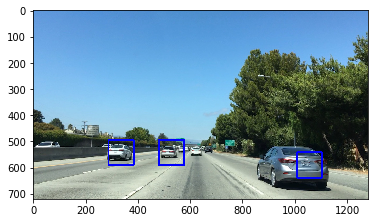

In [11]:
### Tweak these parameters and see how the results change.
orient = 9  # HOG orientations
pix_per_cell = 8 # HOG pixels per cell
cell_per_block = 2 # HOG cells per block
hog_channel = "ALL" # Can be 0, 1, 2, or "ALL"
spatial_size = (32, 32) # Spatial binning dimensions
hist_bins = 32    # Number of histogram bins
spatial_feat = True # Spatial features on or off
hist_feat = True # Histogram features on or off
hog_feat = True # HOG features on or off
y_start_stop = [350, 670] # Min and max in y to search in slide_window()


image = mpimg.imread('bbox-example-image.jpg')
draw_image = np.copy(image)

# Uncomment the following line if you extracted training
# data from .png images (scaled 0 to 1 by mpimg) and the
# image you are searching is a .jpg (scaled 0 to 255)
image = image.astype(np.float32)/255

windows = slide_window(image, x_start_stop=[None, None], y_start_stop=y_start_stop, 
                    xy_window=(96, 96), xy_overlap=(0.5, 0.5))

hot_windows = search_windows(image, windows, svc, X_scaler, color_space=color_space, 
                        spatial_size=spatial_size, hist_bins=hist_bins, 
                        orient=orient, pix_per_cell=pix_per_cell, 
                        cell_per_block=cell_per_block, 
                        hog_channel=hog_channel, spatial_feat=spatial_feat, 
                        hist_feat=hist_feat, hog_feat=hog_feat)                       

window_img = draw_boxes(draw_image, hot_windows, color=(0, 0, 255), thick=6)                    

plt.imshow(window_img)

# Define a function to return list of multi-size sliding windows

In [12]:
def multi_size_slide_window(image, y_start_stop, xy_overlap=(0.75, 0.75)):
    all_bboxes = []
    for win_size in range(95, 140, 20):
        windows = slide_window(image, x_start_stop=[None, None], y_start_stop=y_start_stop, 
                            xy_window=(win_size, win_size), xy_overlap=xy_overlap)

        hot_windows = search_windows(image, windows, svc, X_scaler, color_space=color_space, 
                                spatial_size=spatial_size, hist_bins=hist_bins, 
                                orient=orient, pix_per_cell=pix_per_cell, 
                                cell_per_block=cell_per_block, 
                                hog_channel=hog_channel, spatial_feat=spatial_feat, 
                                hist_feat=hist_feat, hog_feat=hog_feat)                       
        all_bboxes.extend(hot_windows)
    return all_bboxes

# Search for vehicle in test images using multi-size window

C:\ProgramData\Anaconda3\envs\carnd-term1\lib\site-packages\matplotlib\pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


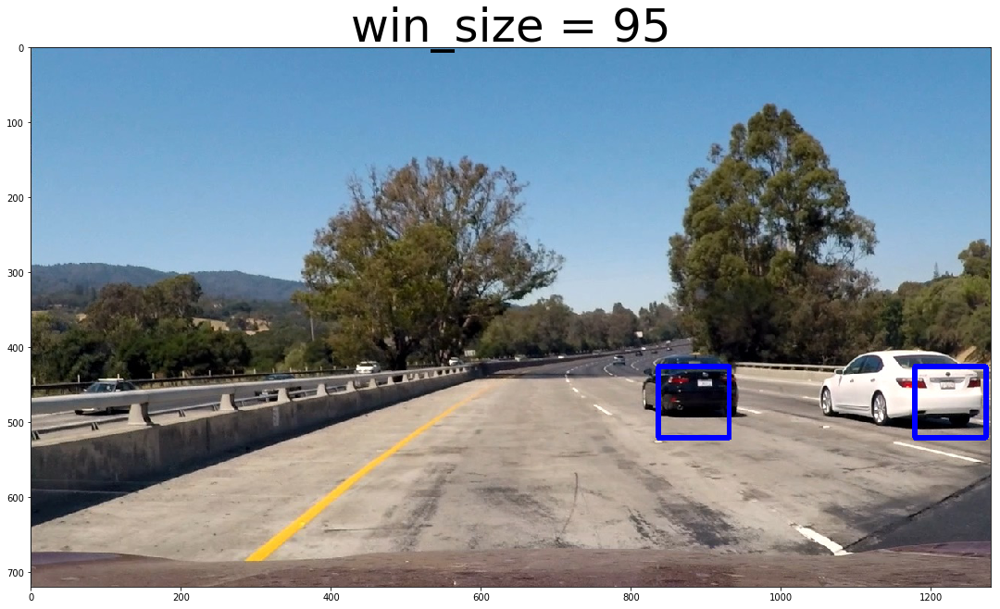

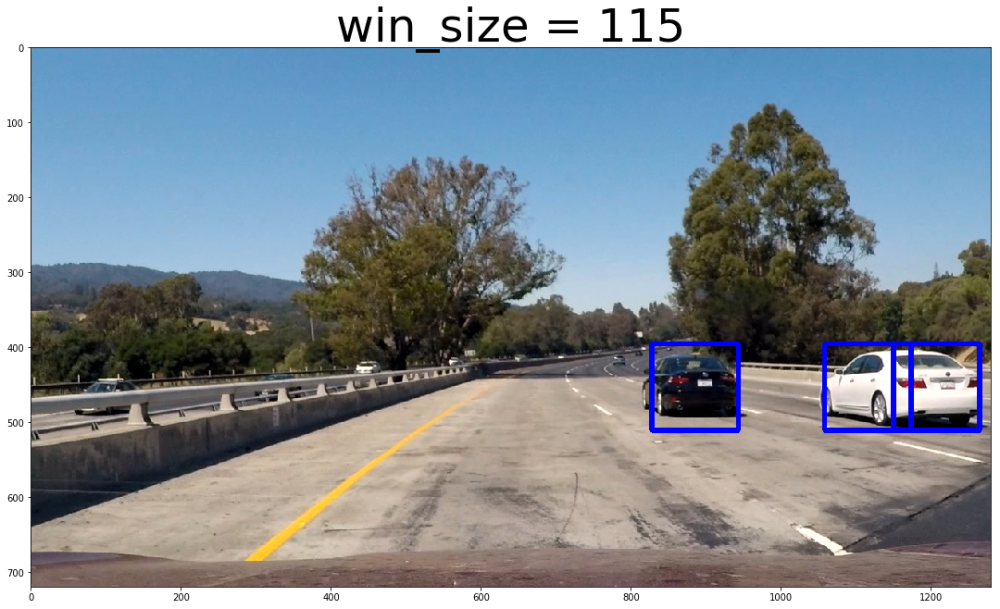

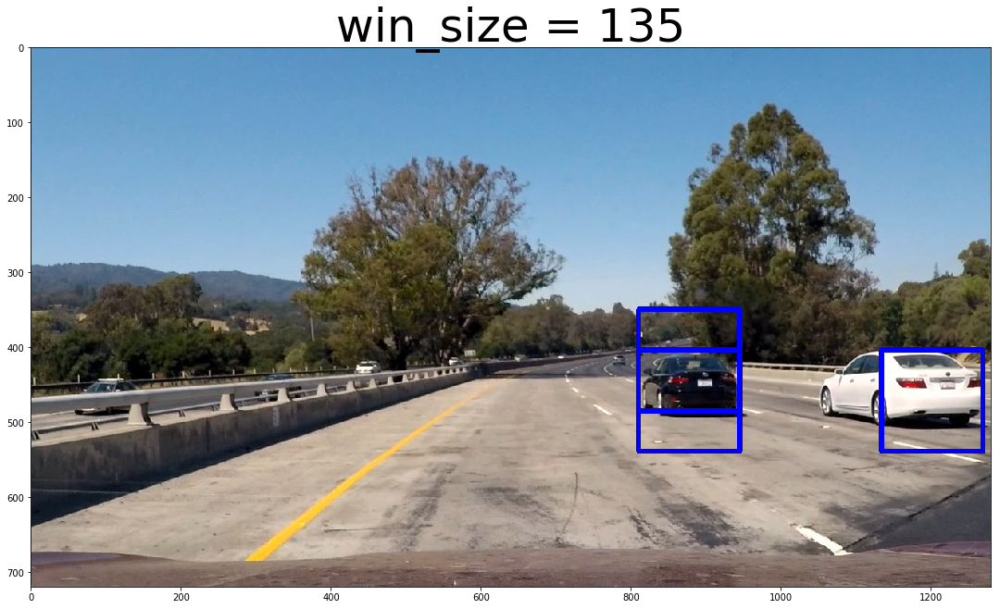

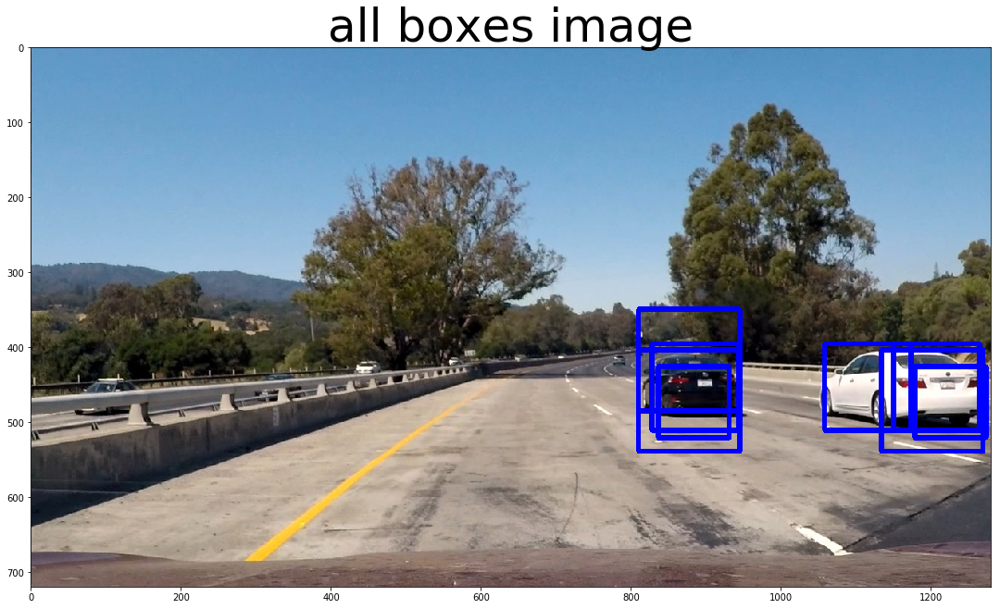

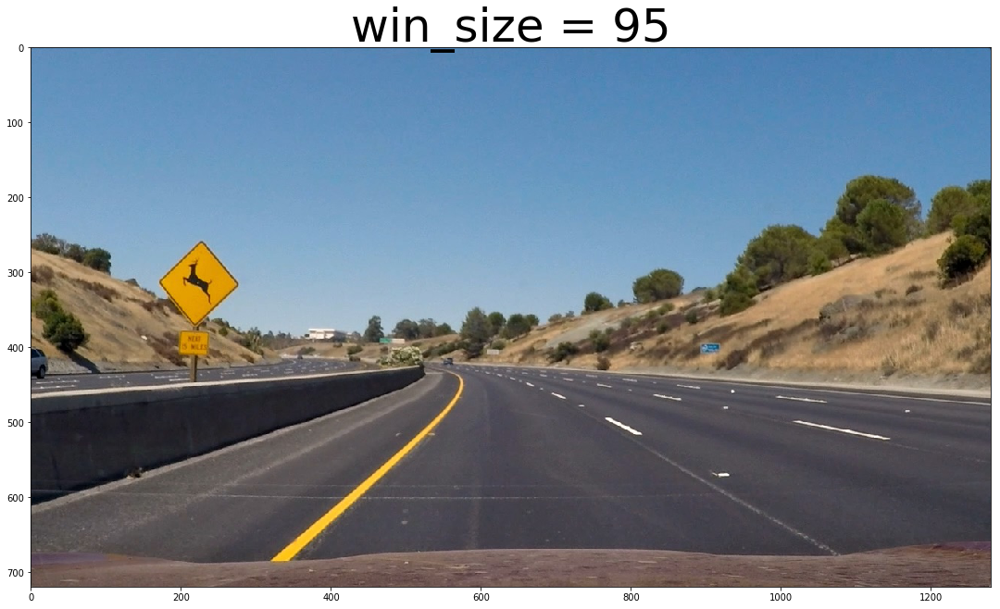

...

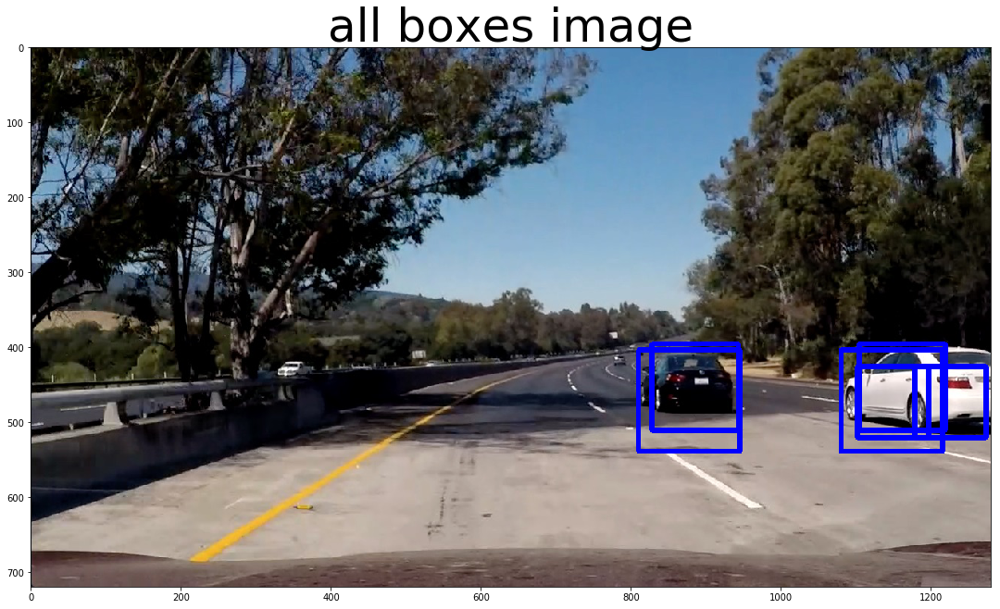

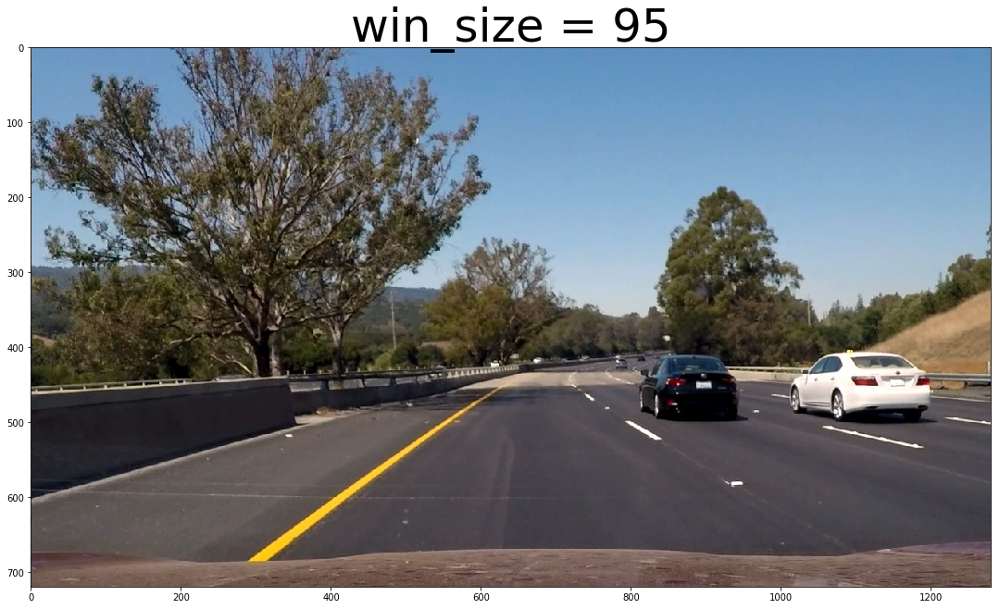

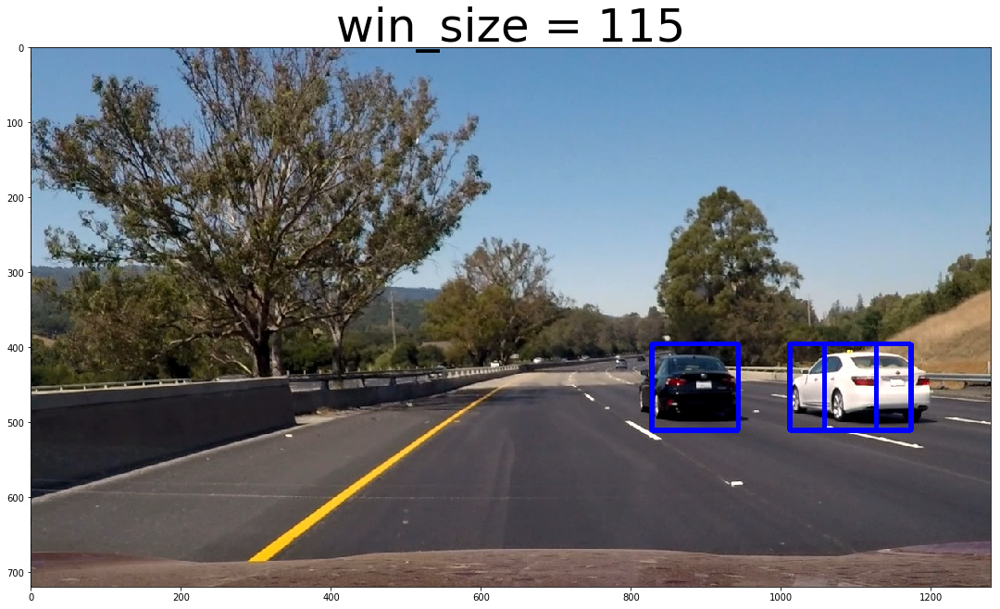

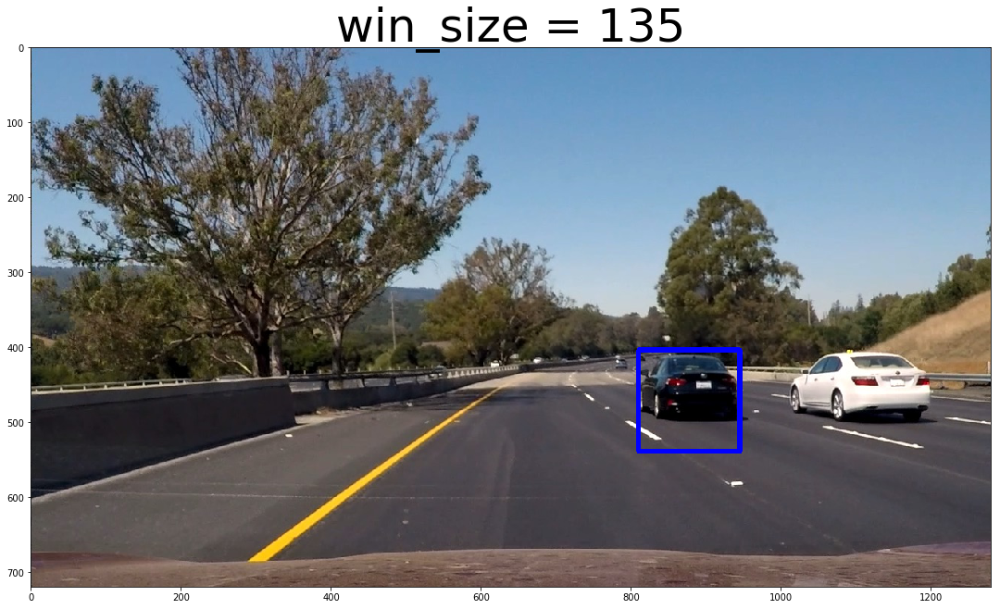

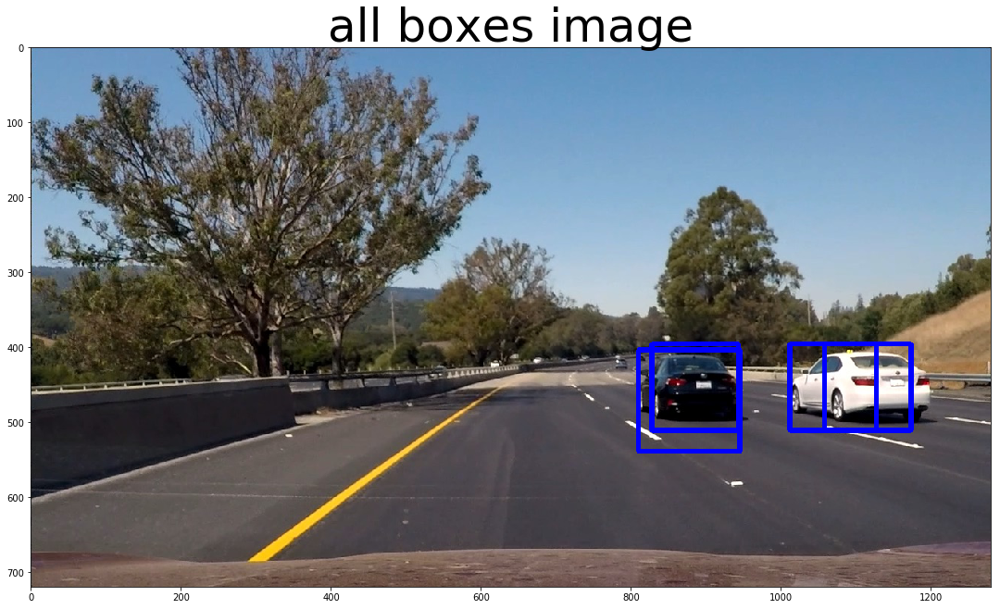

In [13]:
test_images_paths = glob.glob('./test_images/test*.jpg')
for image_path in test_images_paths:
    image = mpimg.imread(image_path)
    draw_image = np.copy(image)

    # Uncomment the following line if you extracted training
    # data from .png images (scaled 0 to 1 by mpimg) and the
    # image you are searching is a .jpg (scaled 0 to 255)
    image = image.astype(np.float32)/255
    all_boxes = []
    for win_size in range(95, 140, 20):
        windows = slide_window(image, x_start_stop=[None, None], y_start_stop=y_start_stop, 
                            xy_window=(win_size, win_size), xy_overlap=(0.6, 0.6))

        hot_windows = search_windows(image, windows, svc, X_scaler, color_space=color_space, 
                                spatial_size=spatial_size, hist_bins=hist_bins, 
                                orient=orient, pix_per_cell=pix_per_cell, 
                                cell_per_block=cell_per_block, 
                                hog_channel=hog_channel, spatial_feat=spatial_feat, 
                                hist_feat=hist_feat, hog_feat=hog_feat)                       
        all_boxes.extend(hot_windows)
        window_img = draw_boxes(draw_image, hot_windows, color=(0, 0, 255), thick=6)                    
        
        f, (ax1) = plt.subplots(1, 1, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(window_img, cmap = 'gray')
        ax1.set_title('win_size = ' + str(win_size),size=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        
    all_window_img = draw_boxes(draw_image, all_boxes, color=(0, 0, 255), thick=6)                    
        
    f, (ax1) = plt.subplots(1, 1, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(all_window_img, cmap = 'gray')
    ax1.set_title('all boxes image',size=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# Define functions for drawing heat map of detected boxes

In [14]:
def add_heat(heatmap, bbox_list):
    # Iterate through list of bboxes
    for box in bbox_list:
        # Add += 1 for all pixels inside each bbox
        # Assuming each "box" takes the form ((x1, y1), (x2, y2))
        heatmap[box[0][1]:box[1][1], box[0][0]:box[1][0]] += 1

    # Return updated heatmap
    return heatmap# Iterate through list of bboxes
    
def apply_threshold(heatmap, threshold):
    # Zero out pixels below the threshold
    heatmap[heatmap <= threshold] = 0
    # Return thresholded map
    return heatmap

def get_labeled_bboxes(labels):
    heat_bboxes = []
    # Iterate through all detected cars
    for car_number in range(1, labels[1]+1):
        # Find pixels with each car_number label value
        nonzero = (labels[0] == car_number).nonzero()
        # Identify x and y values of those pixels
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Define a bounding box based on min/max x and y
        bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
        heat_bboxes.append(bbox)
    return heat_bboxes

def draw_labeled_bboxes(img, labels):
    heat_bboxes = get_labeled_bboxes(labels)
    for bbox in heat_bboxes:
        # Draw the box on the image
        cv2.rectangle(img, bbox[0], bbox[1], (0,0,255), 6)
    # Return the image
    return img

# Draw heat map of detected boxes

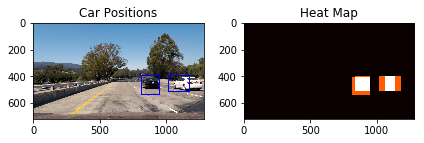

In [15]:
from scipy.ndimage.measurements import label

# Read in image
image = mpimg.imread('./test_images/test1.jpg')
# define an image similar to ones above 
heat = np.zeros_like(image[:,:,0]).astype(np.float)

# Add heat to each box in box list
heat = add_heat(heat,all_boxes)
    
# Apply threshold to help remove false positives
heat = apply_threshold(heat,0)

# Visualize the heatmap when displaying    
heatmap = np.clip(heat, 0, 255)

# Find final boxes from heatmap using label function
labels = label(heatmap)
draw_img = draw_labeled_bboxes(np.copy(image), labels)

fig = plt.figure()
plt.subplot(121)
plt.imshow(draw_img)
plt.title('Car Positions')
plt.subplot(122)
plt.imshow(heatmap, cmap='hot')
plt.title('Heat Map')
fig.tight_layout()

# Draw bboxes and heat map

28.71 Seconds to get boxes image:  ./test_images\test1.jpg
28.74 Seconds to finish processing image:  ./test_images\test1.jpg
27.0 Seconds to get boxes image:  ./test_images\test2.jpg
27.02 Seconds to finish processing image:  ./test_images\test2.jpg
28.13 Seconds to get boxes image:  ./test_images\test3.jpg
28.15 Seconds to finish processing image:  ./test_images\test3.jpg
27.59 Seconds to get boxes image:  ./test_images\test4.jpg
27.61 Seconds to finish processing image:  ./test_images\test4.jpg
28.37 Seconds to get boxes image:  ./test_images\test5.jpg
28.39 Seconds to finish processing image:  ./test_images\test5.jpg
29.62 Seconds to get boxes image:  ./test_images\test6.jpg
29.64 Seconds to finish processing image:  ./test_images\test6.jpg


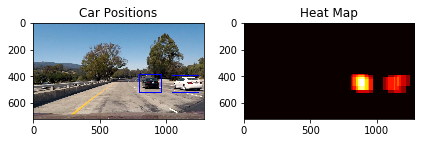

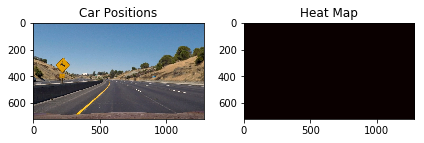

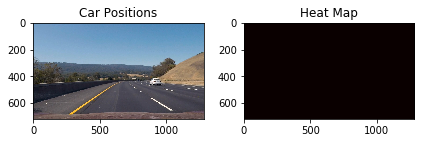

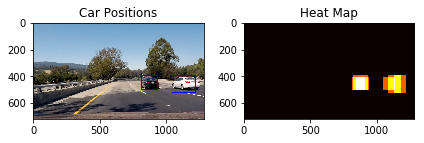

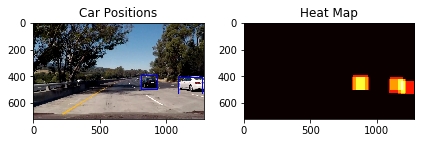

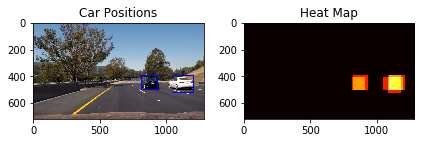

In [16]:
test_images_paths = glob.glob('./test_images/test*.jpg')
y_start_stop = [350, 680]
for image_path in test_images_paths:
    image = mpimg.imread(image_path)
    draw_image = np.copy(image)

    # Uncomment the following line if you extracted training
    # data from .png images (scaled 0 to 1 by mpimg) and the
    # image you are searching is a .jpg (scaled 0 to 255)
    image = image.astype(np.float32)/255
    
    # Check the time to get bboxes in the image
    t=time.time()
    bboxes = multi_size_slide_window(image, y_start_stop = y_start_stop, xy_overlap=(0.7, 0.7))
    t2 = time.time()
    print(round(t2-t, 2), 'Seconds to get boxes image: ', image_path)

    # define an image similar to ones above 
    heat = np.zeros_like(image[:,:,0]).astype(np.float)

    # Add heat to each box in box list
    heat = add_heat(heat,bboxes)

    # Apply threshold to help remove false positives
    number_of_false_positives = 1
    heat = apply_threshold(heat,number_of_false_positives)

    # Visualize the heatmap when displaying    
    heatmap = np.clip(heat, 0, 255)

    # Find final boxes from heatmap using label function
    labels = label(heatmap)
    draw_img = draw_labeled_bboxes(draw_image, labels)
    
    t3 = time.time()
    print(round(t3-t, 2), 'Seconds to finish processing image: ', image_path)

    fig = plt.figure()
    plt.subplot(121)
    plt.imshow(draw_img)
    plt.title('Car Positions')
    plt.subplot(122)
    plt.imshow(heatmap, cmap='hot')
    plt.title('Heat Map')
    fig.tight_layout()

# Implementing the complete pipe line in one function

In [17]:
from copy import deepcopy
# input image read by mpimg
num_frames_to_hold_output_bboxes = 6
num_frames_to_hold_counter = 0
old_bboxes = [None] * num_frames_to_hold_output_bboxes

def process_image(image):
    global old_bboxes
    global num_frames_to_hold_output_bboxes
    global num_frames_to_hold_counter
    
    draw_image = np.copy(image)

    # Uncomment the following line if you extracted training
    # data from .png images (scaled 0 to 1 by mpimg) and the
    # image you are searching is a .jpg (scaled 0 to 255)
    image = image.astype(np.float32)/255

    bboxes = multi_size_slide_window(image, y_start_stop = y_start_stop, xy_overlap=(0.7, 0.7))

    # define an image similar to ones above 
    heat = np.zeros_like(image[:,:,0]).astype(np.float)
    
    test_heat_bboxes = []
    for b in bboxes:
        test_heat_bboxes.append(b)
    
    for old_frame_boxes_idx in range(min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter)):
        for b in old_bboxes[old_frame_boxes_idx]:
            test_heat_bboxes.append(b)
        
    # Add heat to each box in box list
    heat = add_heat(heat,test_heat_bboxes)

    # Apply threshold to help remove false positives
    number_of_false_positives = 9
    heat = apply_threshold(heat,number_of_false_positives)

    # Visualize the heatmap when displaying    
    heatmap = np.clip(heat, 0, 255)

    # Find final boxes from heatmap using label function
    labels = label(heatmap)
    processed_image = draw_labeled_bboxes(draw_image, labels)
    
    old_bboxes[num_frames_to_hold_counter % num_frames_to_hold_output_bboxes] = []
    for b in bboxes:
        old_bboxes[num_frames_to_hold_counter % num_frames_to_hold_output_bboxes].append(b)
    
    print("min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter): ", min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter))
    print("old_bboxes[{}] = {}".format(num_frames_to_hold_counter % num_frames_to_hold_output_bboxes, old_bboxes[num_frames_to_hold_counter % num_frames_to_hold_output_bboxes]))
    num_frames_to_hold_counter += 1
    return processed_image

# Run process image on one image

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  0
old_bboxes[0] = [((812, 378), (907, 473)), ((1148, 378), (1243, 473)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((868, 406), (963, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((850, 418), (965, 533)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


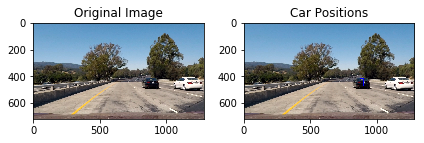

In [18]:
image = mpimg.imread(test_images_paths[0])
processed_image = process_image(image)

fig = plt.figure()
plt.subplot(121)
plt.imshow(image)
plt.title('Original Image')
plt.subplot(122)
plt.imshow(processed_image)
plt.title('Car Positions')
fig.tight_layout()

# Run the pipline on a video input

In [22]:
# Import everything needed to edit/save/watch video clips# Import 
from moviepy.editor import VideoFileClip
from IPython.display import HTML

num_frames_to_hold_counter = 0

In [23]:
video_output = 'output_videos/project_video.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("project_video.mp4")
out_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time out_clip.write_videofile(video_output, audio=False)

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  0
old_bboxes[0] = []
[MoviePy] >>>> Building video output_videos/project_video.mp4
[MoviePy] Writing video output_videos/project_video.mp4


  0%|          | 0/1261 [00:00<?, ?it/s]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  1
old_bboxes[1] = []


  0%|          | 1/1261 [00:25<9:03:03, 25.86s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  2
old_bboxes[2] = []


  0%|          | 2/1261 [00:51<8:55:18, 25.51s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  3
old_bboxes[3] = []


  0%|          | 3/1261 [01:16<8:52:18, 25.39s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  4
old_bboxes[4] = []


  0%|          | 4/1261 [01:41<8:51:49, 25.39s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  5
old_bboxes[5] = []


  0%|          | 5/1261 [02:06<8:50:28, 25.34s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  0%|          | 6/1261 [02:31<8:49:16, 25.30s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  1%|          | 7/1261 [02:56<8:48:03, 25.27s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


  1%|          | 8/1261 [03:21<8:47:13, 25.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


  1%|          | 9/1261 [03:47<8:47:16, 25.27s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  1%|          | 10/1261 [04:12<8:46:53, 25.27s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


  1%|          | 11/1261 [04:37<8:46:01, 25.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  1%|          | 12/1261 [05:02<8:45:24, 25.24s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  1%|          | 13/1261 [05:28<8:44:48, 25.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


  1%|          | 14/1261 [05:53<8:44:38, 25.24s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


  1%|          | 15/1261 [06:18<8:44:06, 25.24s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  1%|▏         | 16/1261 [06:43<8:43:27, 25.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


  1%|▏         | 17/1261 [07:08<8:43:07, 25.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  1%|▏         | 18/1261 [07:34<8:42:35, 25.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  2%|▏         | 19/1261 [07:59<8:42:29, 25.24s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


  2%|▏         | 20/1261 [08:24<8:41:55, 25.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


  2%|▏         | 21/1261 [08:49<8:41:20, 25.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  2%|▏         | 22/1261 [09:14<8:40:52, 25.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


  2%|▏         | 23/1261 [09:40<8:40:43, 25.24s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  2%|▏         | 24/1261 [10:05<8:40:06, 25.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  2%|▏         | 25/1261 [10:30<8:39:23, 25.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


  2%|▏         | 26/1261 [10:55<8:39:18, 25.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


  2%|▏         | 27/1261 [11:23<8:40:32, 25.31s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  2%|▏         | 28/1261 [11:48<8:40:17, 25.32s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


  2%|▏         | 29/1261 [12:14<8:39:44, 25.31s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  2%|▏         | 30/1261 [12:38<8:39:01, 25.30s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  2%|▏         | 31/1261 [13:03<8:38:23, 25.29s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


  3%|▎         | 32/1261 [13:28<8:37:44, 25.28s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


  3%|▎         | 33/1261 [13:54<8:37:15, 25.27s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  3%|▎         | 34/1261 [14:18<8:36:39, 25.26s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


  3%|▎         | 35/1261 [14:43<8:36:01, 25.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  3%|▎         | 36/1261 [15:10<8:36:11, 25.28s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  3%|▎         | 37/1261 [15:37<8:37:06, 25.35s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


  3%|▎         | 38/1261 [16:06<8:38:25, 25.43s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


  3%|▎         | 39/1261 [16:32<8:38:27, 25.46s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  3%|▎         | 40/1261 [17:02<8:40:05, 25.56s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


  3%|▎         | 41/1261 [17:31<8:41:22, 25.64s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  3%|▎         | 42/1261 [18:00<8:42:49, 25.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  3%|▎         | 43/1261 [18:29<8:43:57, 25.81s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


  3%|▎         | 44/1261 [18:59<8:45:04, 25.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


  4%|▎         | 45/1261 [19:28<8:46:02, 25.96s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  4%|▎         | 46/1261 [19:57<8:47:07, 26.03s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


  4%|▎         | 47/1261 [20:26<8:47:58, 26.09s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  4%|▍         | 48/1261 [20:55<8:48:48, 26.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  4%|▍         | 49/1261 [21:24<8:49:33, 26.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


  4%|▍         | 50/1261 [21:53<8:50:18, 26.27s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


  4%|▍         | 51/1261 [22:21<8:50:37, 26.31s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  4%|▍         | 52/1261 [22:50<8:51:07, 26.36s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


  4%|▍         | 53/1261 [23:18<8:51:19, 26.39s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  4%|▍         | 54/1261 [23:47<8:51:54, 26.44s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  4%|▍         | 55/1261 [24:16<8:52:27, 26.49s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


  4%|▍         | 56/1261 [24:46<8:52:57, 26.54s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


  5%|▍         | 57/1261 [25:15<8:53:25, 26.58s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  5%|▍         | 58/1261 [25:43<8:53:39, 26.62s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


  5%|▍         | 59/1261 [26:10<8:53:19, 26.62s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  5%|▍         | 60/1261 [26:39<8:53:40, 26.66s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  5%|▍         | 61/1261 [27:08<8:53:58, 26.70s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


  5%|▍         | 62/1261 [27:37<8:54:20, 26.74s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


  5%|▍         | 63/1261 [28:06<8:54:39, 26.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  5%|▌         | 64/1261 [28:35<8:54:53, 26.81s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


  5%|▌         | 65/1261 [29:05<8:55:10, 26.85s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  5%|▌         | 66/1261 [29:34<8:55:22, 26.88s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  5%|▌         | 67/1261 [30:03<8:55:40, 26.92s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


  5%|▌         | 68/1261 [30:32<8:55:48, 26.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


  5%|▌         | 69/1261 [31:01<8:55:58, 26.98s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  6%|▌         | 70/1261 [31:30<8:56:05, 27.01s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


  6%|▌         | 71/1261 [32:00<8:56:21, 27.04s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  6%|▌         | 72/1261 [32:29<8:56:27, 27.07s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  6%|▌         | 73/1261 [32:57<8:56:29, 27.10s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


  6%|▌         | 74/1261 [33:27<8:56:33, 27.12s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


  6%|▌         | 75/1261 [33:56<8:56:39, 27.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  6%|▌         | 76/1261 [34:25<8:56:41, 27.17s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


  6%|▌         | 77/1261 [34:54<8:56:42, 27.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  6%|▌         | 78/1261 [35:23<8:56:42, 27.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  6%|▋         | 79/1261 [35:52<8:56:42, 27.24s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((308, 350), (403, 445))]


  6%|▋         | 80/1261 [36:21<8:56:44, 27.27s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((308, 350), (403, 445))]


  6%|▋         | 81/1261 [36:50<8:56:39, 27.29s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  7%|▋         | 82/1261 [37:15<8:55:41, 27.26s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((308, 350), (403, 445))]


  7%|▋         | 83/1261 [37:40<8:54:46, 27.24s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  7%|▋         | 84/1261 [38:06<8:53:52, 27.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  7%|▋         | 85/1261 [38:31<8:52:56, 27.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


  7%|▋         | 86/1261 [38:57<8:52:13, 27.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((308, 350), (403, 445))]


  7%|▋         | 87/1261 [39:22<8:51:21, 27.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  7%|▋         | 88/1261 [39:47<8:50:30, 27.14s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


  7%|▋         | 89/1261 [40:13<8:49:38, 27.11s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  7%|▋         | 90/1261 [40:38<8:48:44, 27.09s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  7%|▋         | 91/1261 [41:05<8:48:19, 27.09s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


  7%|▋         | 92/1261 [41:36<8:48:47, 27.14s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


  7%|▋         | 93/1261 [42:06<8:48:51, 27.17s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  7%|▋         | 94/1261 [42:36<8:48:53, 27.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


  8%|▊         | 95/1261 [43:05<8:48:50, 27.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  8%|▊         | 96/1261 [43:34<8:48:45, 27.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  8%|▊         | 97/1261 [44:03<8:48:47, 27.26s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


  8%|▊         | 98/1261 [44:32<8:48:30, 27.27s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


  8%|▊         | 99/1261 [45:00<8:48:15, 27.28s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  8%|▊         | 100/1261 [45:30<8:48:18, 27.30s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


  8%|▊         | 101/1261 [46:00<8:48:24, 27.33s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  8%|▊         | 102/1261 [46:31<8:48:33, 27.36s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  8%|▊         | 103/1261 [47:01<8:48:38, 27.39s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


  8%|▊         | 104/1261 [47:29<8:48:19, 27.40s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


  8%|▊         | 105/1261 [47:59<8:48:23, 27.43s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  8%|▊         | 106/1261 [48:29<8:48:23, 27.45s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


  8%|▊         | 107/1261 [48:59<8:48:23, 27.47s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  9%|▊         | 108/1261 [49:28<8:48:06, 27.48s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  9%|▊         | 109/1261 [49:56<8:47:51, 27.49s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((364, 350), (459, 445))]


  9%|▊         | 110/1261 [50:24<8:47:28, 27.50s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


  9%|▉         | 111/1261 [50:53<8:47:12, 27.51s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  9%|▉         | 112/1261 [51:21<8:46:50, 27.51s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


  9%|▉         | 113/1261 [51:50<8:46:36, 27.52s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


  9%|▉         | 114/1261 [52:19<8:46:25, 27.54s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


  9%|▉         | 115/1261 [52:47<8:46:04, 27.54s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


  9%|▉         | 116/1261 [53:16<8:45:49, 27.55s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


  9%|▉         | 117/1261 [53:45<8:45:34, 27.57s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


  9%|▉         | 118/1261 [54:17<8:45:54, 27.61s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


  9%|▉         | 119/1261 [54:46<8:45:42, 27.62s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


 10%|▉         | 120/1261 [55:18<8:45:53, 27.65s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 10%|▉         | 121/1261 [55:50<8:46:05, 27.69s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 10%|▉         | 122/1261 [56:18<8:45:38, 27.69s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 10%|▉         | 123/1261 [56:45<8:45:06, 27.69s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


 10%|▉         | 124/1261 [57:15<8:45:03, 27.71s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


 10%|▉         | 125/1261 [57:51<8:45:53, 27.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


 10%|▉         | 126/1261 [58:23<8:46:03, 27.81s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 10%|█         | 127/1261 [58:52<8:45:45, 27.82s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 10%|█         | 128/1261 [59:20<8:45:17, 27.82s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 10%|█         | 129/1261 [59:50<8:45:08, 27.83s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


 10%|█         | 130/1261 [1:00:18<8:44:40, 27.83s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


 10%|█         | 131/1261 [1:00:45<8:44:09, 27.83s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


 10%|█         | 132/1261 [1:01:13<8:43:37, 27.83s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 11%|█         | 133/1261 [1:01:40<8:43:06, 27.82s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((84, 406), (179, 501))]


 11%|█         | 134/1261 [1:02:08<8:42:40, 27.83s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((84, 406), (179, 501))]


 11%|█         | 135/1261 [1:02:36<8:42:15, 27.83s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((56, 406), (151, 501))]


 11%|█         | 136/1261 [1:03:05<8:41:55, 27.84s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((28, 406), (123, 501)), ((34, 384), (149, 499))]


 11%|█         | 137/1261 [1:03:33<8:41:25, 27.83s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((0, 406), (95, 501))]


 11%|█         | 138/1261 [1:04:01<8:41:04, 27.84s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 11%|█         | 139/1261 [1:04:31<8:40:46, 27.85s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 11%|█         | 140/1261 [1:04:59<8:40:23, 27.85s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 11%|█         | 141/1261 [1:05:28<8:40:04, 27.86s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


 11%|█▏        | 142/1261 [1:05:58<8:39:55, 27.88s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


 11%|█▏        | 143/1261 [1:06:27<8:39:38, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


 11%|█▏        | 144/1261 [1:06:57<8:39:21, 27.90s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 11%|█▏        | 145/1261 [1:07:26<8:39:00, 27.90s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 12%|█▏        | 146/1261 [1:07:55<8:38:46, 27.92s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 12%|█▏        | 147/1261 [1:08:25<8:38:28, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


 12%|█▏        | 148/1261 [1:08:53<8:38:05, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


 12%|█▏        | 149/1261 [1:09:20<8:37:33, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


 12%|█▏        | 150/1261 [1:09:48<8:37:01, 27.92s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 12%|█▏        | 151/1261 [1:10:15<8:36:30, 27.92s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 12%|█▏        | 152/1261 [1:10:43<8:36:03, 27.92s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 12%|█▏        | 153/1261 [1:11:13<8:35:45, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


 12%|█▏        | 154/1261 [1:11:43<8:35:34, 27.94s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


 12%|█▏        | 155/1261 [1:12:12<8:35:17, 27.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


 12%|█▏        | 156/1261 [1:12:39<8:34:43, 27.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 12%|█▏        | 157/1261 [1:13:07<8:34:11, 27.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 13%|█▎        | 158/1261 [1:13:34<8:33:38, 27.94s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 13%|█▎        | 159/1261 [1:14:02<8:33:08, 27.94s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


 13%|█▎        | 160/1261 [1:14:29<8:32:37, 27.94s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1176, 406), (1271, 501)), ((1156, 418), (1271, 533))]


 13%|█▎        | 161/1261 [1:14:57<8:32:06, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


 13%|█▎        | 162/1261 [1:15:24<8:31:35, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1120, 390), (1255, 525))]


 13%|█▎        | 163/1261 [1:15:52<8:31:05, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1176, 406), (1271, 501)), ((408, 350), (523, 465)), ((1156, 418), (1271, 533)), ((1120, 390), (1255, 525))]


 13%|█▎        | 164/1261 [1:16:20<8:30:37, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((408, 350), (523, 465)), ((1120, 390), (1255, 525))]


 13%|█▎        | 165/1261 [1:16:47<8:30:07, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((408, 350), (523, 465)), ((1120, 390), (1255, 525))]


 13%|█▎        | 166/1261 [1:17:16<8:29:41, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((408, 350), (523, 465)), ((1120, 390), (1255, 525))]


 13%|█▎        | 167/1261 [1:17:43<8:29:12, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((408, 350), (523, 465)), ((1120, 390), (1255, 525))]


 13%|█▎        | 168/1261 [1:18:18<8:29:30, 27.97s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1148, 406), (1243, 501)), ((408, 350), (523, 465)), ((1120, 390), (1255, 525))]


 13%|█▎        | 169/1261 [1:18:48<8:29:14, 27.98s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((408, 350), (523, 465)), ((1120, 390), (1255, 525))]


 13%|█▎        | 170/1261 [1:19:15<8:28:41, 27.98s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1148, 406), (1243, 501)), ((408, 350), (523, 465)), ((1120, 390), (1255, 525))]


 14%|█▎        | 171/1261 [1:19:43<8:28:10, 27.97s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1148, 406), (1243, 501)), ((408, 350), (523, 465)), ((1120, 390), (1255, 525))]


 14%|█▎        | 172/1261 [1:20:10<8:27:36, 27.97s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1120, 390), (1255, 525))]


 14%|█▎        | 173/1261 [1:20:37<8:27:03, 27.96s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1148, 406), (1243, 501)), ((408, 350), (523, 465)), ((1120, 390), (1255, 525))]


 14%|█▍        | 174/1261 [1:21:04<8:26:29, 27.96s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((408, 350), (523, 465)), ((1122, 418), (1237, 533)), ((1120, 390), (1255, 525))]


 14%|█▍        | 175/1261 [1:21:31<8:25:56, 27.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((408, 350), (523, 465)), ((1122, 418), (1237, 533)), ((1120, 390), (1255, 525))]


 14%|█▍        | 176/1261 [1:21:59<8:25:25, 27.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1120, 390), (1255, 525))]


 14%|█▍        | 177/1261 [1:22:26<8:24:56, 27.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1122, 418), (1237, 533)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 14%|█▍        | 178/1261 [1:22:54<8:24:27, 27.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1122, 418), (1237, 533)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 14%|█▍        | 179/1261 [1:23:22<8:23:58, 27.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1122, 418), (1237, 533)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 14%|█▍        | 180/1261 [1:23:50<8:23:28, 27.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1120, 406), (1215, 501)), ((1122, 418), (1237, 533)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 14%|█▍        | 181/1261 [1:24:17<8:22:58, 27.94s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1120, 406), (1215, 501)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 14%|█▍        | 182/1261 [1:24:45<8:22:27, 27.94s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1120, 406), (1215, 501)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 15%|█▍        | 183/1261 [1:25:12<8:21:55, 27.94s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1120, 406), (1215, 501)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 15%|█▍        | 184/1261 [1:25:39<8:21:25, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1120, 406), (1215, 501)), ((1080, 390), (1215, 525))]


 15%|█▍        | 185/1261 [1:26:07<8:20:56, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1120, 406), (1215, 501)), ((442, 350), (557, 465)), ((1088, 418), (1203, 533)), ((1080, 390), (1215, 525))]


 15%|█▍        | 186/1261 [1:26:35<8:20:25, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1120, 406), (1215, 501)), ((442, 350), (557, 465)), ((1088, 418), (1203, 533)), ((1080, 390), (1215, 525))]


 15%|█▍        | 187/1261 [1:27:02<8:19:54, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1120, 406), (1215, 501)), ((442, 350), (557, 465)), ((1080, 390), (1215, 525))]


 15%|█▍        | 188/1261 [1:27:30<8:19:24, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((448, 350), (543, 445)), ((1088, 418), (1203, 533)), ((1080, 390), (1215, 525))]


 15%|█▍        | 189/1261 [1:27:57<8:18:54, 27.92s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1120, 406), (1215, 501)), ((442, 350), (557, 465)), ((1088, 418), (1203, 533)), ((1080, 390), (1215, 525))]


 15%|█▌        | 190/1261 [1:28:25<8:18:23, 27.92s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((442, 350), (557, 465)), ((1088, 418), (1203, 533)), ((1080, 390), (1215, 525))]


 15%|█▌        | 191/1261 [1:28:52<8:17:52, 27.92s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((442, 350), (557, 465)), ((1088, 418), (1203, 533)), ((1080, 390), (1215, 525))]


 15%|█▌        | 192/1261 [1:29:19<8:17:19, 27.91s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1088, 418), (1203, 533)), ((1080, 390), (1215, 525))]


 15%|█▌        | 193/1261 [1:29:47<8:16:50, 27.91s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1092, 406), (1187, 501)), ((442, 350), (557, 465)), ((1088, 418), (1203, 533)), ((1080, 390), (1215, 525))]


 15%|█▌        | 194/1261 [1:30:14<8:16:18, 27.91s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1092, 406), (1187, 501)), ((1088, 418), (1203, 533)), ((1080, 390), (1215, 525))]


 15%|█▌        | 195/1261 [1:30:41<8:15:46, 27.90s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1092, 406), (1187, 501)), ((1080, 390), (1215, 525))]


 16%|█▌        | 196/1261 [1:31:08<8:15:13, 27.90s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1092, 406), (1187, 501)), ((1080, 390), (1215, 525))]


 16%|█▌        | 197/1261 [1:31:35<8:14:39, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1092, 406), (1187, 501)), ((1088, 418), (1203, 533)), ((1080, 390), (1215, 525))]


 16%|█▌        | 198/1261 [1:32:02<8:14:06, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1092, 406), (1187, 501)), ((1088, 418), (1203, 533)), ((1080, 390), (1215, 525))]


 16%|█▌        | 199/1261 [1:32:28<8:13:32, 27.88s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1088, 384), (1203, 499)), ((1088, 418), (1203, 533)), ((1080, 390), (1215, 525))]


 16%|█▌        | 200/1261 [1:32:55<8:13:00, 27.88s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1092, 406), (1187, 501)), ((1088, 384), (1203, 499)), ((1088, 418), (1203, 533)), ((1080, 390), (1215, 525))]


 16%|█▌        | 201/1261 [1:33:23<8:12:28, 27.88s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1092, 406), (1187, 501)), ((1088, 418), (1203, 533)), ((1080, 390), (1215, 525))]


 16%|█▌        | 202/1261 [1:33:50<8:11:58, 27.87s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1092, 406), (1187, 501)), ((1088, 418), (1203, 533)), ((1156, 418), (1271, 533)), ((1080, 390), (1215, 525))]


 16%|█▌        | 203/1261 [1:34:17<8:11:26, 27.87s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1092, 406), (1187, 501)), ((1088, 418), (1203, 533)), ((1156, 418), (1271, 533)), ((1080, 390), (1215, 525))]


 16%|█▌        | 204/1261 [1:34:44<8:10:54, 27.87s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1092, 406), (1187, 501)), ((1088, 418), (1203, 533)), ((1156, 418), (1271, 533)), ((1080, 390), (1215, 525))]


 16%|█▋        | 205/1261 [1:35:11<8:10:22, 27.86s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1092, 406), (1187, 501)), ((1156, 418), (1271, 533)), ((1080, 390), (1215, 525))]


 16%|█▋        | 206/1261 [1:35:38<8:09:50, 27.86s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1092, 406), (1187, 501)), ((1156, 418), (1271, 533)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 16%|█▋        | 207/1261 [1:36:06<8:09:20, 27.86s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1092, 406), (1187, 501)), ((1156, 418), (1271, 533)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 16%|█▋        | 208/1261 [1:36:33<8:08:49, 27.85s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1092, 406), (1187, 501)), ((1156, 418), (1271, 533)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 17%|█▋        | 209/1261 [1:37:00<8:08:18, 27.85s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1092, 406), (1187, 501)), ((1156, 418), (1271, 533)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 17%|█▋        | 210/1261 [1:37:27<8:07:46, 27.85s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1156, 418), (1271, 533)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 17%|█▋        | 211/1261 [1:37:55<8:07:16, 27.84s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1092, 406), (1187, 501)), ((1156, 418), (1271, 533)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 17%|█▋        | 212/1261 [1:38:22<8:06:45, 27.84s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1064, 406), (1159, 501)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 17%|█▋        | 213/1261 [1:38:49<8:06:14, 27.84s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1064, 406), (1159, 501)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 17%|█▋        | 214/1261 [1:39:16<8:05:43, 27.83s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1064, 406), (1159, 501)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 17%|█▋        | 215/1261 [1:39:44<8:05:12, 27.83s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1064, 406), (1159, 501)), ((1054, 418), (1169, 533)), ((1156, 418), (1271, 533)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 17%|█▋        | 216/1261 [1:40:11<8:04:41, 27.83s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1064, 406), (1159, 501)), ((1156, 418), (1271, 533)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 17%|█▋        | 217/1261 [1:40:38<8:04:10, 27.83s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1064, 406), (1159, 501)), ((1040, 390), (1175, 525))]


 17%|█▋        | 218/1261 [1:41:05<8:03:39, 27.82s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1064, 406), (1159, 501)), ((1040, 390), (1175, 525))]


 17%|█▋        | 219/1261 [1:41:32<8:03:10, 27.82s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1064, 406), (1159, 501)), ((578, 554), (693, 669)), ((1040, 390), (1175, 525))]


 17%|█▋        | 220/1261 [1:42:00<8:02:40, 27.82s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1064, 406), (1159, 501)), ((1040, 390), (1175, 525))]


 18%|█▊        | 221/1261 [1:42:27<8:02:09, 27.82s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1064, 406), (1159, 501)), ((1040, 390), (1175, 525))]


 18%|█▊        | 222/1261 [1:42:54<8:01:38, 27.81s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1064, 406), (1159, 501)), ((1040, 390), (1175, 525))]


 18%|█▊        | 223/1261 [1:43:21<8:01:07, 27.81s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1064, 406), (1159, 501)), ((1054, 418), (1169, 533)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 18%|█▊        | 224/1261 [1:43:48<8:00:36, 27.81s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1064, 406), (1159, 501)), ((1054, 418), (1169, 533)), ((1040, 390), (1175, 525))]


 18%|█▊        | 225/1261 [1:44:16<8:00:05, 27.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1064, 406), (1159, 501)), ((1054, 418), (1169, 533)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 18%|█▊        | 226/1261 [1:44:43<7:59:34, 27.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1064, 406), (1159, 501)), ((1054, 418), (1169, 533)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 18%|█▊        | 227/1261 [1:45:10<7:59:03, 27.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1064, 406), (1159, 501)), ((1054, 418), (1169, 533)), ((1040, 390), (1175, 525))]


 18%|█▊        | 228/1261 [1:45:37<7:58:31, 27.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1064, 406), (1159, 501)), ((1054, 418), (1169, 533)), ((1156, 418), (1271, 533)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 18%|█▊        | 229/1261 [1:46:04<7:58:00, 27.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1064, 406), (1159, 501)), ((1054, 418), (1169, 533)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 18%|█▊        | 230/1261 [1:46:32<7:57:34, 27.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1064, 406), (1159, 501)), ((1054, 418), (1169, 533)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 18%|█▊        | 231/1261 [1:46:59<7:57:04, 27.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1064, 406), (1159, 501)), ((1054, 418), (1169, 533)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 18%|█▊        | 232/1261 [1:47:28<7:56:39, 27.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1064, 406), (1159, 501)), ((1054, 418), (1169, 533)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 18%|█▊        | 233/1261 [1:47:59<7:56:26, 27.81s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1064, 406), (1159, 501)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 19%|█▊        | 234/1261 [1:48:26<7:55:58, 27.81s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1064, 406), (1159, 501)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 19%|█▊        | 235/1261 [1:48:57<7:55:41, 27.82s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1064, 406), (1159, 501)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 19%|█▊        | 236/1261 [1:49:29<7:55:33, 27.84s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1064, 406), (1159, 501)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 19%|█▉        | 237/1261 [1:49:58<7:55:09, 27.84s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 19%|█▉        | 238/1261 [1:50:28<7:54:52, 27.85s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1036, 406), (1131, 501)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 19%|█▉        | 239/1261 [1:50:57<7:54:27, 27.85s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1036, 406), (1131, 501)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 19%|█▉        | 240/1261 [1:51:25<7:53:59, 27.85s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1036, 406), (1131, 501)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 19%|█▉        | 241/1261 [1:51:53<7:53:34, 27.86s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1036, 406), (1131, 501)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 19%|█▉        | 242/1261 [1:52:23<7:53:13, 27.86s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1036, 406), (1131, 501)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 19%|█▉        | 243/1261 [1:52:50<7:52:45, 27.86s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1036, 406), (1131, 501)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 19%|█▉        | 244/1261 [1:53:19<7:52:21, 27.87s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1036, 406), (1131, 501)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 19%|█▉        | 245/1261 [1:53:47<7:51:55, 27.87s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1036, 406), (1131, 501)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 20%|█▉        | 246/1261 [1:54:17<7:51:35, 27.88s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1036, 406), (1131, 501)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 20%|█▉        | 247/1261 [1:54:44<7:51:04, 27.87s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1036, 406), (1131, 501)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 20%|█▉        | 248/1261 [1:55:12<7:50:34, 27.87s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1036, 406), (1131, 501)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 20%|█▉        | 249/1261 [1:55:42<7:50:16, 27.88s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1036, 406), (1131, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 20%|█▉        | 250/1261 [1:56:11<7:49:52, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1036, 406), (1131, 501)), ((1176, 406), (1271, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 20%|█▉        | 251/1261 [1:56:40<7:49:28, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1036, 406), (1131, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 20%|█▉        | 252/1261 [1:57:08<7:49:01, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1036, 406), (1131, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 20%|██        | 253/1261 [1:57:36<7:48:32, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1036, 406), (1131, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 20%|██        | 254/1261 [1:58:04<7:48:08, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1036, 406), (1131, 501)), ((1020, 418), (1135, 533)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 20%|██        | 255/1261 [1:58:32<7:47:40, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1036, 406), (1131, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 20%|██        | 256/1261 [1:58:59<7:47:10, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1036, 406), (1131, 501)), ((1000, 390), (1135, 525)), ((1120, 390), (1255, 525))]


 20%|██        | 257/1261 [1:59:27<7:46:40, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1036, 406), (1131, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 20%|██        | 258/1261 [1:59:55<7:46:11, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1036, 406), (1131, 501)), ((1176, 406), (1271, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 21%|██        | 259/1261 [2:00:22<7:45:40, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1036, 406), (1131, 501)), ((1000, 390), (1135, 525)), ((1120, 390), (1255, 525))]


 21%|██        | 260/1261 [2:00:50<7:45:12, 27.88s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1036, 406), (1131, 501)), ((1176, 406), (1271, 501)), ((1020, 418), (1135, 533)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 21%|██        | 261/1261 [2:01:18<7:44:45, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1036, 406), (1131, 501)), ((1176, 406), (1271, 501)), ((1020, 384), (1135, 499)), ((1020, 418), (1135, 533)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 21%|██        | 262/1261 [2:01:46<7:44:18, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1036, 406), (1131, 501)), ((1176, 406), (1271, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 21%|██        | 263/1261 [2:02:14<7:43:52, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1036, 406), (1131, 501)), ((1176, 406), (1271, 501)), ((1020, 418), (1135, 533)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 21%|██        | 264/1261 [2:02:42<7:43:24, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1036, 406), (1131, 501)), ((1176, 406), (1271, 501)), ((1020, 384), (1135, 499)), ((1020, 418), (1135, 533)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 21%|██        | 265/1261 [2:03:11<7:42:59, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1036, 406), (1131, 501)), ((1148, 406), (1243, 501)), ((1176, 406), (1271, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 21%|██        | 266/1261 [2:03:39<7:42:31, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1036, 406), (1131, 501)), ((1148, 406), (1243, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 21%|██        | 267/1261 [2:04:07<7:42:04, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1036, 406), (1131, 501)), ((1148, 406), (1243, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 21%|██▏       | 268/1261 [2:04:35<7:41:36, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1036, 406), (1131, 501)), ((1148, 406), (1243, 501)), ((1176, 406), (1271, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 21%|██▏       | 269/1261 [2:05:02<7:41:08, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1036, 406), (1131, 501)), ((1148, 406), (1243, 501)), ((1176, 406), (1271, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 21%|██▏       | 270/1261 [2:05:30<7:40:41, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1036, 406), (1131, 501)), ((1000, 390), (1135, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 21%|██▏       | 271/1261 [2:05:58<7:40:12, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1036, 406), (1131, 501)), ((1000, 390), (1135, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 22%|██▏       | 272/1261 [2:06:26<7:39:45, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1008, 406), (1103, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 22%|██▏       | 273/1261 [2:06:54<7:39:18, 27.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1008, 406), (1103, 501)), ((1020, 418), (1135, 533)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 22%|██▏       | 274/1261 [2:07:26<7:39:03, 27.91s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 22%|██▏       | 275/1261 [2:07:56<7:38:43, 27.91s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1008, 406), (1103, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 22%|██▏       | 276/1261 [2:08:25<7:38:20, 27.92s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1008, 406), (1103, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 22%|██▏       | 277/1261 [2:08:54<7:37:56, 27.92s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1008, 406), (1103, 501)), ((1148, 406), (1243, 501)), ((1000, 390), (1135, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 22%|██▏       | 278/1261 [2:09:24<7:37:33, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1008, 406), (1103, 501)), ((1148, 406), (1243, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 22%|██▏       | 279/1261 [2:09:52<7:37:08, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1008, 406), (1103, 501)), ((1148, 406), (1243, 501)), ((1000, 390), (1135, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 22%|██▏       | 280/1261 [2:10:19<7:36:37, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1008, 406), (1103, 501)), ((1148, 406), (1243, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 22%|██▏       | 281/1261 [2:10:47<7:36:09, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1008, 406), (1103, 501)), ((1148, 406), (1243, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 22%|██▏       | 282/1261 [2:11:16<7:35:43, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1008, 406), (1103, 501)), ((1148, 406), (1243, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 22%|██▏       | 283/1261 [2:11:44<7:35:18, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1008, 406), (1103, 501)), ((1148, 406), (1243, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 23%|██▎       | 284/1261 [2:12:12<7:34:50, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1008, 406), (1103, 501)), ((1148, 406), (1243, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 23%|██▎       | 285/1261 [2:12:40<7:34:22, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1008, 406), (1103, 501)), ((1148, 406), (1243, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 23%|██▎       | 286/1261 [2:13:09<7:33:55, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1008, 406), (1103, 501)), ((1148, 406), (1243, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 23%|██▎       | 287/1261 [2:13:37<7:33:27, 27.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1008, 406), (1103, 501)), ((1148, 406), (1243, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 23%|██▎       | 288/1261 [2:14:07<7:33:06, 27.94s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1008, 406), (1103, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 23%|██▎       | 289/1261 [2:14:36<7:32:43, 27.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1008, 406), (1103, 501)), ((1148, 406), (1243, 501)), ((1122, 418), (1237, 533)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 23%|██▎       | 290/1261 [2:15:04<7:32:16, 27.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1008, 406), (1103, 501)), ((1148, 406), (1243, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 23%|██▎       | 291/1261 [2:15:31<7:31:46, 27.94s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1008, 406), (1103, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 23%|██▎       | 292/1261 [2:15:59<7:31:18, 27.94s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1008, 406), (1103, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 23%|██▎       | 293/1261 [2:16:28<7:30:53, 27.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1008, 406), (1103, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 23%|██▎       | 294/1261 [2:16:58<7:30:32, 27.96s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1008, 406), (1103, 501)), ((1008, 434), (1103, 529)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 23%|██▎       | 295/1261 [2:17:26<7:30:04, 27.96s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1008, 406), (1103, 501)), ((1008, 434), (1103, 529)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 23%|██▎       | 296/1261 [2:17:54<7:29:35, 27.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1008, 406), (1103, 501)), ((1008, 434), (1103, 529)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 24%|██▎       | 297/1261 [2:18:22<7:29:09, 27.96s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1008, 406), (1103, 501)), ((1008, 434), (1103, 529)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 24%|██▎       | 298/1261 [2:18:51<7:28:44, 27.96s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1008, 406), (1103, 501)), ((1008, 434), (1103, 529)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 24%|██▎       | 299/1261 [2:19:20<7:28:20, 27.96s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1008, 406), (1103, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 24%|██▍       | 300/1261 [2:19:50<7:27:57, 27.97s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1008, 406), (1103, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 24%|██▍       | 301/1261 [2:20:19<7:27:32, 27.97s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1008, 406), (1103, 501)), ((1120, 406), (1215, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 24%|██▍       | 302/1261 [2:20:46<7:27:02, 27.97s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1008, 406), (1103, 501)), ((1120, 406), (1215, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 24%|██▍       | 303/1261 [2:21:15<7:26:36, 27.97s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1008, 406), (1103, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 24%|██▍       | 304/1261 [2:21:42<7:26:07, 27.97s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1008, 406), (1103, 501)), ((1120, 406), (1215, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 24%|██▍       | 305/1261 [2:22:13<7:25:46, 27.98s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1008, 406), (1103, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 24%|██▍       | 306/1261 [2:22:42<7:25:22, 27.98s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1008, 406), (1103, 501)), ((1120, 406), (1215, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 24%|██▍       | 307/1261 [2:23:10<7:24:56, 27.98s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1008, 406), (1103, 501)), ((1120, 406), (1215, 501)), ((1000, 390), (1135, 525)), ((1080, 390), (1215, 525))]


 24%|██▍       | 308/1261 [2:23:40<7:24:31, 27.99s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1008, 406), (1103, 501)), ((1120, 406), (1215, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 25%|██▍       | 309/1261 [2:24:10<7:24:10, 27.99s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1008, 406), (1103, 501)), ((1120, 406), (1215, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 25%|██▍       | 310/1261 [2:24:40<7:23:48, 28.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1008, 406), (1103, 501)), ((1120, 406), (1215, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 25%|██▍       | 311/1261 [2:25:08<7:23:20, 28.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1008, 406), (1103, 501)), ((1120, 406), (1215, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 25%|██▍       | 312/1261 [2:25:35<7:22:50, 28.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1008, 406), (1103, 501)), ((1000, 390), (1135, 525)), ((1080, 390), (1215, 525))]


 25%|██▍       | 313/1261 [2:26:03<7:22:23, 28.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1008, 406), (1103, 501)), ((1000, 390), (1135, 525)), ((1080, 390), (1215, 525))]


 25%|██▍       | 314/1261 [2:26:32<7:21:57, 28.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((0, 378), (95, 473)), ((1008, 406), (1103, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 25%|██▍       | 315/1261 [2:27:00<7:21:29, 28.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1008, 406), (1103, 501)), ((1092, 406), (1187, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 25%|██▌       | 316/1261 [2:27:28<7:21:01, 28.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1008, 406), (1103, 501)), ((1092, 406), (1187, 501)), ((1120, 406), (1215, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 25%|██▌       | 317/1261 [2:27:56<7:20:33, 28.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1008, 406), (1103, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 25%|██▌       | 318/1261 [2:28:24<7:20:04, 28.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 25%|██▌       | 319/1261 [2:28:52<7:19:36, 28.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 25%|██▌       | 320/1261 [2:29:20<7:19:08, 28.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1000, 390), (1135, 525)), ((1080, 390), (1215, 525))]


 25%|██▌       | 321/1261 [2:29:48<7:18:40, 28.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 26%|██▌       | 322/1261 [2:30:16<7:18:13, 28.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1000, 390), (1135, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 26%|██▌       | 323/1261 [2:30:46<7:17:49, 28.01s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((980, 406), (1075, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 26%|██▌       | 324/1261 [2:31:17<7:17:32, 28.02s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((980, 406), (1075, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 26%|██▌       | 325/1261 [2:31:47<7:17:09, 28.02s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((980, 406), (1075, 501)), ((1092, 406), (1187, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 26%|██▌       | 326/1261 [2:32:16<7:16:43, 28.03s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((980, 406), (1075, 501)), ((1092, 406), (1187, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 26%|██▌       | 327/1261 [2:32:45<7:16:17, 28.03s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((980, 406), (1075, 501)), ((1092, 406), (1187, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 26%|██▌       | 328/1261 [2:33:15<7:15:57, 28.04s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((980, 406), (1075, 501)), ((1092, 406), (1187, 501)), ((1054, 384), (1169, 499)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 26%|██▌       | 329/1261 [2:33:45<7:15:33, 28.04s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((980, 406), (1075, 501)), ((1092, 406), (1187, 501)), ((1054, 384), (1169, 499)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 26%|██▌       | 330/1261 [2:34:13<7:15:05, 28.04s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((980, 406), (1075, 501)), ((1092, 406), (1187, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 26%|██▌       | 331/1261 [2:34:42<7:14:39, 28.04s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((980, 406), (1075, 501)), ((1092, 406), (1187, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 26%|██▋       | 332/1261 [2:35:11<7:14:15, 28.05s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((980, 406), (1075, 501)), ((1092, 406), (1187, 501)), ((960, 390), (1095, 525)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 26%|██▋       | 333/1261 [2:35:41<7:13:51, 28.05s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((980, 406), (1075, 501)), ((1092, 406), (1187, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 26%|██▋       | 334/1261 [2:36:11<7:13:30, 28.06s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((980, 406), (1075, 501)), ((1092, 406), (1187, 501)), ((960, 390), (1095, 525)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 27%|██▋       | 335/1261 [2:36:40<7:13:05, 28.06s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((980, 406), (1075, 501)), ((1092, 406), (1187, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 27%|██▋       | 336/1261 [2:37:08<7:12:37, 28.06s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((980, 406), (1075, 501)), ((1092, 406), (1187, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 27%|██▋       | 337/1261 [2:37:36<7:12:09, 28.06s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((980, 406), (1075, 501)), ((1064, 406), (1159, 501)), ((1092, 406), (1187, 501)), ((1054, 384), (1169, 499)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 27%|██▋       | 338/1261 [2:38:07<7:11:49, 28.07s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((980, 406), (1075, 501)), ((1064, 406), (1159, 501)), ((1092, 406), (1187, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 27%|██▋       | 339/1261 [2:38:37<7:11:24, 28.07s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((980, 406), (1075, 501)), ((1064, 406), (1159, 501)), ((1092, 406), (1187, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 27%|██▋       | 340/1261 [2:39:05<7:10:58, 28.08s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((980, 406), (1075, 501)), ((1064, 406), (1159, 501)), ((1092, 406), (1187, 501)), ((1040, 390), (1175, 525))]


 27%|██▋       | 341/1261 [2:39:34<7:10:32, 28.08s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((980, 406), (1075, 501)), ((1064, 406), (1159, 501)), ((1092, 406), (1187, 501)), ((1040, 390), (1175, 525))]


 27%|██▋       | 342/1261 [2:40:03<7:10:05, 28.08s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((980, 406), (1075, 501)), ((1064, 406), (1159, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 27%|██▋       | 343/1261 [2:40:31<7:09:38, 28.08s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((980, 406), (1075, 501)), ((1092, 406), (1187, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 27%|██▋       | 344/1261 [2:41:00<7:09:11, 28.08s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((980, 406), (1075, 501)), ((1064, 406), (1159, 501)), ((1092, 406), (1187, 501)), ((1040, 390), (1175, 525))]


 27%|██▋       | 345/1261 [2:41:28<7:08:44, 28.08s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((980, 406), (1075, 501)), ((1064, 406), (1159, 501)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 27%|██▋       | 346/1261 [2:41:57<7:08:17, 28.09s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((980, 406), (1075, 501)), ((1064, 406), (1159, 501)), ((1054, 384), (1169, 499)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 28%|██▊       | 347/1261 [2:42:25<7:07:48, 28.08s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((980, 406), (1075, 501)), ((1064, 406), (1159, 501)), ((1054, 384), (1169, 499)), ((960, 390), (1095, 525)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 28%|██▊       | 348/1261 [2:42:53<7:07:21, 28.09s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((1020, 384), (1135, 499)), ((1054, 384), (1169, 499)), ((960, 390), (1095, 525)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 28%|██▊       | 349/1261 [2:43:24<7:07:00, 28.09s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((1092, 406), (1187, 501)), ((1054, 384), (1169, 499)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 28%|██▊       | 350/1261 [2:43:55<7:06:39, 28.10s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((1020, 384), (1135, 499)), ((1054, 384), (1169, 499)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 28%|██▊       | 351/1261 [2:44:23<7:06:11, 28.10s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((1054, 384), (1169, 499)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 28%|██▊       | 352/1261 [2:44:51<7:05:43, 28.10s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((1020, 384), (1135, 499)), ((1054, 384), (1169, 499)), ((1040, 390), (1175, 525))]


 28%|██▊       | 353/1261 [2:45:21<7:05:21, 28.11s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((1020, 384), (1135, 499)), ((1054, 384), (1169, 499)), ((1000, 390), (1135, 525))]


 28%|██▊       | 354/1261 [2:45:50<7:04:55, 28.11s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((986, 384), (1101, 499)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525))]


 28%|██▊       | 355/1261 [2:46:21<7:04:33, 28.12s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525))]


 28%|██▊       | 356/1261 [2:46:49<7:04:04, 28.12s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525))]


 28%|██▊       | 357/1261 [2:47:18<7:03:40, 28.12s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525))]


 28%|██▊       | 358/1261 [2:47:47<7:03:14, 28.12s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525))]


 28%|██▊       | 359/1261 [2:48:18<7:02:52, 28.13s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525))]


 29%|██▊       | 360/1261 [2:48:47<7:02:26, 28.13s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((952, 406), (1047, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((1020, 384), (1135, 499))]


 29%|██▊       | 361/1261 [2:49:16<7:02:00, 28.13s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((1020, 384), (1135, 499))]


 29%|██▊       | 362/1261 [2:49:44<7:01:33, 28.13s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525))]


 29%|██▉       | 363/1261 [2:50:15<7:01:11, 28.14s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525))]


 29%|██▉       | 364/1261 [2:50:45<7:00:48, 28.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((952, 406), (1047, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((1020, 384), (1135, 499))]


 29%|██▉       | 365/1261 [2:51:15<7:00:23, 28.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525))]


 29%|██▉       | 366/1261 [2:51:44<6:59:57, 28.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((952, 406), (1047, 501)), ((1036, 406), (1131, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525))]


 29%|██▉       | 367/1261 [2:52:13<6:59:32, 28.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((952, 406), (1047, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525))]


 29%|██▉       | 368/1261 [2:52:45<6:59:12, 28.17s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525))]


 29%|██▉       | 369/1261 [2:53:16<6:58:51, 28.17s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525))]


 29%|██▉       | 370/1261 [2:53:46<6:58:28, 28.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525))]


 29%|██▉       | 371/1261 [2:54:15<6:58:02, 28.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((1020, 384), (1135, 499)), ((1000, 390), (1135, 525))]


 30%|██▉       | 372/1261 [2:54:44<6:57:35, 28.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((986, 384), (1101, 499)), ((1020, 384), (1135, 499)), ((960, 390), (1095, 525)), ((1000, 390), (1135, 525))]


 30%|██▉       | 373/1261 [2:55:14<6:57:11, 28.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((986, 384), (1101, 499)), ((1020, 384), (1135, 499)), ((960, 390), (1095, 525)), ((1000, 390), (1135, 525))]


 30%|██▉       | 374/1261 [2:55:44<6:56:47, 28.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((952, 406), (1047, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((1020, 384), (1135, 499)), ((960, 390), (1095, 525)), ((1000, 390), (1135, 525))]


 30%|██▉       | 375/1261 [2:56:16<6:56:27, 28.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((952, 406), (1047, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((960, 390), (1095, 525)), ((1000, 390), (1135, 525))]


 30%|██▉       | 376/1261 [2:56:46<6:56:05, 28.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((986, 384), (1101, 499)), ((1020, 384), (1135, 499)), ((960, 390), (1095, 525)), ((1000, 390), (1135, 525))]


 30%|██▉       | 377/1261 [2:57:16<6:55:40, 28.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((986, 384), (1101, 499)), ((960, 390), (1095, 525)), ((1000, 390), (1135, 525))]


 30%|██▉       | 378/1261 [2:57:47<6:55:17, 28.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((986, 384), (1101, 499)), ((960, 390), (1095, 525)), ((1000, 390), (1135, 525))]


 30%|███       | 379/1261 [2:58:15<6:54:50, 28.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((986, 384), (1101, 499)), ((1020, 384), (1135, 499)), ((960, 390), (1095, 525)), ((1000, 390), (1135, 525))]


 30%|███       | 380/1261 [2:58:43<6:54:22, 28.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((986, 384), (1101, 499)), ((960, 390), (1095, 525)), ((1000, 390), (1135, 525))]


 30%|███       | 381/1261 [2:59:11<6:53:53, 28.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((960, 390), (1095, 525)), ((1000, 390), (1135, 525))]


 30%|███       | 382/1261 [2:59:39<6:53:24, 28.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((986, 384), (1101, 499)), ((960, 390), (1095, 525))]


 30%|███       | 383/1261 [3:00:07<6:52:56, 28.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((986, 384), (1101, 499)), ((960, 390), (1095, 525))]


 30%|███       | 384/1261 [3:00:37<6:52:31, 28.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((960, 390), (1095, 525))]


 31%|███       | 385/1261 [3:01:05<6:52:03, 28.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((924, 406), (1019, 501)), ((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((960, 390), (1095, 525))]


 31%|███       | 386/1261 [3:01:35<6:51:37, 28.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((924, 406), (1019, 501)), ((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((960, 390), (1095, 525))]


 31%|███       | 387/1261 [3:02:04<6:51:11, 28.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((924, 406), (1019, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((960, 390), (1095, 525))]


 31%|███       | 388/1261 [3:02:34<6:50:47, 28.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((960, 390), (1095, 525))]


 31%|███       | 389/1261 [3:03:04<6:50:23, 28.24s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((960, 390), (1095, 525))]


 31%|███       | 390/1261 [3:03:33<6:49:57, 28.24s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((924, 406), (1019, 501)), ((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((960, 390), (1095, 525))]


 31%|███       | 391/1261 [3:04:03<6:49:32, 28.24s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((960, 390), (1095, 525))]


 31%|███       | 392/1261 [3:04:32<6:49:05, 28.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((960, 390), (1095, 525))]


 31%|███       | 393/1261 [3:05:00<6:48:37, 28.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499))]


 31%|███       | 394/1261 [3:05:29<6:48:09, 28.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499))]


 31%|███▏      | 395/1261 [3:05:59<6:47:45, 28.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499))]


 31%|███▏      | 396/1261 [3:06:28<6:47:19, 28.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((960, 390), (1095, 525))]


 31%|███▏      | 397/1261 [3:06:56<6:46:51, 28.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499))]


 32%|███▏      | 398/1261 [3:07:25<6:46:24, 28.26s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((980, 406), (1075, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499))]


 32%|███▏      | 399/1261 [3:07:56<6:46:02, 28.26s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((980, 406), (1075, 501)), ((952, 384), (1067, 499))]


 32%|███▏      | 400/1261 [3:08:27<6:45:39, 28.27s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((980, 406), (1075, 501)), ((952, 384), (1067, 499))]


 32%|███▏      | 401/1261 [3:08:57<6:45:13, 28.27s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((980, 406), (1075, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499))]


 32%|███▏      | 402/1261 [3:09:24<6:44:44, 28.27s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((980, 406), (1075, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499))]


 32%|███▏      | 403/1261 [3:09:53<6:44:16, 28.27s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((980, 406), (1075, 501)), ((952, 384), (1067, 499))]


 32%|███▏      | 404/1261 [3:10:21<6:43:47, 28.27s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((980, 406), (1075, 501)), ((952, 384), (1067, 499))]


 32%|███▏      | 405/1261 [3:10:49<6:43:20, 28.27s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((980, 406), (1075, 501)), ((952, 384), (1067, 499))]


 32%|███▏      | 406/1261 [3:11:17<6:42:51, 28.27s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((980, 406), (1075, 501)), ((952, 384), (1067, 499))]


 32%|███▏      | 407/1261 [3:11:46<6:42:23, 28.27s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((980, 406), (1075, 501)), ((952, 384), (1067, 499))]


 32%|███▏      | 408/1261 [3:12:14<6:41:55, 28.27s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((980, 406), (1075, 501)), ((952, 384), (1067, 499))]


 32%|███▏      | 409/1261 [3:12:42<6:41:26, 28.27s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((980, 406), (1075, 501)), ((952, 384), (1067, 499))]


 33%|███▎      | 410/1261 [3:13:12<6:41:00, 28.27s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((952, 384), (1067, 499))]


 33%|███▎      | 411/1261 [3:13:43<6:40:38, 28.28s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((952, 384), (1067, 499))]


 33%|███▎      | 412/1261 [3:14:12<6:40:12, 28.28s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((952, 384), (1067, 499))]


 33%|███▎      | 413/1261 [3:14:40<6:39:44, 28.28s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((952, 406), (1047, 501)), ((918, 384), (1033, 499)), ((952, 384), (1067, 499))]


 33%|███▎      | 414/1261 [3:15:10<6:39:18, 28.29s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((918, 384), (1033, 499)), ((952, 384), (1067, 499))]


 33%|███▎      | 415/1261 [3:15:39<6:38:52, 28.29s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((918, 384), (1033, 499)), ((952, 384), (1067, 499))]


 33%|███▎      | 416/1261 [3:16:08<6:38:24, 28.29s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((952, 384), (1067, 499))]


 33%|███▎      | 417/1261 [3:16:36<6:37:56, 28.29s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((918, 384), (1033, 499)), ((952, 384), (1067, 499))]


 33%|███▎      | 418/1261 [3:17:06<6:37:30, 28.29s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((952, 406), (1047, 501)), ((952, 384), (1067, 499))]


 33%|███▎      | 419/1261 [3:17:35<6:37:04, 28.29s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((952, 406), (1047, 501)), ((918, 384), (1033, 499)), ((952, 384), (1067, 499))]


 33%|███▎      | 420/1261 [3:18:06<6:36:40, 28.30s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((918, 384), (1033, 499)), ((952, 384), (1067, 499))]


 33%|███▎      | 421/1261 [3:18:35<6:36:13, 28.30s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((952, 406), (1047, 501)), ((952, 384), (1067, 499))]


 33%|███▎      | 422/1261 [3:19:07<6:35:53, 28.31s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((952, 406), (1047, 501)), ((952, 384), (1067, 499))]


 34%|███▎      | 423/1261 [3:19:47<6:35:49, 28.34s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((952, 406), (1047, 501)), ((918, 384), (1033, 499)), ((952, 384), (1067, 499))]


 34%|███▎      | 424/1261 [3:20:18<6:35:24, 28.34s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((952, 406), (1047, 501)), ((918, 384), (1033, 499)), ((952, 384), (1067, 499))]


 34%|███▎      | 425/1261 [3:20:53<6:35:09, 28.36s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((952, 406), (1047, 501)), ((918, 384), (1033, 499)), ((952, 384), (1067, 499))]


 34%|███▍      | 426/1261 [3:21:26<6:34:50, 28.37s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((952, 406), (1047, 501)), ((918, 384), (1033, 499)), ((952, 384), (1067, 499))]


 34%|███▍      | 427/1261 [3:21:57<6:34:26, 28.38s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((952, 406), (1047, 501)), ((918, 384), (1033, 499)), ((952, 384), (1067, 499))]


 34%|███▍      | 428/1261 [3:22:28<6:34:03, 28.38s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((952, 406), (1047, 501)), ((918, 384), (1033, 499)), ((952, 384), (1067, 499))]


 34%|███▍      | 429/1261 [3:23:03<6:33:47, 28.40s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((952, 406), (1047, 501)), ((918, 384), (1033, 499)), ((952, 384), (1067, 499))]


 34%|███▍      | 430/1261 [3:23:34<6:33:26, 28.41s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((918, 384), (1033, 499)), ((952, 384), (1067, 499))]


 34%|███▍      | 431/1261 [3:24:03<6:32:58, 28.41s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((952, 406), (1047, 501)), ((918, 384), (1033, 499)), ((952, 384), (1067, 499)), ((920, 390), (1055, 525))]


 34%|███▍      | 432/1261 [3:24:32<6:32:30, 28.41s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((918, 384), (1033, 499)), ((920, 390), (1055, 525))]


 34%|███▍      | 433/1261 [3:25:02<6:32:04, 28.41s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((918, 384), (1033, 499)), ((920, 390), (1055, 525))]


 34%|███▍      | 434/1261 [3:25:31<6:31:38, 28.41s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((952, 406), (1047, 501)), ((918, 384), (1033, 499)), ((952, 384), (1067, 499)), ((920, 390), (1055, 525))]


 34%|███▍      | 435/1261 [3:26:01<6:31:13, 28.42s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((952, 406), (1047, 501)), ((918, 384), (1033, 499)), ((920, 390), (1055, 525))]


 35%|███▍      | 436/1261 [3:26:32<6:30:48, 28.42s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((952, 406), (1047, 501)), ((918, 384), (1033, 499))]


 35%|███▍      | 437/1261 [3:27:01<6:30:22, 28.42s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((952, 406), (1047, 501)), ((918, 384), (1033, 499))]


 35%|███▍      | 438/1261 [3:27:31<6:29:55, 28.43s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((924, 406), (1019, 501)), ((952, 406), (1047, 501)), ((918, 384), (1033, 499))]


 35%|███▍      | 439/1261 [3:28:00<6:29:29, 28.43s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((952, 406), (1047, 501)), ((918, 384), (1033, 499))]


 35%|███▍      | 440/1261 [3:28:30<6:29:02, 28.43s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((924, 406), (1019, 501)), ((952, 406), (1047, 501)), ((918, 384), (1033, 499)), ((920, 390), (1055, 525))]


 35%|███▍      | 441/1261 [3:28:59<6:28:35, 28.43s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((924, 406), (1019, 501)), ((952, 406), (1047, 501)), ((918, 384), (1033, 499))]


 35%|███▌      | 442/1261 [3:29:27<6:28:07, 28.43s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((952, 406), (1047, 501)), ((918, 384), (1033, 499)), ((920, 390), (1055, 525))]


 35%|███▌      | 443/1261 [3:29:56<6:27:39, 28.43s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((952, 406), (1047, 501)), ((918, 384), (1033, 499))]


 35%|███▌      | 444/1261 [3:30:24<6:27:11, 28.43s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((952, 406), (1047, 501)), ((918, 384), (1033, 499))]


 35%|███▌      | 445/1261 [3:30:54<6:26:44, 28.44s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499))]


 35%|███▌      | 446/1261 [3:31:23<6:26:17, 28.44s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((924, 406), (1019, 501)), ((952, 406), (1047, 501)), ((918, 384), (1033, 499))]


 35%|███▌      | 447/1261 [3:31:54<6:25:54, 28.45s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499))]


 36%|███▌      | 448/1261 [3:32:27<6:25:32, 28.45s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((924, 406), (1019, 501)), ((952, 406), (1047, 501)), ((918, 384), (1033, 499))]


 36%|███▌      | 449/1261 [3:32:57<6:25:08, 28.46s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((924, 406), (1019, 501)), ((952, 406), (1047, 501)), ((918, 384), (1033, 499))]


 36%|███▌      | 450/1261 [3:33:27<6:24:42, 28.46s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((924, 406), (1019, 501)), ((952, 406), (1047, 501)), ((918, 384), (1033, 499))]


 36%|███▌      | 451/1261 [3:33:56<6:24:13, 28.46s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((924, 406), (1019, 501)), ((952, 406), (1047, 501)), ((918, 384), (1033, 499))]


 36%|███▌      | 452/1261 [3:34:25<6:23:46, 28.46s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499))]


 36%|███▌      | 453/1261 [3:34:53<6:23:17, 28.46s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499))]


 36%|███▌      | 454/1261 [3:35:21<6:22:49, 28.46s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((918, 384), (1033, 499))]


 36%|███▌      | 455/1261 [3:35:54<6:22:28, 28.47s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((918, 384), (1033, 499))]


 36%|███▌      | 456/1261 [3:36:25<6:22:03, 28.48s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((918, 384), (1033, 499))]


 36%|███▌      | 457/1261 [3:36:54<6:21:36, 28.48s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((918, 384), (1033, 499))]


 36%|███▋      | 458/1261 [3:37:25<6:21:12, 28.48s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((918, 384), (1033, 499))]


 36%|███▋      | 459/1261 [3:37:55<6:20:46, 28.49s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((918, 384), (1033, 499))]


 36%|███▋      | 460/1261 [3:38:36<6:20:40, 28.51s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((918, 384), (1033, 499))]


 37%|███▋      | 461/1261 [3:39:06<6:20:13, 28.52s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499))]


 37%|███▋      | 462/1261 [3:39:34<6:19:44, 28.52s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((918, 384), (1033, 499))]


 37%|███▋      | 463/1261 [3:40:05<6:19:20, 28.52s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499))]


 37%|███▋      | 464/1261 [3:40:36<6:18:55, 28.53s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499))]


 37%|███▋      | 465/1261 [3:41:06<6:18:30, 28.53s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((918, 384), (1033, 499)), ((920, 390), (1055, 525))]


 37%|███▋      | 466/1261 [3:41:36<6:18:04, 28.53s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((924, 406), (1019, 501)), ((952, 406), (1047, 501)), ((918, 384), (1033, 499)), ((920, 390), (1055, 525))]


 37%|███▋      | 467/1261 [3:42:06<6:17:38, 28.54s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499))]


 37%|███▋      | 468/1261 [3:42:36<6:17:12, 28.54s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((918, 384), (1033, 499))]


 37%|███▋      | 469/1261 [3:43:07<6:16:47, 28.55s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((918, 384), (1033, 499))]


 37%|███▋      | 470/1261 [3:43:41<6:16:28, 28.56s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499)), ((920, 350), (1055, 485))]


 37%|███▋      | 471/1261 [3:44:15<6:16:08, 28.57s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499))]


 37%|███▋      | 472/1261 [3:44:46<6:15:44, 28.57s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499)), ((920, 350), (1055, 485))]


 38%|███▊      | 473/1261 [3:45:17<6:15:18, 28.58s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499))]


 38%|███▊      | 474/1261 [3:45:48<6:14:55, 28.58s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((918, 384), (1033, 499))]


 38%|███▊      | 475/1261 [3:46:17<6:14:27, 28.58s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((918, 384), (1033, 499))]


 38%|███▊      | 476/1261 [3:46:47<6:14:00, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499))]


 38%|███▊      | 477/1261 [3:47:15<6:13:31, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499))]


 38%|███▊      | 478/1261 [3:47:48<6:13:09, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499))]


 38%|███▊      | 479/1261 [3:48:18<6:12:43, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((924, 378), (1019, 473)), ((918, 384), (1033, 499))]


 38%|███▊      | 480/1261 [3:48:45<6:12:12, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1036, 350), (1131, 445)), ((918, 384), (1033, 499))]


 38%|███▊      | 481/1261 [3:49:19<6:11:53, 28.61s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((918, 384), (1033, 499))]


 38%|███▊      | 482/1261 [3:49:52<6:11:31, 28.62s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((918, 384), (1033, 499))]


 38%|███▊      | 483/1261 [3:50:21<6:11:02, 28.62s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1036, 350), (1131, 445)), ((1064, 350), (1159, 445)), ((918, 384), (1033, 499))]


 38%|███▊      | 484/1261 [3:50:50<6:10:34, 28.62s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1064, 350), (1159, 445)), ((918, 384), (1033, 499))]


 38%|███▊      | 485/1261 [3:51:18<6:10:05, 28.62s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499))]


 39%|███▊      | 486/1261 [3:51:47<6:09:37, 28.62s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1064, 350), (1159, 445)), ((1092, 350), (1187, 445)), ((924, 406), (1019, 501)), ((918, 384), (1033, 499))]


 39%|███▊      | 487/1261 [3:52:14<6:09:06, 28.61s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((918, 384), (1033, 499))]


 39%|███▊      | 488/1261 [3:52:41<6:08:35, 28.61s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((918, 384), (1033, 499))]


 39%|███▉      | 489/1261 [3:53:09<6:08:05, 28.61s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((918, 384), (1033, 499))]


 39%|███▉      | 490/1261 [3:53:36<6:07:34, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499))]


 39%|███▉      | 491/1261 [3:54:03<6:07:03, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((918, 384), (1033, 499))]


 39%|███▉      | 492/1261 [3:54:30<6:06:33, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((918, 384), (1033, 499))]


 39%|███▉      | 493/1261 [3:54:58<6:06:02, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((918, 384), (1033, 499))]


 39%|███▉      | 494/1261 [3:55:25<6:05:31, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((918, 384), (1033, 499))]


 39%|███▉      | 495/1261 [3:55:53<6:05:01, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((918, 384), (1033, 499))]


 39%|███▉      | 496/1261 [3:56:21<6:04:32, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((918, 384), (1033, 499))]


 39%|███▉      | 497/1261 [3:56:49<6:04:03, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((918, 384), (1033, 499))]


 39%|███▉      | 498/1261 [3:57:16<6:03:32, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499))]


 40%|███▉      | 499/1261 [3:57:44<6:03:02, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 40%|███▉      | 500/1261 [3:58:11<6:02:32, 28.58s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((918, 384), (1033, 499))]


 40%|███▉      | 501/1261 [3:58:39<6:02:01, 28.58s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((924, 378), (1019, 473))]


 40%|███▉      | 502/1261 [3:59:06<6:01:31, 28.58s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((924, 378), (1019, 473))]


 40%|███▉      | 503/1261 [3:59:34<6:01:01, 28.58s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((924, 378), (1019, 473))]


 40%|███▉      | 504/1261 [4:00:01<6:00:30, 28.57s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((924, 378), (1019, 473)), ((884, 384), (999, 499))]


 40%|████      | 505/1261 [4:00:27<5:59:57, 28.57s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((924, 378), (1019, 473)), ((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 40%|████      | 506/1261 [4:00:54<5:59:27, 28.57s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((924, 378), (1019, 473)), ((884, 384), (999, 499))]


 40%|████      | 507/1261 [4:01:21<5:58:56, 28.56s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((924, 378), (1019, 473)), ((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 40%|████      | 508/1261 [4:01:50<5:58:28, 28.56s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((924, 378), (1019, 473)), ((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 40%|████      | 509/1261 [4:02:18<5:57:59, 28.56s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((924, 378), (1019, 473)), ((884, 384), (999, 499))]


 40%|████      | 510/1261 [4:02:48<5:57:32, 28.56s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((924, 378), (1019, 473))]


 41%|████      | 511/1261 [4:03:19<5:57:07, 28.57s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((884, 384), (999, 499))]


 41%|████      | 512/1261 [4:03:48<5:56:39, 28.57s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1064, 350), (1159, 445)), ((884, 384), (999, 499))]


 41%|████      | 513/1261 [4:04:16<5:56:11, 28.57s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1064, 350), (1159, 445)), ((1148, 350), (1243, 445)), ((884, 384), (999, 499))]


 41%|████      | 514/1261 [4:04:45<5:55:42, 28.57s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1148, 350), (1243, 445)), ((884, 384), (999, 499))]


 41%|████      | 515/1261 [4:05:13<5:55:13, 28.57s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((884, 384), (999, 499))]


 41%|████      | 516/1261 [4:05:44<5:54:47, 28.57s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((884, 384), (999, 499))]


 41%|████      | 517/1261 [4:06:15<5:54:22, 28.58s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1176, 350), (1271, 445)), ((884, 384), (999, 499))]


 41%|████      | 518/1261 [4:06:43<5:53:54, 28.58s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((924, 378), (1019, 473)), ((884, 384), (999, 499))]


 41%|████      | 519/1261 [4:07:14<5:53:28, 28.58s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((884, 384), (999, 499))]


 41%|████      | 520/1261 [4:07:44<5:53:01, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((884, 384), (999, 499))]


 41%|████▏     | 521/1261 [4:08:14<5:52:35, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


 41%|████▏     | 522/1261 [4:08:44<5:52:08, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((884, 384), (999, 499))]


 41%|████▏     | 523/1261 [4:09:13<5:51:40, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 42%|████▏     | 524/1261 [4:09:43<5:51:14, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((924, 378), (1019, 473)), ((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 42%|████▏     | 525/1261 [4:10:14<5:50:48, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 42%|████▏     | 526/1261 [4:10:45<5:50:23, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 42%|████▏     | 527/1261 [4:11:14<5:49:55, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((924, 378), (1019, 473)), ((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 42%|████▏     | 528/1261 [4:11:43<5:49:27, 28.61s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1092, 350), (1187, 445)), ((884, 384), (999, 499))]


 42%|████▏     | 529/1261 [4:12:11<5:48:58, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((884, 384), (999, 499))]


 42%|████▏     | 530/1261 [4:12:40<5:48:30, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 42%|████▏     | 531/1261 [4:13:09<5:48:01, 28.61s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 42%|████▏     | 532/1261 [4:13:37<5:47:33, 28.61s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 42%|████▏     | 533/1261 [4:14:06<5:47:04, 28.61s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((884, 384), (999, 499))]


 42%|████▏     | 534/1261 [4:14:34<5:46:34, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 42%|████▏     | 535/1261 [4:15:02<5:46:05, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 43%|████▎     | 536/1261 [4:15:30<5:45:36, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1148, 350), (1243, 445)), ((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 43%|████▎     | 537/1261 [4:15:58<5:45:06, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1148, 350), (1243, 445)), ((884, 384), (999, 499)), ((918, 384), (1033, 499)), ((40, 430), (175, 565))]


 43%|████▎     | 538/1261 [4:16:25<5:44:36, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 43%|████▎     | 539/1261 [4:16:53<5:44:06, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 43%|████▎     | 540/1261 [4:17:21<5:43:37, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((884, 384), (999, 499))]


 43%|████▎     | 541/1261 [4:17:49<5:43:08, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((884, 384), (999, 499))]


 43%|████▎     | 542/1261 [4:18:18<5:42:39, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((884, 384), (999, 499))]


 43%|████▎     | 543/1261 [4:18:46<5:42:10, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((884, 384), (999, 499))]


 43%|████▎     | 544/1261 [4:19:14<5:41:41, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 43%|████▎     | 545/1261 [4:19:43<5:41:12, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((884, 384), (999, 499))]


 43%|████▎     | 546/1261 [4:20:11<5:40:43, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((884, 384), (999, 499)), ((918, 384), (1033, 499))]


 43%|████▎     | 547/1261 [4:20:39<5:40:13, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((28, 490), (123, 585)), ((884, 384), (999, 499))]


 43%|████▎     | 548/1261 [4:21:07<5:39:44, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((884, 384), (999, 499))]


 44%|████▎     | 549/1261 [4:21:35<5:39:16, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((896, 378), (991, 473)), ((884, 384), (999, 499))]


 44%|████▎     | 550/1261 [4:22:04<5:38:48, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((896, 378), (991, 473)), ((884, 384), (999, 499))]


 44%|████▎     | 551/1261 [4:22:32<5:38:18, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((896, 378), (991, 473)), ((884, 384), (999, 499))]


 44%|████▍     | 552/1261 [4:23:00<5:37:49, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((896, 378), (991, 473)), ((28, 490), (123, 585)), ((0, 518), (95, 613)), ((884, 384), (999, 499)), ((0, 486), (115, 601))]


 44%|████▍     | 553/1261 [4:23:29<5:37:20, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((896, 378), (991, 473)), ((924, 378), (1019, 473)), ((884, 384), (999, 499))]


 44%|████▍     | 554/1261 [4:23:59<5:36:53, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((896, 378), (991, 473)), ((924, 378), (1019, 473)), ((884, 384), (999, 499))]


 44%|████▍     | 555/1261 [4:24:29<5:36:27, 28.59s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((896, 378), (991, 473)), ((924, 378), (1019, 473)), ((884, 384), (999, 499))]


 44%|████▍     | 556/1261 [4:24:59<5:36:00, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((896, 378), (991, 473)), ((924, 378), (1019, 473)), ((884, 384), (999, 499)), ((880, 350), (1015, 485))]


 44%|████▍     | 557/1261 [4:25:30<5:35:34, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((896, 378), (991, 473)), ((924, 378), (1019, 473)), ((196, 406), (291, 501)), ((884, 384), (999, 499)), ((880, 350), (1015, 485))]


 44%|████▍     | 558/1261 [4:26:00<5:35:08, 28.60s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((308, 378), (403, 473)), ((896, 378), (991, 473)), ((924, 378), (1019, 473)), ((168, 406), (263, 501)), ((884, 384), (999, 499)), ((880, 350), (1015, 485))]


 44%|████▍     | 559/1261 [4:26:31<5:34:42, 28.61s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((896, 378), (991, 473)), ((924, 378), (1019, 473)), ((140, 406), (235, 501)), ((884, 384), (999, 499)), ((880, 350), (1015, 485))]


 44%|████▍     | 560/1261 [4:27:01<5:34:15, 28.61s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((896, 378), (991, 473)), ((924, 378), (1019, 473)), ((140, 406), (235, 501)), ((884, 384), (999, 499)), ((880, 350), (1015, 485))]


 44%|████▍     | 561/1261 [4:27:32<5:33:49, 28.61s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((280, 378), (375, 473)), ((896, 378), (991, 473)), ((924, 378), (1019, 473)), ((140, 406), (235, 501))]


 45%|████▍     | 562/1261 [4:28:02<5:33:23, 28.62s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((280, 378), (375, 473)), ((896, 378), (991, 473)), ((924, 378), (1019, 473)), ((112, 406), (207, 501)), ((102, 384), (217, 499)), ((884, 384), (999, 499))]


 45%|████▍     | 563/1261 [4:28:35<5:33:00, 28.62s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((896, 378), (991, 473)), ((56, 406), (151, 501)), ((884, 384), (999, 499))]


 45%|████▍     | 564/1261 [4:29:23<5:32:54, 28.66s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((896, 378), (991, 473)), ((56, 406), (151, 501)), ((84, 406), (179, 501)), ((140, 406), (235, 501)), ((884, 384), (999, 499))]


 45%|████▍     | 565/1261 [4:29:52<5:32:26, 28.66s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((56, 406), (151, 501)), ((84, 406), (179, 501)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 45%|████▍     | 566/1261 [4:30:22<5:32:00, 28.66s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((84, 406), (179, 501)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 45%|████▍     | 567/1261 [4:30:52<5:31:32, 28.66s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((896, 406), (991, 501)), ((884, 384), (999, 499)), ((0, 390), (135, 525))]


 45%|████▌     | 568/1261 [4:31:24<5:31:07, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((56, 406), (151, 501)), ((896, 406), (991, 501)), ((884, 384), (999, 499)), ((0, 390), (135, 525))]


 45%|████▌     | 569/1261 [4:31:54<5:30:41, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 45%|████▌     | 570/1261 [4:32:24<5:30:14, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((896, 378), (991, 473)), ((884, 384), (999, 499))]


 45%|████▌     | 571/1261 [4:32:54<5:29:47, 28.68s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499)), ((0, 390), (135, 525))]


 45%|████▌     | 572/1261 [4:33:22<5:29:17, 28.68s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((252, 378), (347, 473)), ((896, 378), (991, 473)), ((884, 384), (999, 499)), ((0, 390), (135, 525))]


 45%|████▌     | 573/1261 [4:33:50<5:28:48, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((252, 378), (347, 473)), ((896, 378), (991, 473)), ((884, 384), (999, 499)), ((0, 390), (135, 525))]


 46%|████▌     | 574/1261 [4:34:19<5:28:20, 28.68s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((896, 378), (991, 473)), ((884, 384), (999, 499))]


 46%|████▌     | 575/1261 [4:34:48<5:27:51, 28.68s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((896, 378), (991, 473)), ((884, 384), (999, 499))]


 46%|████▌     | 576/1261 [4:35:16<5:27:21, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 46%|████▌     | 577/1261 [4:35:45<5:26:53, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 46%|████▌     | 578/1261 [4:36:13<5:26:24, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 46%|████▌     | 579/1261 [4:36:42<5:25:55, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 46%|████▌     | 580/1261 [4:37:10<5:25:26, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 46%|████▌     | 581/1261 [4:37:38<5:24:57, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 46%|████▌     | 582/1261 [4:38:07<5:24:29, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 46%|████▌     | 583/1261 [4:38:35<5:23:59, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((896, 406), (991, 501)), ((884, 384), (999, 499))]


 46%|████▋     | 584/1261 [4:39:04<5:23:30, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((896, 406), (991, 501)), ((884, 384), (999, 499))]


 46%|████▋     | 585/1261 [4:39:32<5:23:01, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((896, 406), (991, 501)), ((884, 384), (999, 499))]


 46%|████▋     | 586/1261 [4:40:02<5:22:34, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((896, 406), (991, 501)), ((884, 384), (999, 499))]


 47%|████▋     | 587/1261 [4:40:31<5:22:05, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((896, 406), (991, 501)), ((884, 384), (999, 499))]


 47%|████▋     | 588/1261 [4:40:59<5:21:36, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((896, 406), (991, 501)), ((884, 384), (999, 499))]


 47%|████▋     | 589/1261 [4:41:27<5:21:07, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((896, 378), (991, 473)), ((884, 384), (999, 499))]


 47%|████▋     | 590/1261 [4:41:56<5:20:38, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 47%|████▋     | 591/1261 [4:42:24<5:20:09, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 47%|████▋     | 592/1261 [4:42:54<5:19:42, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 47%|████▋     | 593/1261 [4:43:24<5:19:14, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 47%|████▋     | 594/1261 [4:43:52<5:18:46, 28.68s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 47%|████▋     | 595/1261 [4:44:22<5:18:18, 28.68s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((896, 378), (991, 473)), ((140, 406), (235, 501)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 47%|████▋     | 596/1261 [4:44:56<5:17:55, 28.68s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 47%|████▋     | 597/1261 [4:45:42<5:17:46, 28.71s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((896, 378), (991, 473)), ((84, 406), (179, 501)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 47%|████▋     | 598/1261 [4:46:11<5:17:18, 28.72s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 48%|████▊     | 599/1261 [4:46:41<5:16:51, 28.72s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499)), ((34, 418), (149, 533)), ((40, 390), (175, 525))]


 48%|████▊     | 600/1261 [4:47:13<5:16:25, 28.72s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 48%|████▊     | 601/1261 [4:47:43<5:15:57, 28.72s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 48%|████▊     | 602/1261 [4:48:13<5:15:30, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 48%|████▊     | 603/1261 [4:48:41<5:15:01, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 48%|████▊     | 604/1261 [4:49:12<5:14:35, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((896, 406), (991, 501)), ((884, 384), (999, 499)), ((880, 390), (1015, 525))]


 48%|████▊     | 605/1261 [4:49:41<5:14:06, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((896, 406), (991, 501)), ((884, 384), (999, 499)), ((880, 390), (1015, 525))]


 48%|████▊     | 606/1261 [4:50:11<5:13:39, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((896, 406), (991, 501)), ((884, 384), (999, 499)), ((880, 390), (1015, 525))]


 48%|████▊     | 607/1261 [4:50:41<5:13:11, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((896, 406), (991, 501)), ((884, 384), (999, 499)), ((880, 390), (1015, 525))]


 48%|████▊     | 608/1261 [4:51:09<5:12:42, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((896, 406), (991, 501)), ((884, 384), (999, 499)), ((880, 390), (1015, 525))]


 48%|████▊     | 609/1261 [4:51:38<5:12:14, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((896, 406), (991, 501)), ((884, 384), (999, 499))]


 48%|████▊     | 610/1261 [4:52:07<5:11:45, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((896, 406), (991, 501)), ((884, 384), (999, 499)), ((880, 390), (1015, 525))]


 48%|████▊     | 611/1261 [4:52:35<5:11:16, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((896, 406), (991, 501)), ((884, 384), (999, 499))]


 49%|████▊     | 612/1261 [4:53:04<5:10:47, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((896, 406), (991, 501)), ((884, 384), (999, 499)), ((880, 390), (1015, 525))]


 49%|████▊     | 613/1261 [4:53:33<5:10:18, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((896, 406), (991, 501)), ((884, 384), (999, 499)), ((880, 390), (1015, 525))]


 49%|████▊     | 614/1261 [4:54:01<5:09:50, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((868, 406), (963, 501)), ((896, 406), (991, 501)), ((884, 384), (999, 499)), ((884, 418), (999, 533)), ((880, 390), (1015, 525))]


 49%|████▉     | 615/1261 [4:54:30<5:09:20, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((868, 406), (963, 501)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 49%|████▉     | 616/1261 [4:54:58<5:08:51, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((868, 406), (963, 501)), ((896, 406), (991, 501)), ((884, 384), (999, 499)), ((880, 390), (1015, 525))]


 49%|████▉     | 617/1261 [4:55:28<5:08:23, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((868, 406), (963, 501)), ((896, 406), (991, 501)), ((884, 384), (999, 499)), ((880, 390), (1015, 525))]


 49%|████▉     | 618/1261 [4:55:56<5:07:54, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((896, 406), (991, 501))]


 49%|████▉     | 619/1261 [4:56:25<5:07:26, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((896, 406), (991, 501))]


 49%|████▉     | 620/1261 [4:56:55<5:06:59, 28.74s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((896, 406), (991, 501))]


 49%|████▉     | 621/1261 [4:57:26<5:06:32, 28.74s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((896, 406), (991, 501)), ((880, 390), (1015, 525))]


 49%|████▉     | 622/1261 [4:57:57<5:06:05, 28.74s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((896, 406), (991, 501)), ((884, 384), (999, 499)), ((880, 390), (1015, 525))]


 49%|████▉     | 623/1261 [4:58:27<5:05:38, 28.74s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((896, 406), (991, 501))]


 49%|████▉     | 624/1261 [4:58:56<5:05:10, 28.74s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((896, 406), (991, 501))]


 50%|████▉     | 625/1261 [4:59:26<5:04:42, 28.75s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((896, 406), (991, 501)), ((884, 384), (999, 499)), ((880, 390), (1015, 525))]


 50%|████▉     | 626/1261 [4:59:56<5:04:15, 28.75s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((896, 406), (991, 501)), ((880, 390), (1015, 525))]


 50%|████▉     | 627/1261 [5:00:25<5:03:46, 28.75s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((896, 406), (991, 501))]


 50%|████▉     | 628/1261 [5:00:55<5:03:19, 28.75s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((896, 406), (991, 501)), ((884, 384), (999, 499))]


 50%|████▉     | 629/1261 [5:01:25<5:02:51, 28.75s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((896, 406), (991, 501)), ((884, 384), (999, 499))]


 50%|████▉     | 630/1261 [5:01:54<5:02:23, 28.75s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((884, 384), (999, 499))]


 50%|█████     | 631/1261 [5:02:24<5:01:55, 28.75s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((896, 378), (991, 473)), ((896, 406), (991, 501)), ((884, 384), (999, 499))]


 50%|█████     | 632/1261 [5:02:53<5:01:27, 28.76s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((896, 406), (991, 501)), ((884, 384), (999, 499))]


 50%|█████     | 633/1261 [5:03:21<5:00:57, 28.75s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((868, 406), (963, 501)), ((896, 406), (991, 501))]


 50%|█████     | 634/1261 [5:03:51<5:00:29, 28.76s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


 50%|█████     | 635/1261 [5:04:21<5:00:02, 28.76s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((868, 406), (963, 501))]


 50%|█████     | 636/1261 [5:04:50<4:59:34, 28.76s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((868, 406), (963, 501))]


 51%|█████     | 637/1261 [5:05:21<4:59:07, 28.76s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((868, 406), (963, 501))]


 51%|█████     | 638/1261 [5:05:50<4:58:38, 28.76s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((868, 406), (963, 501)), ((880, 390), (1015, 525))]


 51%|█████     | 639/1261 [5:06:19<4:58:10, 28.76s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((868, 406), (963, 501))]


 51%|█████     | 640/1261 [5:06:51<4:57:45, 28.77s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((868, 406), (963, 501))]


 51%|█████     | 641/1261 [5:07:22<4:57:17, 28.77s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((868, 406), (963, 501))]


 51%|█████     | 642/1261 [5:07:53<4:56:51, 28.77s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((868, 406), (963, 501))]


 51%|█████     | 643/1261 [5:08:23<4:56:24, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((868, 406), (963, 501))]


 51%|█████     | 644/1261 [5:08:52<4:55:55, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((868, 406), (963, 501))]


 51%|█████     | 645/1261 [5:09:22<4:55:27, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((868, 406), (963, 501))]


 51%|█████     | 646/1261 [5:09:52<4:55:00, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((868, 406), (963, 501))]


 51%|█████▏    | 647/1261 [5:10:22<4:54:33, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((868, 406), (963, 501))]


 51%|█████▏    | 648/1261 [5:10:50<4:54:03, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((868, 406), (963, 501))]


 51%|█████▏    | 649/1261 [5:11:19<4:53:34, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((868, 406), (963, 501))]


 52%|█████▏    | 650/1261 [5:11:49<4:53:07, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((868, 406), (963, 501)), ((850, 384), (965, 499))]


 52%|█████▏    | 651/1261 [5:12:19<4:52:39, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((868, 406), (963, 501)), ((850, 384), (965, 499))]


 52%|█████▏    | 652/1261 [5:12:49<4:52:11, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((868, 406), (963, 501))]


 52%|█████▏    | 653/1261 [5:13:17<4:51:42, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((868, 406), (963, 501))]


 52%|█████▏    | 654/1261 [5:13:48<4:51:15, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((868, 406), (963, 501))]


 52%|█████▏    | 655/1261 [5:14:22<4:50:51, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((868, 406), (963, 501))]


 52%|█████▏    | 656/1261 [5:14:56<4:50:27, 28.81s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((868, 406), (963, 501))]


 52%|█████▏    | 657/1261 [5:15:24<4:49:57, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((868, 406), (963, 501))]


 52%|█████▏    | 658/1261 [5:15:51<4:49:27, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((868, 406), (963, 501))]


 52%|█████▏    | 659/1261 [5:16:18<4:48:56, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((868, 406), (963, 501))]


 52%|█████▏    | 660/1261 [5:16:45<4:48:26, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 52%|█████▏    | 661/1261 [5:17:16<4:47:59, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 52%|█████▏    | 662/1261 [5:17:46<4:47:32, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((868, 406), (963, 501))]


 53%|█████▎    | 663/1261 [5:18:16<4:47:04, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


 53%|█████▎    | 664/1261 [5:18:43<4:46:33, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((868, 406), (963, 501))]


 53%|█████▎    | 665/1261 [5:19:10<4:46:03, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((868, 406), (963, 501))]


 53%|█████▎    | 666/1261 [5:19:37<4:45:32, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((868, 406), (963, 501))]


 53%|█████▎    | 667/1261 [5:20:04<4:45:02, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((868, 406), (963, 501))]


 53%|█████▎    | 668/1261 [5:20:31<4:44:32, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 53%|█████▎    | 669/1261 [5:20:58<4:44:01, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((868, 406), (963, 501))]


 53%|█████▎    | 670/1261 [5:21:25<4:43:31, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((868, 406), (963, 501))]


 53%|█████▎    | 671/1261 [5:21:52<4:43:01, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((868, 406), (963, 501))]


 53%|█████▎    | 672/1261 [5:22:20<4:42:31, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((868, 406), (963, 501))]


 53%|█████▎    | 673/1261 [5:22:48<4:42:02, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((868, 406), (963, 501))]


 53%|█████▎    | 674/1261 [5:23:16<4:41:32, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((868, 406), (963, 501))]


 54%|█████▎    | 675/1261 [5:23:45<4:41:04, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((868, 406), (963, 501))]


 54%|█████▎    | 676/1261 [5:24:17<4:40:38, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((868, 406), (963, 501)), ((850, 384), (965, 499))]


 54%|█████▎    | 677/1261 [5:24:47<4:40:10, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((868, 406), (963, 501))]


 54%|█████▍    | 678/1261 [5:25:18<4:39:43, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((868, 406), (963, 501))]


 54%|█████▍    | 679/1261 [5:25:50<4:39:17, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((868, 406), (963, 501))]


 54%|█████▍    | 680/1261 [5:26:20<4:38:50, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((868, 406), (963, 501))]


 54%|█████▍    | 681/1261 [5:26:49<4:38:21, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((868, 406), (963, 501))]


 54%|█████▍    | 682/1261 [5:27:16<4:37:50, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((868, 406), (963, 501))]


 54%|█████▍    | 683/1261 [5:27:43<4:37:20, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((840, 406), (935, 501)), ((868, 406), (963, 501))]


 54%|█████▍    | 684/1261 [5:28:10<4:36:50, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((868, 406), (963, 501))]


 54%|█████▍    | 685/1261 [5:28:37<4:36:19, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((868, 406), (963, 501))]


 54%|█████▍    | 686/1261 [5:29:05<4:35:50, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((868, 406), (963, 501))]


 54%|█████▍    | 687/1261 [5:29:36<4:35:23, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((840, 406), (935, 501)), ((868, 406), (963, 501))]


 55%|█████▍    | 688/1261 [5:30:08<4:34:57, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((840, 406), (935, 501)), ((868, 406), (963, 501))]


 55%|█████▍    | 689/1261 [5:30:39<4:34:30, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((868, 406), (963, 501))]


 55%|█████▍    | 690/1261 [5:31:07<4:34:01, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 55%|█████▍    | 691/1261 [5:31:38<4:33:34, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 55%|█████▍    | 692/1261 [5:32:09<4:33:07, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 55%|█████▍    | 693/1261 [5:32:41<4:32:40, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


 55%|█████▌    | 694/1261 [5:33:13<4:32:14, 28.81s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((850, 384), (965, 499))]


 55%|█████▌    | 695/1261 [5:33:42<4:31:46, 28.81s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((840, 406), (935, 501)), ((850, 384), (965, 499))]


 55%|█████▌    | 696/1261 [5:34:09<4:31:16, 28.81s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 55%|█████▌    | 697/1261 [5:34:36<4:30:45, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 55%|█████▌    | 698/1261 [5:35:06<4:30:17, 28.81s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((840, 406), (935, 501))]


 55%|█████▌    | 699/1261 [5:35:37<4:29:50, 28.81s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


 56%|█████▌    | 700/1261 [5:36:09<4:29:24, 28.81s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((840, 406), (935, 501))]


 56%|█████▌    | 701/1261 [5:36:40<4:28:57, 28.82s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((840, 406), (935, 501))]


 56%|█████▌    | 702/1261 [5:37:11<4:28:30, 28.82s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((840, 406), (935, 501))]


 56%|█████▌    | 703/1261 [5:37:41<4:28:02, 28.82s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 56%|█████▌    | 704/1261 [5:38:13<4:27:36, 28.83s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 56%|█████▌    | 705/1261 [5:38:44<4:27:09, 28.83s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((840, 406), (935, 501))]


 56%|█████▌    | 706/1261 [5:39:16<4:26:42, 28.83s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((840, 406), (935, 501))]


 56%|█████▌    | 707/1261 [5:39:47<4:26:15, 28.84s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((840, 406), (935, 501))]


 56%|█████▌    | 708/1261 [5:40:19<4:25:49, 28.84s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((840, 406), (935, 501))]


 56%|█████▌    | 709/1261 [5:40:51<4:25:22, 28.85s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 56%|█████▋    | 710/1261 [5:41:22<4:24:55, 28.85s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 56%|█████▋    | 711/1261 [5:41:52<4:24:27, 28.85s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


 56%|█████▋    | 712/1261 [5:42:23<4:24:00, 28.85s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


 57%|█████▋    | 713/1261 [5:42:54<4:23:33, 28.86s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


 57%|█████▋    | 714/1261 [5:43:24<4:23:05, 28.86s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 57%|█████▋    | 715/1261 [5:43:56<4:22:38, 28.86s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 57%|█████▋    | 716/1261 [5:44:28<4:22:12, 28.87s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 57%|█████▋    | 717/1261 [5:45:00<4:21:45, 28.87s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


 57%|█████▋    | 718/1261 [5:45:31<4:21:18, 28.87s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


 57%|█████▋    | 719/1261 [5:46:02<4:20:51, 28.88s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


 57%|█████▋    | 720/1261 [5:46:33<4:20:23, 28.88s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 57%|█████▋    | 721/1261 [5:47:03<4:19:55, 28.88s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 57%|█████▋    | 722/1261 [5:47:33<4:19:27, 28.88s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 57%|█████▋    | 723/1261 [5:48:04<4:19:00, 28.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


 57%|█████▋    | 724/1261 [5:48:35<4:18:32, 28.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


 57%|█████▋    | 725/1261 [5:49:06<4:18:05, 28.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


 58%|█████▊    | 726/1261 [5:49:38<4:17:39, 28.90s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 58%|█████▊    | 727/1261 [5:50:09<4:17:12, 28.90s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 58%|█████▊    | 728/1261 [5:50:41<4:16:45, 28.90s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 58%|█████▊    | 729/1261 [5:51:12<4:16:18, 28.91s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


 58%|█████▊    | 730/1261 [5:51:43<4:15:50, 28.91s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((986, 452), (1101, 567)), ((960, 430), (1095, 565))]


 58%|█████▊    | 731/1261 [5:52:13<4:15:22, 28.91s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((980, 462), (1075, 557)), ((986, 418), (1101, 533)), ((986, 452), (1101, 567)), ((960, 430), (1095, 565))]


 58%|█████▊    | 732/1261 [5:52:44<4:14:55, 28.91s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((980, 434), (1075, 529)), ((980, 462), (1075, 557)), ((986, 418), (1101, 533)), ((986, 452), (1101, 567)), ((960, 430), (1095, 565))]


 58%|█████▊    | 733/1261 [5:53:14<4:14:27, 28.92s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((980, 462), (1075, 557)), ((986, 452), (1101, 567)), ((960, 430), (1095, 565))]


 58%|█████▊    | 734/1261 [5:53:45<4:13:59, 28.92s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((980, 462), (1075, 557)), ((960, 430), (1095, 565))]


 58%|█████▊    | 735/1261 [5:54:16<4:13:32, 28.92s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((868, 406), (963, 501)), ((980, 462), (1075, 557)), ((952, 452), (1067, 567)), ((960, 430), (1095, 565))]


 58%|█████▊    | 736/1261 [5:54:48<4:13:05, 28.92s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((980, 462), (1075, 557)), ((952, 452), (1067, 567)), ((960, 430), (1095, 565))]


 58%|█████▊    | 737/1261 [5:55:19<4:12:37, 28.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((980, 462), (1075, 557)), ((952, 452), (1067, 567)), ((960, 430), (1095, 565))]


 59%|█████▊    | 738/1261 [5:55:49<4:12:10, 28.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((868, 406), (963, 501))]


 59%|█████▊    | 739/1261 [5:56:20<4:11:42, 28.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((868, 406), (963, 501)), ((952, 452), (1067, 567)), ((960, 430), (1095, 565))]


 59%|█████▊    | 740/1261 [5:56:50<4:11:13, 28.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((952, 462), (1047, 557)), ((952, 452), (1067, 567))]


 59%|█████▉    | 741/1261 [5:57:20<4:10:45, 28.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((952, 434), (1047, 529)), ((952, 462), (1047, 557)), ((952, 418), (1067, 533)), ((952, 452), (1067, 567))]


 59%|█████▉    | 742/1261 [5:57:51<4:10:18, 28.94s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((952, 434), (1047, 529)), ((952, 462), (1047, 557)), ((952, 418), (1067, 533)), ((952, 452), (1067, 567))]


 59%|█████▉    | 743/1261 [5:58:22<4:09:51, 28.94s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((868, 406), (963, 501)), ((952, 434), (1047, 529)), ((952, 462), (1047, 557)), ((952, 418), (1067, 533)), ((952, 452), (1067, 567))]


 59%|█████▉    | 744/1261 [5:58:53<4:09:23, 28.94s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((868, 406), (963, 501)), ((952, 434), (1047, 529)), ((952, 462), (1047, 557)), ((952, 418), (1067, 533)), ((952, 452), (1067, 567))]


 59%|█████▉    | 745/1261 [5:59:24<4:08:55, 28.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((868, 406), (963, 501)), ((952, 462), (1047, 557)), ((952, 452), (1067, 567))]


 59%|█████▉    | 746/1261 [5:59:56<4:08:29, 28.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((868, 406), (963, 501)), ((952, 434), (1047, 529)), ((952, 462), (1047, 557)), ((952, 452), (1067, 567))]


 59%|█████▉    | 747/1261 [6:00:27<4:08:01, 28.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((952, 434), (1047, 529)), ((952, 462), (1047, 557)), ((952, 452), (1067, 567))]


 59%|█████▉    | 748/1261 [6:00:58<4:07:33, 28.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((952, 434), (1047, 529)), ((952, 462), (1047, 557)), ((952, 418), (1067, 533)), ((952, 452), (1067, 567))]


 59%|█████▉    | 749/1261 [6:01:30<4:07:06, 28.96s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((952, 434), (1047, 529)), ((952, 462), (1047, 557)), ((952, 452), (1067, 567))]


 59%|█████▉    | 750/1261 [6:02:01<4:06:39, 28.96s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((952, 434), (1047, 529)), ((952, 462), (1047, 557)), ((850, 384), (965, 499))]


 60%|█████▉    | 751/1261 [6:02:32<4:06:12, 28.97s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((868, 406), (963, 501)), ((952, 462), (1047, 557))]


 60%|█████▉    | 752/1261 [6:03:03<4:05:44, 28.97s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((952, 434), (1047, 529)), ((952, 462), (1047, 557)), ((850, 384), (965, 499))]


 60%|█████▉    | 753/1261 [6:03:35<4:05:17, 28.97s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((952, 434), (1047, 529)), ((952, 462), (1047, 557))]


 60%|█████▉    | 754/1261 [6:04:06<4:04:49, 28.97s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((952, 434), (1047, 529)), ((952, 462), (1047, 557)), ((952, 418), (1067, 533))]


 60%|█████▉    | 755/1261 [6:04:37<4:04:22, 28.98s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((868, 406), (963, 501)), ((952, 434), (1047, 529)), ((952, 462), (1047, 557))]


 60%|█████▉    | 756/1261 [6:05:08<4:03:54, 28.98s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((868, 406), (963, 501))]


 60%|██████    | 757/1261 [6:05:38<4:03:26, 28.98s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((868, 406), (963, 501))]


 60%|██████    | 758/1261 [6:06:11<4:02:59, 28.99s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((868, 406), (963, 501))]


 60%|██████    | 759/1261 [6:06:41<4:02:31, 28.99s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((868, 406), (963, 501))]


 60%|██████    | 760/1261 [6:07:11<4:02:03, 28.99s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((868, 406), (963, 501))]


 60%|██████    | 761/1261 [6:07:42<4:01:35, 28.99s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((896, 378), (991, 473)), ((868, 406), (963, 501))]


 60%|██████    | 762/1261 [6:08:14<4:01:08, 29.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((896, 378), (991, 473)), ((868, 406), (963, 501))]


 61%|██████    | 763/1261 [6:08:44<4:00:40, 29.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((896, 378), (991, 473)), ((868, 406), (963, 501))]


 61%|██████    | 764/1261 [6:09:15<4:00:12, 29.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((896, 378), (991, 473)), ((868, 406), (963, 501)), ((924, 434), (1019, 529)), ((924, 462), (1019, 557))]


 61%|██████    | 765/1261 [6:09:45<3:59:44, 29.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((896, 378), (991, 473)), ((924, 434), (1019, 529)), ((924, 462), (1019, 557))]


 61%|██████    | 766/1261 [6:10:15<3:59:16, 29.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((924, 434), (1019, 529)), ((924, 462), (1019, 557))]


 61%|██████    | 767/1261 [6:10:45<3:58:47, 29.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((868, 406), (963, 501)), ((924, 462), (1019, 557))]


 61%|██████    | 768/1261 [6:11:15<3:58:19, 29.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((868, 406), (963, 501))]


 61%|██████    | 769/1261 [6:11:46<3:57:51, 29.01s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((868, 406), (963, 501))]


 61%|██████    | 770/1261 [6:12:18<3:57:24, 29.01s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((924, 434), (1019, 529))]


 61%|██████    | 771/1261 [6:12:48<3:56:56, 29.01s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((924, 434), (1019, 529))]


 61%|██████    | 772/1261 [6:13:18<3:56:27, 29.01s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((924, 434), (1019, 529))]


 61%|██████▏   | 773/1261 [6:13:48<3:55:59, 29.02s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((924, 434), (1019, 529))]


 61%|██████▏   | 774/1261 [6:14:19<3:55:31, 29.02s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((924, 434), (1019, 529))]


 61%|██████▏   | 775/1261 [6:14:49<3:55:03, 29.02s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((924, 434), (1019, 529)), ((924, 462), (1019, 557))]


 62%|██████▏   | 776/1261 [6:15:20<3:54:35, 29.02s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((924, 434), (1019, 529))]


 62%|██████▏   | 777/1261 [6:15:49<3:54:06, 29.02s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((924, 434), (1019, 529))]


 62%|██████▏   | 778/1261 [6:16:20<3:53:38, 29.02s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


 62%|██████▏   | 779/1261 [6:16:50<3:53:10, 29.03s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((918, 418), (1033, 533))]


 62%|██████▏   | 780/1261 [6:17:21<3:52:42, 29.03s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 62%|██████▏   | 781/1261 [6:17:52<3:52:14, 29.03s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 62%|██████▏   | 782/1261 [6:18:24<3:51:47, 29.03s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 62%|██████▏   | 783/1261 [6:18:54<3:51:18, 29.04s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


 62%|██████▏   | 784/1261 [6:19:24<3:50:50, 29.04s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


 62%|██████▏   | 785/1261 [6:19:56<3:50:23, 29.04s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


 62%|██████▏   | 786/1261 [6:20:27<3:49:55, 29.04s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((896, 434), (991, 529))]


 62%|██████▏   | 787/1261 [6:20:57<3:49:27, 29.04s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((896, 434), (991, 529))]


 62%|██████▏   | 788/1261 [6:21:28<3:48:58, 29.05s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((896, 434), (991, 529))]


 63%|██████▎   | 789/1261 [6:21:58<3:48:30, 29.05s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((896, 434), (991, 529))]


 63%|██████▎   | 790/1261 [6:22:29<3:48:02, 29.05s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


 63%|██████▎   | 791/1261 [6:23:01<3:47:35, 29.05s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((840, 406), (935, 501))]


 63%|██████▎   | 792/1261 [6:23:31<3:47:06, 29.05s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 63%|██████▎   | 793/1261 [6:24:02<3:46:39, 29.06s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 63%|██████▎   | 794/1261 [6:24:34<3:46:11, 29.06s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 63%|██████▎   | 795/1261 [6:25:05<3:45:43, 29.06s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


 63%|██████▎   | 796/1261 [6:25:36<3:45:15, 29.07s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


 63%|██████▎   | 797/1261 [6:26:07<3:44:47, 29.07s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


 63%|██████▎   | 798/1261 [6:26:38<3:44:19, 29.07s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((896, 406), (991, 501)), ((896, 434), (991, 529))]


 63%|██████▎   | 799/1261 [6:27:09<3:43:51, 29.07s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((896, 406), (991, 501))]


 63%|██████▎   | 800/1261 [6:27:41<3:43:24, 29.08s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 64%|██████▎   | 801/1261 [6:28:13<3:42:56, 29.08s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


 64%|██████▎   | 802/1261 [6:28:44<3:42:28, 29.08s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


 64%|██████▎   | 803/1261 [6:29:15<3:42:00, 29.09s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


 64%|██████▍   | 804/1261 [6:29:45<3:41:32, 29.09s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 64%|██████▍   | 805/1261 [6:30:15<3:41:04, 29.09s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 64%|██████▍   | 806/1261 [6:30:46<3:40:36, 29.09s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 64%|██████▍   | 807/1261 [6:31:18<3:40:08, 29.09s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((884, 418), (999, 533))]


 64%|██████▍   | 808/1261 [6:31:50<3:39:41, 29.10s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


 64%|██████▍   | 809/1261 [6:32:21<3:39:12, 29.10s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((884, 418), (999, 533)), ((880, 390), (1015, 525))]


 64%|██████▍   | 810/1261 [6:32:52<3:38:45, 29.10s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((884, 418), (999, 533)), ((880, 390), (1015, 525))]


 64%|██████▍   | 811/1261 [6:33:23<3:38:16, 29.10s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((884, 418), (999, 533)), ((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 64%|██████▍   | 812/1261 [6:33:55<3:37:49, 29.11s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((884, 418), (999, 533)), ((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 64%|██████▍   | 813/1261 [6:34:26<3:37:21, 29.11s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((884, 418), (999, 533)), ((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 65%|██████▍   | 814/1261 [6:34:58<3:36:53, 29.11s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((884, 418), (999, 533)), ((880, 390), (1015, 525))]


 65%|██████▍   | 815/1261 [6:35:30<3:36:26, 29.12s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((884, 418), (999, 533)), ((880, 390), (1015, 525))]


 65%|██████▍   | 816/1261 [6:36:00<3:35:57, 29.12s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((884, 418), (999, 533)), ((880, 390), (1015, 525)), ((960, 390), (1095, 525))]


 65%|██████▍   | 817/1261 [6:36:27<3:35:27, 29.12s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((884, 418), (999, 533)), ((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 65%|██████▍   | 818/1261 [6:36:56<3:34:58, 29.12s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((884, 418), (999, 533)), ((880, 390), (1015, 525)), ((920, 390), (1055, 525)), ((960, 390), (1095, 525))]


 65%|██████▍   | 819/1261 [6:37:26<3:34:29, 29.12s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((884, 418), (999, 533)), ((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 65%|██████▌   | 820/1261 [6:37:56<3:34:00, 29.12s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 65%|██████▌   | 821/1261 [6:38:28<3:33:33, 29.12s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 65%|██████▌   | 822/1261 [6:38:59<3:33:05, 29.12s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 65%|██████▌   | 823/1261 [6:39:30<3:32:36, 29.13s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 65%|██████▌   | 824/1261 [6:40:00<3:32:08, 29.13s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 65%|██████▌   | 825/1261 [6:40:30<3:31:39, 29.13s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((884, 418), (999, 533)), ((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 66%|██████▌   | 826/1261 [6:41:00<3:31:11, 29.13s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 66%|██████▌   | 827/1261 [6:41:31<3:30:42, 29.13s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 66%|██████▌   | 828/1261 [6:42:02<3:30:14, 29.13s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 66%|██████▌   | 829/1261 [6:42:32<3:29:45, 29.13s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 66%|██████▌   | 830/1261 [6:43:02<3:29:17, 29.14s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 66%|██████▌   | 831/1261 [6:43:32<3:28:48, 29.14s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 66%|██████▌   | 832/1261 [6:44:02<3:28:20, 29.14s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 66%|██████▌   | 833/1261 [6:44:33<3:27:51, 29.14s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 66%|██████▌   | 834/1261 [6:45:04<3:27:23, 29.14s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 66%|██████▌   | 835/1261 [6:45:34<3:26:54, 29.14s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 66%|██████▋   | 836/1261 [6:46:05<3:26:26, 29.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 66%|██████▋   | 837/1261 [6:46:37<3:25:58, 29.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 66%|██████▋   | 838/1261 [6:47:07<3:25:30, 29.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 67%|██████▋   | 839/1261 [6:47:37<3:25:01, 29.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 67%|██████▋   | 840/1261 [6:48:09<3:24:34, 29.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((868, 406), (963, 501)), ((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 67%|██████▋   | 841/1261 [6:48:40<3:24:05, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((868, 406), (963, 501)), ((924, 406), (1019, 501)), ((880, 390), (1015, 525))]


 67%|██████▋   | 842/1261 [6:49:10<3:23:37, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((924, 406), (1019, 501)), ((880, 390), (1015, 525))]


 67%|██████▋   | 843/1261 [6:49:41<3:23:08, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((924, 406), (1019, 501)), ((918, 384), (1033, 499)), ((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 67%|██████▋   | 844/1261 [6:50:11<3:22:39, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((918, 384), (1033, 499)), ((880, 390), (1015, 525)), ((920, 390), (1055, 525))]


 67%|██████▋   | 845/1261 [6:50:41<3:22:11, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((918, 384), (1033, 499)), ((840, 390), (975, 525)), ((880, 390), (1015, 525))]


 67%|██████▋   | 846/1261 [6:51:11<3:21:42, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((918, 384), (1033, 499)), ((840, 390), (975, 525)), ((880, 390), (1015, 525))]


 67%|██████▋   | 847/1261 [6:51:42<3:21:14, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((840, 390), (975, 525)), ((880, 390), (1015, 525))]


 67%|██████▋   | 848/1261 [6:52:12<3:20:45, 29.17s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((918, 384), (1033, 499)), ((840, 390), (975, 525)), ((880, 390), (1015, 525))]


 67%|██████▋   | 849/1261 [6:52:42<3:20:16, 29.17s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((918, 384), (1033, 499)), ((840, 390), (975, 525)), ((880, 390), (1015, 525))]


 67%|██████▋   | 850/1261 [6:53:12<3:19:47, 29.17s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((918, 384), (1033, 499)), ((840, 390), (975, 525)), ((880, 390), (1015, 525))]


 67%|██████▋   | 851/1261 [6:53:39<3:19:17, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((918, 384), (1033, 499)), ((840, 390), (975, 525)), ((880, 390), (1015, 525))]


 68%|██████▊   | 852/1261 [6:54:06<3:18:47, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((840, 390), (975, 525)), ((880, 390), (1015, 525))]


 68%|██████▊   | 853/1261 [6:54:33<3:18:17, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((840, 390), (975, 525)), ((880, 390), (1015, 525))]


 68%|██████▊   | 854/1261 [6:54:59<3:17:46, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((840, 390), (975, 525)), ((880, 390), (1015, 525))]


 68%|██████▊   | 855/1261 [6:55:27<3:17:16, 29.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((840, 390), (975, 525)), ((880, 390), (1015, 525))]


 68%|██████▊   | 856/1261 [6:55:55<3:16:47, 29.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((840, 390), (975, 525)), ((880, 390), (1015, 525))]


 68%|██████▊   | 857/1261 [6:56:22<3:16:17, 29.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((840, 390), (975, 525)), ((880, 390), (1015, 525))]


 68%|██████▊   | 858/1261 [6:56:50<3:15:47, 29.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((840, 390), (975, 525)), ((880, 390), (1015, 525))]


 68%|██████▊   | 859/1261 [6:57:18<3:15:17, 29.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((840, 390), (975, 525)), ((880, 390), (1015, 525))]


 68%|██████▊   | 860/1261 [6:57:50<3:14:50, 29.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((840, 406), (935, 501)), ((840, 390), (975, 525))]


 68%|██████▊   | 861/1261 [6:58:21<3:14:21, 29.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((840, 406), (935, 501)), ((840, 390), (975, 525)), ((880, 390), (1015, 525))]


 68%|██████▊   | 862/1261 [6:58:51<3:13:52, 29.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((840, 406), (935, 501)), ((840, 390), (975, 525))]


 68%|██████▊   | 863/1261 [6:59:22<3:13:24, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((840, 390), (975, 525))]


 69%|██████▊   | 864/1261 [6:59:52<3:12:55, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((840, 390), (975, 525))]


 69%|██████▊   | 865/1261 [7:00:23<3:12:27, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((840, 390), (975, 525))]


 69%|██████▊   | 866/1261 [7:00:53<3:11:58, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((850, 384), (965, 499)), ((840, 390), (975, 525))]


 69%|██████▉   | 867/1261 [7:01:23<3:11:30, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((840, 390), (975, 525))]


 69%|██████▉   | 868/1261 [7:01:54<3:11:01, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((850, 384), (965, 499)), ((840, 390), (975, 525))]


 69%|██████▉   | 869/1261 [7:02:25<3:10:33, 29.17s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((840, 406), (935, 501)), ((850, 384), (965, 499)), ((952, 384), (1067, 499)), ((840, 390), (975, 525))]


 69%|██████▉   | 870/1261 [7:02:56<3:10:04, 29.17s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((850, 384), (965, 499)), ((884, 384), (999, 499)), ((952, 384), (1067, 499)), ((840, 390), (975, 525)), ((880, 390), (1015, 525))]


 69%|██████▉   | 871/1261 [7:03:26<3:09:36, 29.17s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((840, 390), (975, 525))]


 69%|██████▉   | 872/1261 [7:03:57<3:09:07, 29.17s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((952, 384), (1067, 499)), ((840, 390), (975, 525)), ((880, 390), (1015, 525))]


 69%|██████▉   | 873/1261 [7:04:27<3:08:38, 29.17s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((840, 390), (975, 525))]


 69%|██████▉   | 874/1261 [7:04:58<3:08:10, 29.17s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((840, 390), (975, 525))]


 69%|██████▉   | 875/1261 [7:05:28<3:07:41, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((850, 384), (965, 499)), ((952, 384), (1067, 499)), ((840, 390), (975, 525))]


 69%|██████▉   | 876/1261 [7:05:59<3:07:13, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((896, 378), (991, 473)), ((952, 384), (1067, 499)), ((840, 390), (975, 525))]


 70%|██████▉   | 877/1261 [7:06:28<3:06:44, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((850, 384), (965, 499)), ((952, 384), (1067, 499)), ((840, 390), (975, 525))]


 70%|██████▉   | 878/1261 [7:06:58<3:06:15, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((840, 406), (935, 501)), ((952, 384), (1067, 499)), ((840, 390), (975, 525))]


 70%|██████▉   | 879/1261 [7:07:28<3:05:46, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((850, 384), (965, 499)), ((952, 384), (1067, 499)), ((840, 390), (975, 525))]


 70%|██████▉   | 880/1261 [7:07:57<3:05:17, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((840, 406), (935, 501)), ((850, 384), (965, 499)), ((952, 384), (1067, 499)), ((840, 390), (975, 525))]


 70%|██████▉   | 881/1261 [7:08:24<3:04:47, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((840, 406), (935, 501)), ((850, 384), (965, 499)), ((952, 384), (1067, 499)), ((840, 390), (975, 525))]


 70%|██████▉   | 882/1261 [7:08:52<3:04:17, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((840, 406), (935, 501)), ((850, 384), (965, 499)), ((952, 384), (1067, 499)), ((840, 390), (975, 525))]


 70%|███████   | 883/1261 [7:09:25<3:03:49, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((840, 406), (935, 501)), ((952, 384), (1067, 499)), ((840, 390), (975, 525))]


 70%|███████   | 884/1261 [7:09:56<3:03:21, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((840, 406), (935, 501)), ((952, 384), (1067, 499)), ((840, 390), (975, 525))]


 70%|███████   | 885/1261 [7:10:25<3:02:52, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((840, 406), (935, 501)), ((952, 384), (1067, 499)), ((840, 390), (975, 525))]


 70%|███████   | 886/1261 [7:11:00<3:02:25, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((952, 384), (1067, 499)), ((840, 390), (975, 525))]


 70%|███████   | 887/1261 [7:11:30<3:01:56, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((840, 406), (935, 501)), ((952, 384), (1067, 499)), ((840, 390), (975, 525))]


 70%|███████   | 888/1261 [7:12:00<3:01:27, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((952, 384), (1067, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((960, 390), (1095, 525))]


 70%|███████   | 889/1261 [7:12:30<3:00:58, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((952, 384), (1067, 499)), ((840, 390), (975, 525)), ((960, 390), (1095, 525))]


 71%|███████   | 890/1261 [7:12:59<3:00:29, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((952, 384), (1067, 499)), ((840, 390), (975, 525))]


 71%|███████   | 891/1261 [7:13:28<3:00:00, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((952, 384), (1067, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 71%|███████   | 892/1261 [7:13:58<2:59:31, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((952, 384), (1067, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 71%|███████   | 893/1261 [7:14:28<2:59:02, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((850, 384), (965, 499)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 71%|███████   | 894/1261 [7:14:57<2:58:33, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((952, 384), (1067, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 71%|███████   | 895/1261 [7:15:26<2:58:04, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 71%|███████   | 896/1261 [7:15:56<2:57:35, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 71%|███████   | 897/1261 [7:16:25<2:57:06, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((840, 390), (975, 525))]


 71%|███████   | 898/1261 [7:16:54<2:56:36, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((840, 390), (975, 525))]


 71%|███████▏  | 899/1261 [7:17:24<2:56:07, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((816, 384), (931, 499)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((840, 390), (975, 525))]


 71%|███████▏  | 900/1261 [7:17:56<2:55:39, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((816, 384), (931, 499)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((840, 390), (975, 525)), ((960, 390), (1095, 525))]


 71%|███████▏  | 901/1261 [7:18:27<2:55:11, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((816, 384), (931, 499)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((840, 390), (975, 525))]


 72%|███████▏  | 902/1261 [7:18:58<2:54:42, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((816, 384), (931, 499)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((840, 390), (975, 525))]


 72%|███████▏  | 903/1261 [7:19:30<2:54:14, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((816, 384), (931, 499)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 72%|███████▏  | 904/1261 [7:20:01<2:53:46, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1008, 406), (1103, 501)), ((816, 384), (931, 499)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 72%|███████▏  | 905/1261 [7:20:33<2:53:17, 29.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1008, 406), (1103, 501)), ((816, 384), (931, 499)), ((952, 384), (1067, 499)), ((986, 384), (1101, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 72%|███████▏  | 906/1261 [7:21:04<2:52:49, 29.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1008, 406), (1103, 501)), ((816, 384), (931, 499)), ((986, 384), (1101, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 72%|███████▏  | 907/1261 [7:21:33<2:52:20, 29.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((986, 384), (1101, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 72%|███████▏  | 908/1261 [7:22:04<2:51:51, 29.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((986, 384), (1101, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 72%|███████▏  | 909/1261 [7:22:34<2:51:22, 29.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1008, 406), (1103, 501)), ((986, 384), (1101, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 72%|███████▏  | 910/1261 [7:23:04<2:50:54, 29.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1008, 406), (1103, 501)), ((986, 384), (1101, 499)), ((840, 390), (975, 525))]


 72%|███████▏  | 911/1261 [7:23:33<2:50:24, 29.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1008, 406), (1103, 501)), ((816, 384), (931, 499)), ((986, 384), (1101, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 72%|███████▏  | 912/1261 [7:24:06<2:49:56, 29.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1008, 406), (1103, 501)), ((986, 384), (1101, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 72%|███████▏  | 913/1261 [7:24:36<2:49:27, 29.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((816, 384), (931, 499)), ((986, 384), (1101, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 72%|███████▏  | 914/1261 [7:25:07<2:48:59, 29.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((816, 384), (931, 499)), ((986, 384), (1101, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 73%|███████▎  | 915/1261 [7:25:37<2:48:30, 29.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1008, 406), (1103, 501)), ((816, 384), (931, 499)), ((986, 384), (1101, 499)), ((840, 390), (975, 525))]


 73%|███████▎  | 916/1261 [7:26:08<2:48:02, 29.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1008, 406), (1103, 501)), ((816, 384), (931, 499)), ((986, 384), (1101, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 73%|███████▎  | 917/1261 [7:26:39<2:47:33, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((840, 406), (935, 501)), ((1008, 406), (1103, 501)), ((816, 384), (931, 499)), ((986, 384), (1101, 499)), ((1020, 384), (1135, 499)), ((840, 390), (975, 525))]


 73%|███████▎  | 918/1261 [7:27:10<2:47:04, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((952, 406), (1047, 501)), ((1008, 406), (1103, 501)), ((816, 384), (931, 499)), ((986, 384), (1101, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525))]


 73%|███████▎  | 919/1261 [7:27:41<2:46:36, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((986, 384), (1101, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1000, 390), (1135, 525))]


 73%|███████▎  | 920/1261 [7:28:12<2:46:07, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((952, 406), (1047, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((986, 384), (1101, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((960, 390), (1095, 525)), ((1000, 390), (1135, 525))]


 73%|███████▎  | 921/1261 [7:28:41<2:45:38, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((952, 406), (1047, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((986, 384), (1101, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 73%|███████▎  | 922/1261 [7:29:08<2:45:08, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((952, 406), (1047, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((986, 384), (1101, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 73%|███████▎  | 923/1261 [7:29:35<2:44:38, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((840, 406), (935, 501)), ((952, 406), (1047, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((986, 384), (1101, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((960, 390), (1095, 525)), ((1000, 390), (1135, 525))]


 73%|███████▎  | 924/1261 [7:30:04<2:44:08, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((952, 406), (1047, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((986, 384), (1101, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 73%|███████▎  | 925/1261 [7:30:34<2:43:40, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((986, 384), (1101, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 73%|███████▎  | 926/1261 [7:31:04<2:43:11, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((986, 384), (1101, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 74%|███████▎  | 927/1261 [7:31:35<2:42:42, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((986, 384), (1101, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 74%|███████▎  | 928/1261 [7:32:07<2:42:14, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((986, 384), (1101, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 74%|███████▎  | 929/1261 [7:32:38<2:41:45, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 74%|███████▍  | 930/1261 [7:33:07<2:41:16, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((952, 406), (1047, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 74%|███████▍  | 931/1261 [7:33:37<2:40:47, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((1008, 406), (1103, 501)), ((1036, 406), (1131, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 74%|███████▍  | 932/1261 [7:34:05<2:40:17, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((1036, 406), (1131, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 74%|███████▍  | 933/1261 [7:34:38<2:39:49, 29.24s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 74%|███████▍  | 934/1261 [7:35:07<2:39:20, 29.24s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 74%|███████▍  | 935/1261 [7:35:37<2:38:51, 29.24s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 74%|███████▍  | 936/1261 [7:36:10<2:38:23, 29.24s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 74%|███████▍  | 937/1261 [7:36:42<2:37:55, 29.24s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 74%|███████▍  | 938/1261 [7:37:15<2:37:27, 29.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((952, 406), (1047, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 74%|███████▍  | 939/1261 [7:37:48<2:36:59, 29.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 75%|███████▍  | 940/1261 [7:38:20<2:36:31, 29.26s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1020, 384), (1135, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525))]


 75%|███████▍  | 941/1261 [7:38:52<2:36:02, 29.26s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1020, 384), (1135, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 75%|███████▍  | 942/1261 [7:39:23<2:35:34, 29.26s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((1020, 384), (1135, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 75%|███████▍  | 943/1261 [7:39:55<2:35:05, 29.26s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1020, 384), (1135, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 75%|███████▍  | 944/1261 [7:40:24<2:34:36, 29.26s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 75%|███████▍  | 945/1261 [7:40:51<2:34:06, 29.26s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525))]


 75%|███████▌  | 946/1261 [7:41:18<2:33:36, 29.26s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525))]


 75%|███████▌  | 947/1261 [7:41:46<2:33:06, 29.26s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525))]


 75%|███████▌  | 948/1261 [7:42:12<2:32:36, 29.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525))]


 75%|███████▌  | 949/1261 [7:42:39<2:32:06, 29.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525))]


 75%|███████▌  | 950/1261 [7:43:10<2:31:37, 29.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((1064, 406), (1159, 501)), ((1092, 406), (1187, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525))]


 75%|███████▌  | 951/1261 [7:43:40<2:31:08, 29.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((980, 406), (1075, 501)), ((1064, 406), (1159, 501)), ((1092, 406), (1187, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 75%|███████▌  | 952/1261 [7:44:10<2:30:39, 29.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((1064, 406), (1159, 501)), ((1092, 406), (1187, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 76%|███████▌  | 953/1261 [7:44:40<2:30:10, 29.26s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((980, 406), (1075, 501)), ((1064, 406), (1159, 501)), ((1092, 406), (1187, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 76%|███████▌  | 954/1261 [7:45:08<2:29:41, 29.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((1064, 406), (1159, 501)), ((1092, 406), (1187, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 76%|███████▌  | 955/1261 [7:45:36<2:29:11, 29.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((1064, 406), (1159, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 76%|███████▌  | 956/1261 [7:46:04<2:28:41, 29.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((1064, 406), (1159, 501)), ((1092, 406), (1187, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 76%|███████▌  | 957/1261 [7:46:32<2:28:12, 29.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((980, 406), (1075, 501)), ((1064, 406), (1159, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1000, 390), (1135, 525)), ((1040, 390), (1175, 525))]


 76%|███████▌  | 958/1261 [7:46:58<2:27:41, 29.25s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((1064, 406), (1159, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525))]


 76%|███████▌  | 959/1261 [7:47:23<2:27:11, 29.24s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525))]


 76%|███████▌  | 960/1261 [7:47:50<2:26:41, 29.24s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525))]


 76%|███████▌  | 961/1261 [7:48:15<2:26:10, 29.24s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525))]


 76%|███████▋  | 962/1261 [7:48:42<2:25:40, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((1008, 406), (1103, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525))]


 76%|███████▋  | 963/1261 [7:49:08<2:25:10, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525))]


 76%|███████▋  | 964/1261 [7:49:34<2:24:40, 29.23s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((1008, 406), (1103, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525))]


 77%|███████▋  | 965/1261 [7:50:00<2:24:10, 29.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((1008, 406), (1103, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 77%|███████▋  | 966/1261 [7:50:26<2:23:39, 29.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((1008, 406), (1103, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 77%|███████▋  | 967/1261 [7:50:52<2:23:09, 29.22s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((1008, 406), (1103, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 77%|███████▋  | 968/1261 [7:51:18<2:22:39, 29.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((1008, 406), (1103, 501)), ((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 77%|███████▋  | 969/1261 [7:51:48<2:22:10, 29.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((1008, 406), (1103, 501)), ((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 77%|███████▋  | 970/1261 [7:52:15<2:21:40, 29.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((1008, 406), (1103, 501)), ((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 77%|███████▋  | 971/1261 [7:52:42<2:21:10, 29.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((1008, 406), (1103, 501)), ((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 77%|███████▋  | 972/1261 [7:53:09<2:20:40, 29.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((1008, 406), (1103, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 77%|███████▋  | 973/1261 [7:53:37<2:20:11, 29.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((1008, 406), (1103, 501)), ((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 77%|███████▋  | 974/1261 [7:54:05<2:19:41, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((1008, 406), (1103, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 77%|███████▋  | 975/1261 [7:54:36<2:19:13, 29.21s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((1008, 406), (1103, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 77%|███████▋  | 976/1261 [7:55:03<2:18:43, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((1008, 406), (1103, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 77%|███████▋  | 977/1261 [7:55:30<2:18:13, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 78%|███████▊  | 978/1261 [7:55:57<2:17:43, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 78%|███████▊  | 979/1261 [7:56:25<2:17:13, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 78%|███████▊  | 980/1261 [7:56:51<2:16:44, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 78%|███████▊  | 981/1261 [7:57:17<2:16:13, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 78%|███████▊  | 982/1261 [7:57:44<2:15:44, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 78%|███████▊  | 983/1261 [7:58:14<2:15:15, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 78%|███████▊  | 984/1261 [7:58:45<2:14:46, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525))]


 78%|███████▊  | 985/1261 [7:59:15<2:14:17, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((1036, 406), (1131, 501)), ((1148, 406), (1243, 501)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((800, 390), (935, 525))]


 78%|███████▊  | 986/1261 [7:59:44<2:13:48, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525))]


 78%|███████▊  | 987/1261 [8:00:11<2:13:18, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((1036, 406), (1131, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((800, 390), (935, 525))]


 78%|███████▊  | 988/1261 [8:00:38<2:12:48, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 78%|███████▊  | 989/1261 [8:01:05<2:12:18, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((1036, 406), (1131, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 79%|███████▊  | 990/1261 [8:01:32<2:11:48, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 79%|███████▊  | 991/1261 [8:01:59<2:11:19, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1036, 406), (1131, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 79%|███████▊  | 992/1261 [8:02:26<2:10:49, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1036, 406), (1131, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1120, 390), (1255, 525))]


 79%|███████▊  | 993/1261 [8:02:55<2:10:20, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1120, 390), (1255, 525))]


 79%|███████▉  | 994/1261 [8:03:26<2:09:51, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1036, 406), (1131, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((850, 418), (965, 533)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 79%|███████▉  | 995/1261 [8:03:56<2:09:22, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1036, 406), (1131, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((850, 418), (965, 533)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 79%|███████▉  | 996/1261 [8:04:29<2:08:54, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1036, 406), (1131, 501)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((850, 418), (965, 533)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 79%|███████▉  | 997/1261 [8:04:59<2:08:25, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((868, 406), (963, 501)), ((1036, 406), (1131, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 79%|███████▉  | 998/1261 [8:05:29<2:07:56, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 378), (907, 473)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((868, 406), (963, 501)), ((1036, 406), (1131, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 79%|███████▉  | 999/1261 [8:05:59<2:07:27, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 378), (907, 473)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((868, 406), (963, 501)), ((1036, 406), (1131, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 79%|███████▉  | 1000/1261 [8:06:29<2:06:58, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((868, 406), (963, 501)), ((1036, 406), (1131, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 79%|███████▉  | 1001/1261 [8:06:59<2:06:29, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 378), (907, 473)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((868, 406), (963, 501)), ((1036, 406), (1131, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((800, 350), (935, 485)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 79%|███████▉  | 1002/1261 [8:07:26<2:05:59, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((868, 406), (963, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 80%|███████▉  | 1003/1261 [8:07:54<2:05:30, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((868, 406), (963, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 80%|███████▉  | 1004/1261 [8:08:21<2:05:00, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((868, 406), (963, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 80%|███████▉  | 1005/1261 [8:08:50<2:04:31, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((868, 406), (963, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 80%|███████▉  | 1006/1261 [8:09:20<2:04:02, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((868, 406), (963, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((1054, 384), (1169, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 80%|███████▉  | 1007/1261 [8:09:47<2:03:32, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((868, 406), (963, 501)), ((1064, 406), (1159, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((1054, 418), (1169, 533)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 80%|███████▉  | 1008/1261 [8:10:15<2:03:02, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 378), (907, 473)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((868, 406), (963, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((1054, 418), (1169, 533)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 80%|████████  | 1009/1261 [8:10:47<2:02:34, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 378), (907, 473)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((868, 406), (963, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 80%|████████  | 1010/1261 [8:11:14<2:02:04, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 378), (907, 473)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((868, 406), (963, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 80%|████████  | 1011/1261 [8:11:45<2:01:36, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((868, 406), (963, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 80%|████████  | 1012/1261 [8:12:12<2:01:06, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525))]


 80%|████████  | 1013/1261 [8:12:39<2:00:36, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((868, 406), (963, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 80%|████████  | 1014/1261 [8:13:07<2:00:07, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1176, 378), (1271, 473)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 80%|████████  | 1015/1261 [8:13:35<1:59:37, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1176, 378), (1271, 473)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525)), ((1120, 390), (1255, 525))]


 81%|████████  | 1016/1261 [8:14:08<1:59:09, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1176, 378), (1271, 473)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((868, 406), (963, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 81%|████████  | 1017/1261 [8:14:40<1:58:40, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1176, 378), (1271, 473)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1040, 390), (1175, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 81%|████████  | 1018/1261 [8:15:09<1:58:11, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1176, 378), (1271, 473)), ((140, 406), (235, 501)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 81%|████████  | 1019/1261 [8:15:36<1:57:42, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1176, 378), (1271, 473)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1064, 406), (1159, 501)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1080, 390), (1215, 525))]


 81%|████████  | 1020/1261 [8:16:07<1:57:13, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1064, 406), (1159, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 81%|████████  | 1021/1261 [8:16:39<1:56:44, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1176, 378), (1271, 473)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1064, 406), (1159, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1080, 390), (1215, 525))]


 81%|████████  | 1022/1261 [8:17:05<1:56:14, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 81%|████████  | 1023/1261 [8:17:31<1:55:44, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 81%|████████  | 1024/1261 [8:17:56<1:55:14, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((850, 384), (965, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 81%|████████▏ | 1025/1261 [8:18:27<1:54:45, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1080, 390), (1215, 525))]


 81%|████████▏ | 1026/1261 [8:18:56<1:54:16, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((1092, 434), (1187, 529)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1080, 390), (1215, 525))]


 81%|████████▏ | 1027/1261 [8:19:24<1:53:47, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((1088, 418), (1203, 533)), ((1156, 418), (1271, 533)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 82%|████████▏ | 1028/1261 [8:19:53<1:53:18, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((756, 406), (851, 501)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((748, 384), (863, 499)), ((816, 384), (931, 499)), ((1088, 418), (1203, 533)), ((1156, 418), (1271, 533)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 82%|████████▏ | 1029/1261 [8:20:20<1:52:48, 29.17s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((1088, 418), (1203, 533)), ((1156, 418), (1271, 533)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1080, 390), (1215, 525))]


 82%|████████▏ | 1030/1261 [8:20:51<1:52:19, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((1088, 418), (1203, 533)), ((1156, 418), (1271, 533)), ((800, 390), (935, 525)), ((840, 390), (975, 525)), ((1080, 390), (1215, 525))]


 82%|████████▏ | 1031/1261 [8:21:20<1:51:50, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((1088, 418), (1203, 533)), ((1156, 418), (1271, 533)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 82%|████████▏ | 1032/1261 [8:21:51<1:51:21, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((756, 406), (851, 501)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((1088, 418), (1203, 533)), ((1156, 418), (1271, 533)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 82%|████████▏ | 1033/1261 [8:22:21<1:50:52, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((1088, 418), (1203, 533)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 82%|████████▏ | 1034/1261 [8:22:50<1:50:23, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((756, 406), (851, 501)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((1088, 418), (1203, 533)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 82%|████████▏ | 1035/1261 [8:23:19<1:49:54, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((756, 406), (851, 501)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((1088, 418), (1203, 533)), ((1080, 390), (1215, 525))]


 82%|████████▏ | 1036/1261 [8:23:47<1:49:24, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((1088, 418), (1203, 533)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 82%|████████▏ | 1037/1261 [8:24:14<1:48:55, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1092, 406), (1187, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 82%|████████▏ | 1038/1261 [8:24:43<1:48:26, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((756, 406), (851, 501)), ((812, 406), (907, 501)), ((1092, 406), (1187, 501)), ((1120, 406), (1215, 501)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 82%|████████▏ | 1039/1261 [8:25:13<1:47:56, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((756, 406), (851, 501)), ((812, 406), (907, 501)), ((1092, 406), (1187, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 82%|████████▏ | 1040/1261 [8:25:43<1:47:28, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((756, 406), (851, 501)), ((812, 406), (907, 501)), ((1092, 406), (1187, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 83%|████████▎ | 1041/1261 [8:26:13<1:46:59, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((756, 406), (851, 501)), ((784, 406), (879, 501)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 83%|████████▎ | 1042/1261 [8:26:42<1:46:29, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((1120, 406), (1215, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 83%|████████▎ | 1043/1261 [8:27:12<1:46:00, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((1120, 406), (1215, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 83%|████████▎ | 1044/1261 [8:27:42<1:45:31, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1092, 406), (1187, 501)), ((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 83%|████████▎ | 1045/1261 [8:28:12<1:45:02, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 83%|████████▎ | 1046/1261 [8:28:42<1:44:33, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1092, 406), (1187, 501)), ((1120, 406), (1215, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525))]


 83%|████████▎ | 1047/1261 [8:29:12<1:44:04, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((1092, 406), (1187, 501)), ((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 83%|████████▎ | 1048/1261 [8:29:44<1:43:36, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((1092, 406), (1187, 501)), ((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 83%|████████▎ | 1049/1261 [8:30:14<1:43:07, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1092, 406), (1187, 501)), ((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((800, 350), (935, 485)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 83%|████████▎ | 1050/1261 [8:30:44<1:42:38, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 83%|████████▎ | 1051/1261 [8:31:15<1:42:09, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((800, 350), (935, 485)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 83%|████████▎ | 1052/1261 [8:31:46<1:41:40, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((800, 350), (935, 485)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 84%|████████▎ | 1053/1261 [8:32:16<1:41:11, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 84%|████████▎ | 1054/1261 [8:32:46<1:40:42, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1120, 406), (1215, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 84%|████████▎ | 1055/1261 [8:33:17<1:40:13, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1120, 406), (1215, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 84%|████████▎ | 1056/1261 [8:33:48<1:39:44, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1120, 406), (1215, 501)), ((1120, 434), (1215, 529)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 84%|████████▍ | 1057/1261 [8:34:18<1:39:15, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 84%|████████▍ | 1058/1261 [8:34:49<1:38:46, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 84%|████████▍ | 1059/1261 [8:35:19<1:38:17, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1120, 406), (1215, 501)), ((1120, 434), (1215, 529)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 84%|████████▍ | 1060/1261 [8:35:50<1:37:48, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1120, 434), (1215, 529)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525))]


 84%|████████▍ | 1061/1261 [8:36:18<1:37:19, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1120, 434), (1215, 529)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 84%|████████▍ | 1062/1261 [8:36:44<1:36:49, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 84%|████████▍ | 1063/1261 [8:37:10<1:36:19, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 84%|████████▍ | 1064/1261 [8:37:38<1:35:50, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1080, 390), (1215, 525)), ((1120, 390), (1255, 525))]


 84%|████████▍ | 1065/1261 [8:38:08<1:35:21, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 85%|████████▍ | 1066/1261 [8:38:38<1:34:52, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 350), (935, 485)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 85%|████████▍ | 1067/1261 [8:39:08<1:34:23, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 350), (935, 485)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 85%|████████▍ | 1068/1261 [8:39:39<1:33:54, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1120, 406), (1215, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 350), (935, 485)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 85%|████████▍ | 1069/1261 [8:40:09<1:33:25, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 85%|████████▍ | 1070/1261 [8:40:40<1:32:56, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 85%|████████▍ | 1071/1261 [8:41:11<1:32:27, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 85%|████████▌ | 1072/1261 [8:41:42<1:31:58, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 85%|████████▌ | 1073/1261 [8:42:14<1:31:30, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 350), (935, 485)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 85%|████████▌ | 1074/1261 [8:42:42<1:31:00, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 85%|████████▌ | 1075/1261 [8:43:09<1:30:31, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 85%|████████▌ | 1076/1261 [8:43:35<1:30:01, 29.20s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 85%|████████▌ | 1077/1261 [8:44:02<1:29:31, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((816, 384), (931, 499)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 85%|████████▌ | 1078/1261 [8:44:29<1:29:02, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1148, 406), (1243, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 86%|████████▌ | 1079/1261 [8:44:55<1:28:32, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 86%|████████▌ | 1080/1261 [8:45:22<1:28:02, 29.19s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 350), (935, 485)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 86%|████████▌ | 1081/1261 [8:45:48<1:27:33, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((1148, 434), (1243, 529)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 350), (935, 485)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 86%|████████▌ | 1082/1261 [8:46:15<1:27:03, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((840, 406), (935, 501)), ((1148, 406), (1243, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 350), (935, 485)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525)), ((1120, 430), (1255, 565))]


 86%|████████▌ | 1083/1261 [8:46:41<1:26:34, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1148, 406), (1243, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 350), (935, 485)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 86%|████████▌ | 1084/1261 [8:47:08<1:26:04, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 350), (935, 485)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 86%|████████▌ | 1085/1261 [8:47:35<1:25:34, 29.18s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((1148, 406), (1243, 501)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 350), (935, 485)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525)), ((1120, 430), (1255, 565))]


 86%|████████▌ | 1086/1261 [8:48:01<1:25:05, 29.17s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((1148, 434), (1243, 529)), ((816, 384), (931, 499)), ((800, 350), (935, 485)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 86%|████████▌ | 1087/1261 [8:48:27<1:24:35, 29.17s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((1148, 434), (1243, 529)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 350), (935, 485)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 86%|████████▋ | 1088/1261 [8:48:52<1:24:05, 29.17s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((1148, 434), (1243, 529)), ((816, 384), (931, 499)), ((800, 350), (935, 485)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 86%|████████▋ | 1089/1261 [8:49:17<1:23:35, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((1148, 406), (1243, 501)), ((1148, 434), (1243, 529)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 86%|████████▋ | 1090/1261 [8:49:42<1:23:06, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((1148, 406), (1243, 501)), ((1148, 434), (1243, 529)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 87%|████████▋ | 1091/1261 [8:50:08<1:22:36, 29.16s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((1148, 406), (1243, 501)), ((1148, 434), (1243, 529)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((1156, 418), (1271, 533)), ((800, 350), (935, 485)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 87%|████████▋ | 1092/1261 [8:50:33<1:22:06, 29.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((1148, 406), (1243, 501)), ((1148, 434), (1243, 529)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((1156, 418), (1271, 533)), ((800, 350), (935, 485)), ((800, 390), (935, 525)), ((1120, 390), (1255, 525))]


 87%|████████▋ | 1093/1261 [8:50:58<1:21:36, 29.15s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((1148, 406), (1243, 501)), ((1148, 434), (1243, 529)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((1156, 418), (1271, 533)), ((800, 350), (935, 485)), ((1120, 390), (1255, 525))]


 87%|████████▋ | 1094/1261 [8:51:23<1:21:07, 29.14s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((1148, 406), (1243, 501)), ((1148, 434), (1243, 529)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((1120, 390), (1255, 525))]


 87%|████████▋ | 1095/1261 [8:51:49<1:20:37, 29.14s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((1148, 406), (1243, 501)), ((1148, 434), (1243, 529)), ((816, 384), (931, 499)), ((1122, 418), (1237, 533)), ((1156, 418), (1271, 533)), ((1120, 390), (1255, 525))]


 87%|████████▋ | 1096/1261 [8:52:14<1:20:07, 29.14s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((1148, 434), (1243, 529)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533)), ((1120, 390), (1255, 525))]


 87%|████████▋ | 1097/1261 [8:52:39<1:19:37, 29.13s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((1148, 434), (1243, 529)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533)), ((1120, 390), (1255, 525))]


 87%|████████▋ | 1098/1261 [8:53:05<1:19:08, 29.13s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((1148, 434), (1243, 529)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533)), ((1120, 390), (1255, 525))]


 87%|████████▋ | 1099/1261 [8:53:30<1:18:38, 29.13s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((1148, 434), (1243, 529)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533)), ((1120, 390), (1255, 525))]


 87%|████████▋ | 1100/1261 [8:53:55<1:18:08, 29.12s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((1148, 434), (1243, 529)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533)), ((1120, 390), (1255, 525))]


 87%|████████▋ | 1101/1261 [8:54:21<1:17:39, 29.12s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((1148, 406), (1243, 501)), ((1148, 434), (1243, 529)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533)), ((800, 350), (935, 485)), ((1120, 390), (1255, 525))]


 87%|████████▋ | 1102/1261 [8:54:46<1:17:09, 29.12s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((1148, 434), (1243, 529)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533)), ((1120, 390), (1255, 525))]


 87%|████████▋ | 1103/1261 [8:55:11<1:16:39, 29.11s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((1148, 434), (1243, 529)), ((1156, 350), (1271, 465)), ((816, 384), (931, 499)), ((1156, 384), (1271, 499)), ((1156, 418), (1271, 533)), ((800, 350), (935, 485)), ((1120, 390), (1255, 525))]


 88%|████████▊ | 1104/1261 [8:55:36<1:16:10, 29.11s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((1148, 434), (1243, 529)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533)), ((1120, 390), (1255, 525))]


 88%|████████▊ | 1105/1261 [8:56:02<1:15:40, 29.11s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((1148, 434), (1243, 529)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533)), ((1120, 390), (1255, 525))]


 88%|████████▊ | 1106/1261 [8:56:27<1:15:10, 29.10s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((1148, 434), (1243, 529)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533)), ((800, 350), (935, 485)), ((1120, 390), (1255, 525))]


 88%|████████▊ | 1107/1261 [8:56:53<1:14:41, 29.10s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((1148, 434), (1243, 529)), ((1156, 418), (1271, 533)), ((1120, 390), (1255, 525))]


 88%|████████▊ | 1108/1261 [8:57:18<1:14:11, 29.10s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((1176, 434), (1271, 529)), ((816, 384), (931, 499)), ((1156, 384), (1271, 499)), ((1156, 418), (1271, 533)), ((800, 350), (935, 485)), ((1120, 390), (1255, 525))]


 88%|████████▊ | 1109/1261 [8:57:43<1:13:42, 29.09s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((1176, 406), (1271, 501)), ((1148, 434), (1243, 529)), ((1176, 434), (1271, 529)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533)), ((1120, 390), (1255, 525))]


 88%|████████▊ | 1110/1261 [8:58:09<1:13:12, 29.09s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533)), ((1120, 390), (1255, 525))]


 88%|████████▊ | 1111/1261 [8:58:34<1:12:42, 29.09s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533)), ((1120, 390), (1255, 525))]


 88%|████████▊ | 1112/1261 [8:58:59<1:12:13, 29.08s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533))]


 88%|████████▊ | 1113/1261 [8:59:24<1:11:43, 29.08s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533))]


 88%|████████▊ | 1114/1261 [8:59:49<1:11:14, 29.08s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533))]


 88%|████████▊ | 1115/1261 [9:00:14<1:10:44, 29.07s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533))]


 89%|████████▊ | 1116/1261 [9:00:39<1:10:14, 29.07s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499)), ((816, 384), (931, 499)), ((1156, 418), (1271, 533))]


 89%|████████▊ | 1117/1261 [9:01:04<1:09:45, 29.06s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499)), ((1156, 418), (1271, 533))]


 89%|████████▊ | 1118/1261 [9:01:29<1:09:15, 29.06s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499)), ((1156, 418), (1271, 533))]


 89%|████████▊ | 1119/1261 [9:01:55<1:08:46, 29.06s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499)), ((1156, 418), (1271, 533))]


 89%|████████▉ | 1120/1261 [9:02:20<1:08:16, 29.05s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499))]


 89%|████████▉ | 1121/1261 [9:02:45<1:07:47, 29.05s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((782, 384), (897, 499))]


 89%|████████▉ | 1122/1261 [9:03:10<1:07:17, 29.05s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499)), ((760, 390), (895, 525))]


 89%|████████▉ | 1123/1261 [9:03:35<1:06:47, 29.04s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((782, 384), (897, 499))]


 89%|████████▉ | 1124/1261 [9:04:00<1:06:18, 29.04s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((782, 384), (897, 499))]


 89%|████████▉ | 1125/1261 [9:04:25<1:05:48, 29.04s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((782, 384), (897, 499))]


 89%|████████▉ | 1126/1261 [9:04:50<1:05:19, 29.03s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501)), ((1176, 434), (1271, 529)), ((782, 384), (897, 499)), ((1156, 418), (1271, 533))]


 89%|████████▉ | 1127/1261 [9:05:15<1:04:49, 29.03s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((1176, 434), (1271, 529)), ((782, 384), (897, 499)), ((1156, 418), (1271, 533))]


 89%|████████▉ | 1128/1261 [9:05:42<1:04:20, 29.03s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((1176, 434), (1271, 529)), ((782, 384), (897, 499)), ((1156, 418), (1271, 533))]


 90%|████████▉ | 1129/1261 [9:06:08<1:03:51, 29.02s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((1176, 434), (1271, 529)), ((782, 384), (897, 499))]


 90%|████████▉ | 1130/1261 [9:06:33<1:03:21, 29.02s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((1176, 434), (1271, 529)), ((782, 384), (897, 499))]


 90%|████████▉ | 1131/1261 [9:06:58<1:02:52, 29.02s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((1176, 434), (1271, 529)), ((782, 384), (897, 499)), ((1156, 418), (1271, 533))]


 90%|████████▉ | 1132/1261 [9:07:23<1:02:22, 29.01s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((1176, 434), (1271, 529)), ((782, 384), (897, 499)), ((1156, 418), (1271, 533))]


 90%|████████▉ | 1133/1261 [9:07:49<1:01:53, 29.01s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((1176, 434), (1271, 529)), ((782, 384), (897, 499)), ((1156, 418), (1271, 533)), ((760, 390), (895, 525))]


 90%|████████▉ | 1134/1261 [9:08:14<1:01:23, 29.01s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((1176, 434), (1271, 529)), ((782, 384), (897, 499)), ((1156, 418), (1271, 533)), ((760, 390), (895, 525))]


 90%|█████████ | 1135/1261 [9:08:39<1:00:54, 29.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((1176, 434), (1271, 529)), ((782, 384), (897, 499)), ((1156, 418), (1271, 533)), ((760, 390), (895, 525))]


 90%|█████████ | 1136/1261 [9:09:04<1:00:25, 29.00s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((1176, 434), (1271, 529)), ((782, 384), (897, 499)), ((1156, 418), (1271, 533))]


 90%|█████████ | 1137/1261 [9:09:29<59:55, 29.00s/it]  

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((1176, 434), (1271, 529)), ((782, 384), (897, 499))]


 90%|█████████ | 1138/1261 [9:09:55<59:26, 28.99s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499))]


 90%|█████████ | 1139/1261 [9:10:20<58:56, 28.99s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499)), ((760, 390), (895, 525))]


 90%|█████████ | 1140/1261 [9:10:45<58:27, 28.99s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 90%|█████████ | 1141/1261 [9:11:11<57:58, 28.98s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 91%|█████████ | 1142/1261 [9:11:36<57:28, 28.98s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 91%|█████████ | 1143/1261 [9:12:01<56:59, 28.98s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 91%|█████████ | 1144/1261 [9:12:26<56:30, 28.97s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 91%|█████████ | 1145/1261 [9:12:51<56:00, 28.97s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((784, 406), (879, 501)), ((782, 384), (897, 499)), ((760, 390), (895, 525))]


 91%|█████████ | 1146/1261 [9:13:17<55:31, 28.97s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((784, 406), (879, 501)), ((782, 384), (897, 499)), ((760, 390), (895, 525))]


 91%|█████████ | 1147/1261 [9:13:42<55:01, 28.96s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((784, 406), (879, 501)), ((782, 384), (897, 499)), ((760, 390), (895, 525))]


 91%|█████████ | 1148/1261 [9:14:07<54:32, 28.96s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((782, 384), (897, 499)), ((760, 390), (895, 525))]


 91%|█████████ | 1149/1261 [9:14:32<54:03, 28.96s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((1092, 434), (1187, 529)), ((1176, 434), (1271, 529)), ((782, 384), (897, 499))]


 91%|█████████ | 1150/1261 [9:14:57<53:33, 28.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((784, 406), (879, 501)), ((1092, 434), (1187, 529)), ((782, 384), (897, 499)), ((760, 390), (895, 525))]


 91%|█████████▏| 1151/1261 [9:15:22<53:04, 28.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 91%|█████████▏| 1152/1261 [9:15:48<52:35, 28.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((782, 384), (897, 499)), ((760, 390), (895, 525))]


 91%|█████████▏| 1153/1261 [9:16:13<52:06, 28.95s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 92%|█████████▏| 1154/1261 [9:16:38<51:36, 28.94s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((784, 406), (879, 501)), ((782, 384), (897, 499)), ((760, 390), (895, 525))]


 92%|█████████▏| 1155/1261 [9:17:03<51:07, 28.94s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 92%|█████████▏| 1156/1261 [9:17:28<50:38, 28.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((784, 406), (879, 501)), ((782, 384), (897, 499)), ((612, 554), (727, 669))]


 92%|█████████▏| 1157/1261 [9:17:53<50:08, 28.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 92%|█████████▏| 1158/1261 [9:18:18<49:39, 28.93s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((784, 406), (879, 501)), ((616, 574), (711, 669)), ((782, 384), (897, 499)), ((612, 554), (727, 669))]


 92%|█████████▏| 1159/1261 [9:18:43<49:10, 28.92s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((784, 406), (879, 501)), ((782, 384), (897, 499)), ((612, 554), (727, 669))]


 92%|█████████▏| 1160/1261 [9:19:08<48:41, 28.92s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((782, 384), (897, 499)), ((612, 554), (727, 669)), ((760, 390), (895, 525))]


 92%|█████████▏| 1161/1261 [9:19:33<48:11, 28.92s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((784, 406), (879, 501)), ((782, 384), (897, 499)), ((612, 554), (727, 669))]


 92%|█████████▏| 1162/1261 [9:19:58<47:42, 28.91s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((782, 384), (897, 499))]


 92%|█████████▏| 1163/1261 [9:20:23<47:13, 28.91s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 92%|█████████▏| 1164/1261 [9:20:48<46:44, 28.91s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 92%|█████████▏| 1165/1261 [9:21:13<46:14, 28.90s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 92%|█████████▏| 1166/1261 [9:21:38<45:45, 28.90s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 93%|█████████▎| 1167/1261 [9:22:03<45:16, 28.90s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499))]


 93%|█████████▎| 1168/1261 [9:22:28<44:47, 28.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((782, 384), (897, 499)), ((760, 390), (895, 525))]


 93%|█████████▎| 1169/1261 [9:22:53<44:17, 28.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((782, 384), (897, 499))]


 93%|█████████▎| 1170/1261 [9:23:18<43:48, 28.89s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((782, 384), (897, 499))]


 93%|█████████▎| 1171/1261 [9:23:43<43:19, 28.88s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((782, 384), (897, 499))]


 93%|█████████▎| 1172/1261 [9:24:08<42:50, 28.88s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 93%|█████████▎| 1173/1261 [9:24:33<42:21, 28.88s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((782, 384), (897, 499))]


 93%|█████████▎| 1174/1261 [9:24:58<41:52, 28.87s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 93%|█████████▎| 1175/1261 [9:25:23<41:22, 28.87s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499))]


 93%|█████████▎| 1176/1261 [9:25:48<40:53, 28.87s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 93%|█████████▎| 1177/1261 [9:26:13<40:24, 28.86s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499))]


 93%|█████████▎| 1178/1261 [9:26:38<39:55, 28.86s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499))]


 93%|█████████▎| 1179/1261 [9:27:03<39:26, 28.86s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((782, 384), (897, 499))]


 94%|█████████▎| 1180/1261 [9:27:28<38:57, 28.85s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499))]


 94%|█████████▎| 1181/1261 [9:27:53<38:28, 28.85s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((782, 384), (897, 499))]


 94%|█████████▎| 1182/1261 [9:28:18<37:59, 28.85s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499))]


 94%|█████████▍| 1183/1261 [9:28:43<37:29, 28.84s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 94%|█████████▍| 1184/1261 [9:29:08<37:00, 28.84s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((782, 384), (897, 499))]


 94%|█████████▍| 1185/1261 [9:29:33<36:31, 28.84s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((812, 406), (907, 501)), ((782, 384), (897, 499))]


 94%|█████████▍| 1186/1261 [9:29:58<36:02, 28.84s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((812, 406), (907, 501))]


 94%|█████████▍| 1187/1261 [9:30:23<35:33, 28.83s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((782, 384), (897, 499))]


 94%|█████████▍| 1188/1261 [9:30:48<35:04, 28.83s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499))]


 94%|█████████▍| 1189/1261 [9:31:14<34:35, 28.83s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499))]


 94%|█████████▍| 1190/1261 [9:31:39<34:06, 28.82s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((782, 384), (897, 499))]


 94%|█████████▍| 1191/1261 [9:32:04<33:37, 28.82s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((782, 384), (897, 499))]


 95%|█████████▍| 1192/1261 [9:32:29<33:08, 28.82s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((782, 384), (897, 499))]


 95%|█████████▍| 1193/1261 [9:32:54<32:39, 28.81s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499))]


 95%|█████████▍| 1194/1261 [9:33:19<32:10, 28.81s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((812, 406), (907, 501)), ((782, 384), (897, 499))]


 95%|█████████▍| 1195/1261 [9:33:44<31:41, 28.81s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((782, 384), (897, 499))]


 95%|█████████▍| 1196/1261 [9:34:09<31:12, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((812, 406), (907, 501)), ((782, 384), (897, 499))]


 95%|█████████▍| 1197/1261 [9:34:35<30:43, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499))]


 95%|█████████▌| 1198/1261 [9:34:59<30:14, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((782, 384), (897, 499))]


 95%|█████████▌| 1199/1261 [9:35:25<29:45, 28.80s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((782, 384), (897, 499))]


 95%|█████████▌| 1200/1261 [9:35:50<29:16, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((782, 384), (897, 499))]


 95%|█████████▌| 1201/1261 [9:36:15<28:47, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((782, 384), (897, 499))]


 95%|█████████▌| 1202/1261 [9:36:40<28:18, 28.79s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((782, 384), (897, 499))]


 95%|█████████▌| 1203/1261 [9:37:05<27:49, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((782, 384), (897, 499))]


 95%|█████████▌| 1204/1261 [9:37:30<27:20, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((782, 384), (897, 499))]


 96%|█████████▌| 1205/1261 [9:37:55<26:51, 28.78s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((782, 384), (897, 499))]


 96%|█████████▌| 1206/1261 [9:38:20<26:22, 28.77s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499))]


 96%|█████████▌| 1207/1261 [9:38:45<25:53, 28.77s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((812, 406), (907, 501)), ((782, 384), (897, 499))]


 96%|█████████▌| 1208/1261 [9:39:10<25:24, 28.77s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499))]


 96%|█████████▌| 1209/1261 [9:39:35<24:55, 28.76s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499))]


 96%|█████████▌| 1210/1261 [9:40:00<24:26, 28.76s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((784, 406), (879, 501)), ((812, 406), (907, 501)), ((782, 384), (897, 499))]


 96%|█████████▌| 1211/1261 [9:40:25<23:57, 28.76s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((812, 406), (907, 501)), ((782, 384), (897, 499))]


 96%|█████████▌| 1212/1261 [9:40:50<23:28, 28.75s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 96%|█████████▌| 1213/1261 [9:41:15<23:00, 28.75s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((782, 384), (897, 499))]


 96%|█████████▋| 1214/1261 [9:41:40<22:31, 28.75s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((782, 384), (897, 499))]


 96%|█████████▋| 1215/1261 [9:42:05<22:02, 28.75s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((782, 384), (897, 499))]


 96%|█████████▋| 1216/1261 [9:42:30<21:33, 28.74s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((782, 384), (897, 499))]


 97%|█████████▋| 1217/1261 [9:42:55<21:04, 28.74s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((782, 384), (897, 499))]


 97%|█████████▋| 1218/1261 [9:43:20<20:35, 28.74s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((782, 384), (897, 499))]


 97%|█████████▋| 1219/1261 [9:43:45<20:06, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((782, 384), (897, 499))]


 97%|█████████▋| 1220/1261 [9:44:10<19:37, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((782, 384), (897, 499))]


 97%|█████████▋| 1221/1261 [9:44:35<19:09, 28.73s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((782, 384), (897, 499))]


 97%|█████████▋| 1222/1261 [9:45:00<18:40, 28.72s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((784, 406), (879, 501))]


 97%|█████████▋| 1223/1261 [9:45:25<18:11, 28.72s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


 97%|█████████▋| 1224/1261 [9:45:50<17:42, 28.72s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 97%|█████████▋| 1225/1261 [9:46:15<17:13, 28.71s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 97%|█████████▋| 1226/1261 [9:46:40<16:44, 28.71s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((784, 406), (879, 501)), ((782, 384), (897, 499))]


 97%|█████████▋| 1227/1261 [9:47:05<16:16, 28.71s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((784, 378), (879, 473)), ((784, 406), (879, 501)), ((782, 384), (897, 499))]


 97%|█████████▋| 1228/1261 [9:47:30<15:47, 28.71s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((784, 406), (879, 501))]


 97%|█████████▋| 1229/1261 [9:47:55<15:18, 28.70s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((784, 378), (879, 473)), ((784, 406), (879, 501)), ((782, 384), (897, 499))]


 98%|█████████▊| 1230/1261 [9:48:20<14:49, 28.70s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 98%|█████████▊| 1231/1261 [9:48:45<14:20, 28.70s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 98%|█████████▊| 1232/1261 [9:49:10<13:52, 28.69s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 98%|█████████▊| 1233/1261 [9:49:35<13:23, 28.69s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((784, 406), (879, 501))]


 98%|█████████▊| 1234/1261 [9:50:00<12:54, 28.69s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((784, 406), (879, 501))]


 98%|█████████▊| 1235/1261 [9:50:25<12:25, 28.68s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((784, 406), (879, 501))]


 98%|█████████▊| 1236/1261 [9:50:50<11:57, 28.68s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((784, 378), (879, 473))]


 98%|█████████▊| 1237/1261 [9:51:15<11:28, 28.68s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 98%|█████████▊| 1238/1261 [9:51:40<10:59, 28.68s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 98%|█████████▊| 1239/1261 [9:52:06<10:30, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


 98%|█████████▊| 1240/1261 [9:52:30<10:02, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


 98%|█████████▊| 1241/1261 [9:52:55<09:33, 28.67s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


 98%|█████████▊| 1242/1261 [9:53:20<09:04, 28.66s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 99%|█████████▊| 1243/1261 [9:53:45<08:35, 28.66s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 99%|█████████▊| 1244/1261 [9:54:11<08:07, 28.66s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 99%|█████████▊| 1245/1261 [9:54:36<07:38, 28.66s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((112, 462), (207, 557)), ((102, 452), (217, 567))]


 99%|█████████▉| 1246/1261 [9:55:01<07:09, 28.65s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


 99%|█████████▉| 1247/1261 [9:55:25<06:41, 28.65s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


 99%|█████████▉| 1248/1261 [9:55:51<06:12, 28.65s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = []


 99%|█████████▉| 1249/1261 [9:56:16<05:43, 28.64s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = []


 99%|█████████▉| 1250/1261 [9:56:41<05:15, 28.64s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = []


 99%|█████████▉| 1251/1261 [9:57:06<04:46, 28.64s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = []


 99%|█████████▉| 1252/1261 [9:57:31<04:17, 28.64s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = []


 99%|█████████▉| 1253/1261 [9:57:56<03:49, 28.63s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = []


 99%|█████████▉| 1254/1261 [9:58:21<03:20, 28.63s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[1] = [((756, 406), (851, 501))]


100%|█████████▉| 1255/1261 [9:58:46<02:51, 28.63s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[2] = [((756, 406), (851, 501))]


100%|█████████▉| 1256/1261 [9:59:11<02:23, 28.62s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[3] = [((756, 406), (851, 501))]


100%|█████████▉| 1257/1261 [9:59:36<01:54, 28.62s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[4] = [((756, 406), (851, 501))]


100%|█████████▉| 1258/1261 [10:00:01<01:25, 28.62s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[5] = [((756, 378), (851, 473)), ((756, 406), (851, 501)), ((748, 384), (863, 499))]


100%|█████████▉| 1259/1261 [10:00:26<00:57, 28.62s/it]

min(num_frames_to_hold_output_bboxes, num_frames_to_hold_counter):  6
old_bboxes[0] = [((756, 378), (851, 473)), ((756, 406), (851, 501))]


100%|█████████▉| 1260/1261 [10:00:51<00:28, 28.61s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_videos/project_video.mp4 

Wall time: 10h 52s


In [24]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))